In [1]:
from __future__ import print_function
%matplotlib inline
import mdtraj as md
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy
from scipy.spatial.distance import squareform
import pandas as pd
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings('ignore')
import MDAnalysis as mda
from statistics import mode
import ast
import msmexplorer as msme
from msmbuilder.utils import load,dump
import itertools
from msmbuilder.featurizer import ContactFeaturizer
from msmbuilder.featurizer import DihedralFeaturizer
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
#XRD Ensemble
#28 4NPQ
#18 4HFI

In [2]:
import pickle

In [3]:
default_location = '/home/scottzhuang/pdc/'
default_skip = 10

In [4]:
def create_md_dataframe():    
    md_data = pd.DataFrame(columns=list(['MD_name','pH','replicate','intersubunit','traj_time']))
    return md_data

In [5]:
def create_metadata(md_data= None):   
    def append_metadata(traj_note, location = default_location, skip = default_skip, md_data = md_data):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top= location + top_location)
        if traj_note.find('ethanol') >= 0:
            print("In " + traj_note + ", simulation runs " + str(skip * traj.n_frames / 2 ) + " ns.")
        else:
            print("In " + traj_note + ", simulation runs " + str(skip * traj.n_frames) + " ns.")

        md_name = traj_note[:traj_note.find('pH')-1]
        pH = traj_note[traj_note.find('pH')+2:traj_note.find('pH')+4]
        md_replicate = traj_note[-1]
        for i in range(0,traj.n_frames):
            for subunit in range(0,5):
                md_data.loc[md_data.shape[0]+1] = [md_name,pH,md_replicate,subunit,i]

    for traj_note in traj_notes:
        append_metadata(traj_note)
    md_data['traj_time'] =md_data['traj_time'].apply(int)

In [6]:
def create_system_notation(md_data = None):
    system_notation = 0
    notation = -1
    location = default_location
    skip= default_skip

    notations = []
    increment = 0
    for traj_note in traj_notes:
        if traj_note.find('ethanol') >= 0:
            top_location = traj_note + '/' + traj_note + ".ca.gro"
            traj_location = traj_note + '/' + traj_note + ".skip" + str(skip*2) + ".ca.xtc"
        else:
            top_location = traj_note + '/' + traj_note + ".ca.gro"
            traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top= location + top_location)
#        if traj_note.find('md1') >= 0:
#            notation = notation + 1
#        if traj_note.find('md4') >= 0:
#            notation = notation + 1
#       if traj_note.find('md7') >= 0:
#            notation = notation + 1
        if traj_note in notation_changer:
            notation = notation + 1
            

        for frame in range(0,traj.n_frames):
            for subunit in range(0,5):
                notations.append(notation)
        #if increment % 3 == 2:
        #    notation = notation + 1
        #increment = increment + 1 
    md_data['system'] = notations

In [7]:
def create_rmsd_data(md_data= None, ref_name = None, select_domain = None):
    def append_rmsd_data(traj_note, subunit, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        residue_selection_1 = "resSeq 13 to 198"
        residue_selection_2 = "resSeq 198 to 316"
        top_location = traj_note + '/' + traj_note + ".ca.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top= location + top_location)
        traj = traj.atom_slice(traj.topology.select('chainid ' + str(subunit)))
        ref_location = location + top_location
        ref_traj = md.load(ref_location)
        ref_traj = ref_traj.atom_slice(ref_traj.topology.select('chainid ' + str(subunit)))
        traj.superpose(ref_traj,0)
        traj_rmsd_data.extend(list(md.rmsd(traj, ref_traj)*10))
    rmsd_data = []
    for traj_note in traj_notes:
        traj_rmsd_data = []

        for subunit in range(0,5):
            append_rmsd_data(traj_note,subunit)
        rmsd_data.extend(list(np.asarray(traj_rmsd_data).reshape(5,int(np.asarray(traj_rmsd_data).shape[0]/5)).T.ravel()))

    md_data['rmsd']= rmsd_data

In [8]:
def create_cppca_data(md_data = None): 
    def combined_ppca_reduced_cartesian():
        tmdtraj = md.load('/home/scottzhuang/masterthesis/miscellanies/pdb_ensemble/ensemble_subunit_tmd.pdb')
        ecdtraj = md.load('/home/scottzhuang/masterthesis/miscellanies/pdb_ensemble/ensemble_subunit_ecd.pdb')
        ppca_ecd = PCA(n_components=2)
        ppca_tmd = PCA(n_components=2)
        partial_reduced_cartesian = [ppca_ecd.fit_transform(ecdtraj.xyz.reshape(ecdtraj.n_frames, ecdtraj.n_atoms * 3)), ppca_tmd.fit_transform(tmdtraj.xyz.reshape(tmdtraj.n_frames, tmdtraj.n_atoms * 3))]    
        print(ppca_ecd.explained_variance_ratio_)
        print(ppca_tmd.explained_variance_ratio_)
        return partial_reduced_cartesian, ecdtraj, tmdtraj,ppca_ecd,ppca_tmd

    def append_projection_on_combined_ppca_data(traj_note, subunit, location = default_location, skip = default_skip, residue_selection_1 = "resSeq 8 to 192", residue_selection_2 = "resSeq 192 to 315"):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top= location + top_location)
        topology = traj.topology
        traj_sliced_ecd = traj.atom_slice(topology.select(residue_selection_1 + 'and chainid ' + str(subunit) ))
        traj_sliced_tmd = traj.atom_slice(topology.select(residue_selection_2 + 'and chainid ' + str(subunit) ))

        traj_sliced_ecd.superpose(wholetraj_sliced_ecd,0)
        traj_sliced_tmd.superpose(wholetraj_sliced_tmd,0)

        reduced_cartesian_ecd_pc1.extend(ppca_ecd.transform(traj_sliced_ecd.xyz.reshape(traj_sliced_ecd.n_frames, traj_sliced_ecd.n_atoms * 3)).T[0])
        reduced_cartesian_ecd_pc2.extend(ppca_ecd.transform(traj_sliced_ecd.xyz.reshape(traj_sliced_ecd.n_frames, traj_sliced_ecd.n_atoms * 3)).T[1])
        reduced_cartesian_tmd_pc1.extend(ppca_tmd.transform(traj_sliced_tmd.xyz.reshape(traj_sliced_tmd.n_frames, traj_sliced_tmd.n_atoms * 3)).T[0])
        reduced_cartesian_tmd_pc2.extend(ppca_tmd.transform(traj_sliced_tmd.xyz.reshape(traj_sliced_tmd.n_frames, traj_sliced_tmd.n_atoms * 3)).T[1])
        
    reduced_cartesian_ecd_pc1 = []
    reduced_cartesian_ecd_pc2 = []
    reduced_cartesian_tmd_pc1 = []
    reduced_cartesian_tmd_pc2 = []
    partial_reduced_cartesian, wholetraj_sliced_ecd,wholetraj_sliced_tmd, ppca_ecd,ppca_tmd = combined_ppca_reduced_cartesian()

    for traj_note in traj_notes:
        for subunit in range(0,5):
            append_projection_on_combined_ppca_data(traj_note,subunit)
    md_data['ecd_pc1']= reduced_cartesian_ecd_pc1
    md_data['ecd_pc2']= reduced_cartesian_ecd_pc2
    md_data['tmd_pc1']= reduced_cartesian_tmd_pc1
    md_data['tmd_pc2']= reduced_cartesian_tmd_pc2

In [9]:
def create_helix_tilt_data(md_data = None):
    def append_helix_tilt_data(traj_note,subunit, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        tilt_data = pd.read_csv(location + traj_note + '/analysis/' + traj_note + '.tilt.csv',sep=" ")
        tilt_data.columns = ['traj_time','avg','ang1','ang2','ang3','ang4','ang5']
        traj_helix_tilt_data.extend(tilt_data['ang' + str(subunit+1)])

    helix_tilt_data = []
    for traj_note in traj_notes:
        traj_helix_tilt_data = []
        for subunit in range(0,5):
            append_helix_tilt_data(traj_note,subunit)
        helix_tilt_data.extend(list(np.asarray(traj_helix_tilt_data).reshape(5,int(np.asarray(traj_helix_tilt_data).shape[0]/5)).T.ravel()))

    md_data['helix tilt angle'] = helix_tilt_data

In [10]:
def create_helix_twist_data(md_data = None):
    def append_helix_twist_data(traj_note,subunit, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        twist_data = pd.read_csv(location + traj_note + '/analysis/' + traj_note + '.twist.csv',sep=" ")
        twist_data.columns = ['traj_time','avg','ang1','ang2','ang3','ang4','ang5']
        traj_helix_twist_data.extend(twist_data['ang' + str(subunit+1)])
        
    helix_twist_data = []
    for traj_note in traj_notes:
        traj_helix_twist_data = []

        for subunit in range(0,5):
            append_helix_twist_data(traj_note,subunit)
        helix_twist_data.extend(list(np.asarray(traj_helix_twist_data).reshape(5,int(np.asarray(traj_helix_twist_data).shape[0]/5)).T.ravel()))

    md_data['helix twist angle'] = helix_twist_data

In [11]:
def create_beta_expansion(md_data = None):
    def append_beta_expansion_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top = location + top_location)
        distance = []
        for chain in range(0,5):
            distance.append(md.compute_distances(traj,[[27 + chain * 311,187 + chain * 311]]))
        beta_expansion_data.extend(np.mean(distance,axis=0).T[0])
    beta_expansion_data = []
    for traj_note in traj_notes:
        append_beta_expansion_data(traj_note)
    md_data['beta_expansion'] = beta_expansion_data

In [25]:
subunit_dic = {0:0,1:1,2:2,3:3,4:4,5:0}

In [13]:
def create_M2_M1_distance(md_data = None):
    def distance_calculate(x,y):
        dist = np.sqrt(np.power(x[0]-y[0],2) + np.power(x[1]-y[1],2) + np.power(x[2]-y[2],2))
        return dist
    def append_M2_M1_distance_data(traj_note,subunit,location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top = location + top_location)
        topology = traj.topology
        distance = []
        M1_selection = 'resid ' + str(192 + subunit_dic[subunit] * 311) + ' to ' + str(196 + subunit_dic[subunit] * 311)
        M2_selection = 'resid ' + str(233 + (subunit_dic[subunit+1]) * 311) + ' to ' + str(238 + (subunit_dic[subunit+1]) * 311)
        traj_M1 = traj.atom_slice(topology.select(M1_selection))
        traj_M2 = traj.atom_slice(topology.select(M2_selection))
        distance.append(distance_calculate(md.compute_center_of_mass(traj_M1).T,md.compute_center_of_mass(traj_M2).T))
        traj_M2_M1_distance.extend(distance[0])

    M2_M1_distance = []

    for traj_note in traj_notes:
        traj_M2_M1_distance = []
        for subunit in range(0,5):
            append_M2_M1_distance_data(traj_note,subunit)
            
        M2_M1_distance.extend(list(np.asarray(traj_M2_M1_distance).reshape(5,int(np.asarray(traj_M2_M1_distance).shape[0]/5)).T.ravel()))

    md_data['M1(n)_M2(n+1)_distance'] = M2_M1_distance


In [14]:
def create_M1_kink(md_data = None):
    def angle_calculate(x,y,z):
        angle_set = []
        for i in range(0,x.shape[0]):
            angle_set.append(180 - 57.29 * np.arccos(np.dot((x[i]-y[i]),(z[i]-y[i]))/(np.linalg.norm(x[i]-y[i]) * np.linalg.norm(z[i]-y[i]))))
        return angle_set
    def append_M1_kink_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top = location + top_location)
        topology = traj.topology
        angle = []
        for chain in range(0,5):
            M1_selection_up = 'resid ' + str(192 + chain * 311) + ' to ' + str(196 + chain * 311)
            M1_selection_mid = 'resid ' + str(194 + chain * 311) + ' to ' + str(198 + chain * 311)
            M1_selection_down = 'resid ' + str(197 + chain * 311) + ' to ' + str(208 + chain * 311)

            M1_up = traj.atom_slice(topology.select(M1_selection_up))
            M1_mid = traj.atom_slice(topology.select(M1_selection_mid))
            M1_down = traj.atom_slice(topology.select(M1_selection_down))
            angle.append(angle_calculate(md.compute_center_of_mass(M1_up), md.compute_center_of_mass(M1_mid), md.compute_center_of_mass(M1_down)))
        M1_kink.extend(np.asarray(angle).T.ravel())
    M1_kink = []
    for traj_note in traj_notes:
        append_M1_kink_data(traj_note)
    md_data['M1_kink'] = M1_kink


In [15]:
def create_M2_kink(md_data = None):
    def angle_calculate(x,y,z):
        angle_set = []
        for i in range(0,x.shape[0]):
            angle_set.append(180 - 57.29 * np.arccos(np.dot((x[i]-y[i]),(z[i]-y[i]))/(np.linalg.norm(x[i]-y[i]) * np.linalg.norm(z[i]-y[i]))))
        return angle_set
    def append_M2_kink_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top = location + top_location)
        topology = traj.topology
        angle = []
        for chain in range(0,5):
            M2_selection_up = 'resid ' + str(216 + chain * 311) + ' to ' + str(233 + chain * 311)
            M2_selection_mid = 'resid ' + str(233 + chain * 311) + ' to ' + str(233 + chain * 311)
            M2_selection_down = 'resid ' + str(233 + chain * 311) + ' to ' + str(240 + chain * 311)

            M2_up = traj.atom_slice(topology.select(M2_selection_up))
            M2_mid = traj.atom_slice(topology.select(M2_selection_mid))
            M2_down = traj.atom_slice(topology.select(M2_selection_down))
            angle.append(angle_calculate(md.compute_center_of_mass(M2_up), md.compute_center_of_mass(M2_mid), md.compute_center_of_mass(M2_down)))
        M2_kink.extend(np.asarray(angle).T.ravel())
    M2_kink = []
    for traj_note in traj_notes:
        append_M2_kink_data(traj_note)
    md_data['M2_kink'] = M2_kink


In [16]:
def create_beta_expansion(md_data = None):
    def append_beta_expansion_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".ca.gro"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".ca.xtc"
        traj = md.load(location + traj_location,top = location + top_location)
        distance = []
        for chain in range(0,5):
            distance.append(md.compute_distances(traj,[[27 + chain * 311,187 + chain * 311]]))
        beta_expansion_data.extend(np.asarray(distance).T.ravel())
    beta_expansion_data = []
    for traj_note in traj_notes:
        append_beta_expansion_data(traj_note)
    md_data['beta_expansion'] = beta_expansion_data

In [17]:
subunit_dic_mda = {0:'A',1:'B',2:'C',3:'D',4:'E',5:'A'}

In [18]:
def create_intersubunit_hydration_data(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in range(0,5):
            ethanolation = traj.select_atoms('name OW and (around 6 (protein and resid 200 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (protein and resid 263 and segid ' + subunit_dic_mda[subunit+1] + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intersubunit_hydration_right'] = ethanol_data

In [19]:
def create_intrasubunit_hydration_data(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in range(0,5):
            ethanolation = traj.select_atoms('name OW and (around 6 (resid 202 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (resid 235 and segid ' + subunit_dic_mda[subunit] + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intrasubunit_hydration'] = ethanol_data

In [21]:
def create_intersubunit_ethanol_data(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in range(0,5):
            ethanolation = traj.select_atoms('resname LIG and (around 6 (protein and resid 200 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (protein and resid 263 and segid ' + subunit_dic_mda[subunit+1] + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intersubunit_ethanol_right'] = ethanol_data

In [22]:
def create_intersubunit_ethanol_data_2(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in [4,0,1,2,3]:
            ethanolation = traj.select_atoms('resname LIG and (around 6 (protein and resid 200 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (protein and resid 263 and segid ' + subunit_dic_mda[subunit+1] + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intersubunit_ethanol_left'] = ethanol_data

In [23]:
def create_intersubunit_ethanol_data_5(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in range(0,5):
            ethanolation = traj.select_atoms('resname LIG and (around 6 (protein and resid 263 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (protein and resid 238 and segid ' + subunit_dic_mda[subunit]  + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intersubunit_ethanol_238_right'] = ethanol_data

In [24]:
def create_intrasubunit_ethanol_data(md_data = None):
    def create_intersubunit_ethanol_data(traj_note, location = default_location, skip = default_skip):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".system.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".system.xtc"
        traj = mda.Universe(default_location + top_location,default_location + traj_location)
        for subunit in range(0,5):
            ethanolation = traj.select_atoms('resname LIG and (around 6 (resid 202 and segid ' + subunit_dic_mda[subunit]  + ')) and (around 6 (resid 235 and segid ' + subunit_dic_mda[subunit] + '))' , updating = True)
            for i in range(0,traj.trajectory.n_frames):
                traj.trajectory[i]
                traj_ethanol_data.append(ethanolation.n_atoms)
        ethanol_data.extend(list(np.asarray(traj_ethanol_data).reshape(5,traj.trajectory.n_frames).T.ravel()))

    ethanol_data = []
    for traj_note in traj_notes:
        traj_ethanol_data = []
        create_intersubunit_ethanol_data(traj_note)
    #return ethanol_data
    #ethanol_data = np.asarray(ethanol_data).reshape(traj.trajectory.n_frames,5).T.ravel()
    md_data['intrasubunit_ethanol'] = ethanol_data

In [33]:
def create_tica_cluster_data(md_data = None):
    def append_tica_cluster_data(md_data,skip=default_skip,location=default_location):
        if traj_note.find('ethanol') >= 0:
            skip = skip * 2
        top_location = traj_note + '/' + traj_note + ".protein.pdb"
        traj_location = traj_note + '/' + traj_note + ".skip" + str(skip) + ".protein.xtc"
        for subunit in range(0,5):
            traj = md.load(location + traj_location,top = location + top_location)
            traj = traj.atom_slice(traj.topology.select('((chainid ' + str(subunit_dic[subunit]) + ') and (mass > 2) and resSeq 192 to 246) or ((chainid ' + str(subunit_dic[subunit+1]) + ') and (mass > 2) and resSeq 222 to 280)'))
            diheds = featurizer.transform(traj)
            scaled_diheds = scaler.transform(diheds)
            tica_trajs = tica_model.transform(scaled_diheds)
            label = cluster.predict(np.asarray(tica_trajs).ravel().reshape(int(np.asarray(tica_trajs).ravel().shape[0]/tica_model.n_components),tica_model.n_components))
            traj_cluster_data.append(label)
        cluster_data.extend(list(np.asarray(traj_cluster_data).reshape(5,traj.n_frames).T.ravel()))
    cluster_data = []
    featurizer = pickle.load(open('../pdc/msm/F238L_intersubunit/featurizer_F238L_tmd.pickle','rb'))
    scaler = pickle.load(open('../pdc/msm/F238L_intersubunit/scaler_F238L_tmd.pickle','rb'))
    tica_model = pickle.load(open('../pdc/msm/F238L_intersubunit/tica_model_F238L_tmd.pickle','rb'))
    cluster = pickle.load(open('../pdc/msm/F238L_intersubunit/F238L_tmd_cluster.pickle','rb'))
    for traj_note in traj_notes:
        traj_cluster_data = []
        append_tica_cluster_data(traj_note)
    md_data['tica_cluster'] = cluster_data

In [27]:
traj_notes =  [
              '4HFI_pH46_ethanol_md1','4HFI_pH46_ethanol_md2','4HFI_pH46_ethanol_md3',
                '4HFI_F238L_pH46_ethanol_md4','4HFI_F238L_pH46_ethanol_md5','4HFI_F238L_pH46_ethanol_md6','4HFI_F238L_pH46_ethanol_md1',
              '4HFI_I233T_pH46_ethanol_md1','4HFI_I233T_pH46_ethanol_md2','4HFI_I233T_pH46_ethanol_md3',
                '4HFI_F238LI233T_pH46_ethanol_md1','4HFI_F238LI233T_pH46_ethanol_md2','4HFI_F238LI233T_pH46_ethanol_md3',
              '4HFI_pH70_ethanol_md1',
              '4HFI_F238L_pH70_ethanol_md1',
              '4HFI_I233T_pH70_ethanol_md1',
              '4HFI_F238LI233T_pH70_ethanol_md1',
               '4NPQ_pH70_ethanol_md1','4NPQ_pH70_ethanol_md2','4NPQ_pH70_ethanol_md3',
              '4NPQ_F238L_pH70_ethanol_md1','4NPQ_F238L_pH70_ethanol_md2','4NPQ_F238L_pH70_ethanol_md3',
               '4NPQ_I233T_pH70_ethanol_md1','4NPQ_I233T_pH70_ethanol_md2','4NPQ_I233T_pH70_ethanol_md3',
                '4NPQ_F238LI233T_pH70_ethanol_md1','4NPQ_F238LI233T_pH70_ethanol_md2','4NPQ_F238LI233T_pH70_ethanol_md3']


In [29]:
notation_changer = [
                   '4HFI_pH46_ethanol_md1',
                '4HFI_F238L_pH46_ethanol_md4','4HFI_F238L_pH46_ethanol_md1',
              '4HFI_I233T_pH46_ethanol_md1',
                '4HFI_F238LI233T_pH46_ethanol_md1',
              '4HFI_pH70_ethanol_md1',
              '4HFI_F238L_pH70_ethanol_md1',
              '4HFI_I233T_pH70_ethanol_md1',
              '4HFI_F238LI233T_pH70_ethanol_md1',
               '4NPQ_pH70_ethanol_md1',
              '4NPQ_F238L_pH70_ethanol_md1',
               '4NPQ_I233T_pH70_ethanol_md1',
                '4NPQ_F238LI233T_pH70_ethanol_md1']

In [30]:
md_data = pd.read_pickle('glic_activation_subunit_ethanol.pickle')

In [34]:
create_tica_cluster_data(md_data)

In [77]:
md_data = create_md_dataframe()
create_metadata(md_data)
create_system_notation(md_data)
create_cppca_data(md_data)

In 4HFI_pH46_ethanol_md1, simulation runs 850.0 ns.
In 4HFI_pH46_ethanol_md2, simulation runs 560.0 ns.
In 4HFI_pH46_ethanol_md3, simulation runs 600.0 ns.
In 4HFI_F238L_pH46_ethanol_md4, simulation runs 550.0 ns.
In 4HFI_F238L_pH46_ethanol_md5, simulation runs 580.0 ns.
In 4HFI_F238L_pH46_ethanol_md6, simulation runs 590.0 ns.
In 4HFI_F238L_pH46_ethanol_md1, simulation runs 720.0 ns.
In 4HFI_I233T_pH46_ethanol_md1, simulation runs 500.0 ns.
In 4HFI_I233T_pH46_ethanol_md2, simulation runs 400.0 ns.
In 4HFI_I233T_pH46_ethanol_md3, simulation runs 410.0 ns.
In 4HFI_F238LI233T_pH46_ethanol_md1, simulation runs 370.0 ns.
In 4HFI_F238LI233T_pH46_ethanol_md2, simulation runs 410.0 ns.
In 4HFI_F238LI233T_pH46_ethanol_md3, simulation runs 400.0 ns.
In 4HFI_pH70_ethanol_md1, simulation runs 120.0 ns.
In 4HFI_F238L_pH70_ethanol_md1, simulation runs 660.0 ns.
In 4HFI_I233T_pH70_ethanol_md1, simulation runs 660.0 ns.
In 4HFI_F238LI233T_pH70_ethanol_md1, simulation runs 110.0 ns.
In 4NPQ_pH70_ethan

In [78]:
create_rmsd_data(md_data)
create_helix_tilt_data(md_data)
create_helix_twist_data(md_data)
create_M2_M1_distance(md_data)
create_M1_kink(md_data)
create_M2_kink(md_data)

In [ ]:
create_intersubunit_ethanol_data(md_data)

In [108]:
create_intersubunit_ethanol_data_2(md_data)

In [109]:
create_intersubunit_ethanol_data_5(md_data)

In [110]:
create_intrasubunit_ethanol_data(md_data)

In [84]:
create_tica_cluster_data(md_data)

In [85]:
create_beta_expansion(md_data)

In [113]:
md_data.to_pickle('glic_activation_intersubunit_ethanol.pickle')

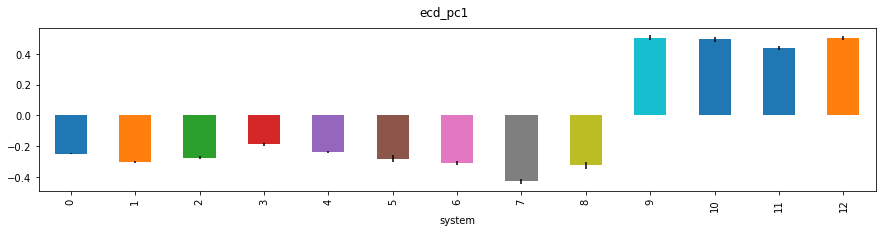

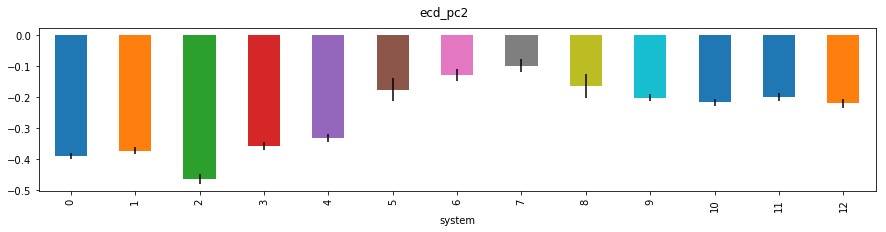

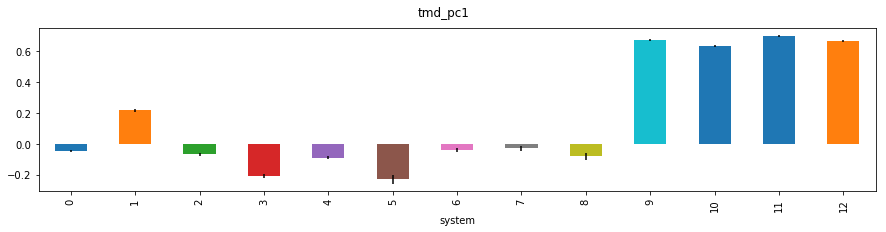

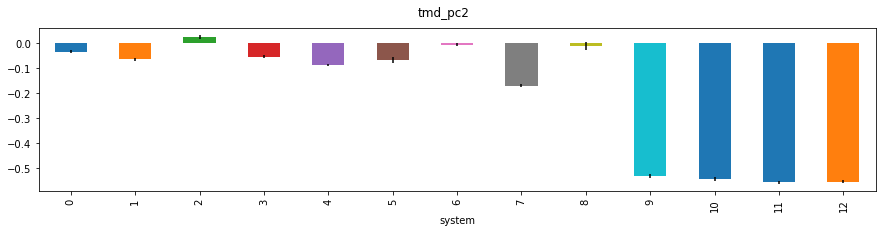

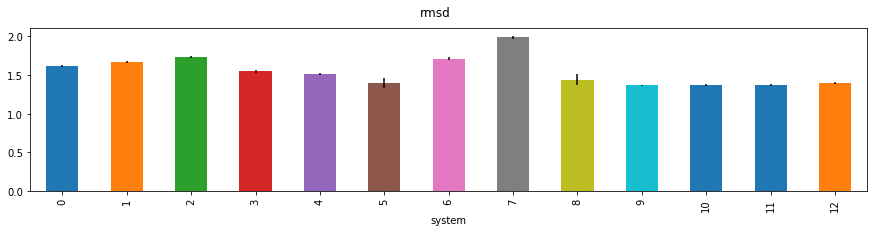

...

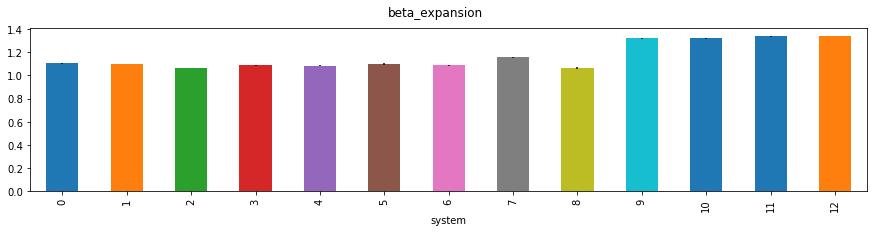

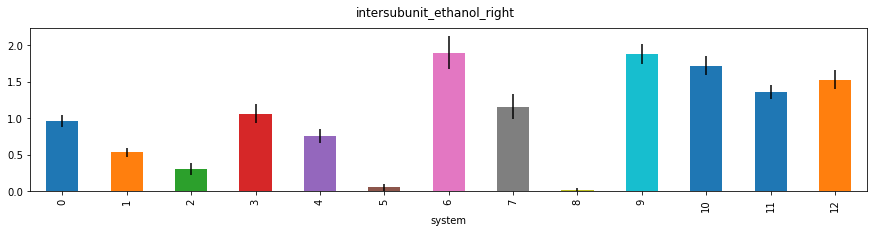

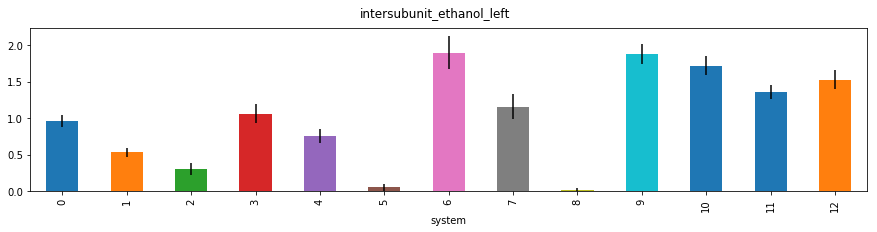

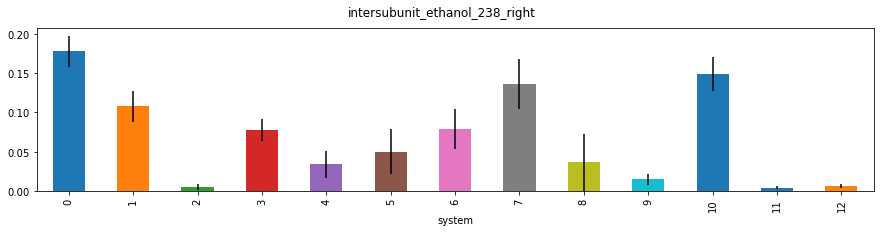

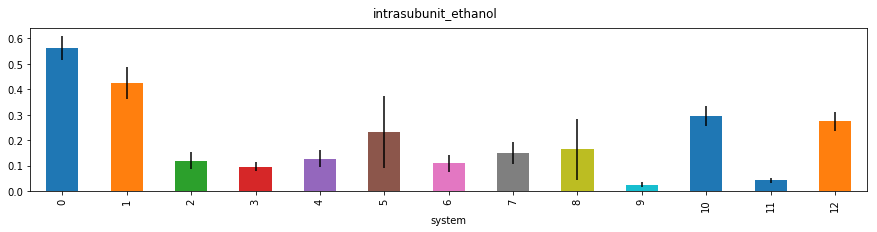

In [114]:
for feature in md_data.columns[6:]:
    fig, ax = plt.subplots(figsize=(15, 3))
#        md_data_235[md_data_235.replicate == '4'].plot(x='traj_time',y=feature,ax=ax[0],label='4',c='blue')
#        md_data_235[md_data_235.replicate == '5'].plot(x='traj_time',y=feature,ax=ax[0],label='5',c='blue')
#        md_data_235[md_data_235.replicate == '6'].plot(x='traj_time',y=feature,ax=ax[0],label='6',c='blue')
#        md_data_235[md_data_235.replicate == '7'].plot(x='traj_time',y=feature,ax=ax[0],label='7',c='red')
#        md_data_235[md_data_235.replicate == '8'].plot(x='traj_time',y=feature,ax=ax[0],label='8',c='red')
#        md_data_235[md_data_235.replicate == '9'].plot(x='traj_time',y=feature,ax=ax[0],label='9',c='red')
#        ax[0].set_xlim(0,90)
    fig.suptitle(feature)
    group = md_data.groupby(['system'],sort=False)[feature]
    mean = group.mean()
    errors = group.sem()
    mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


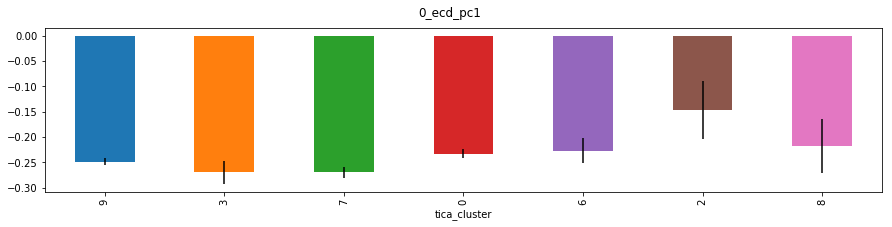

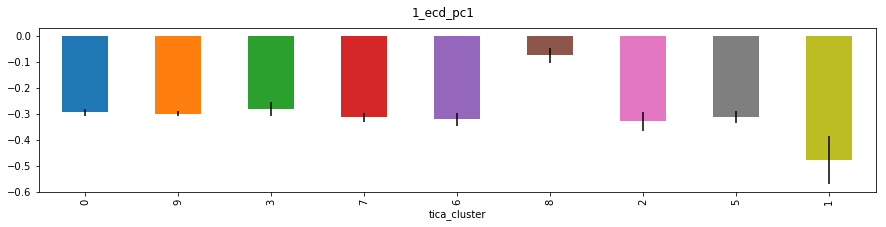

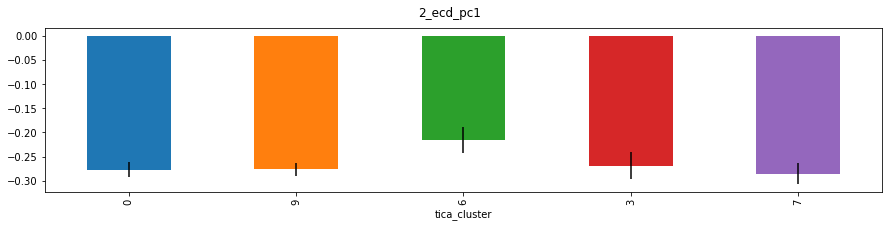

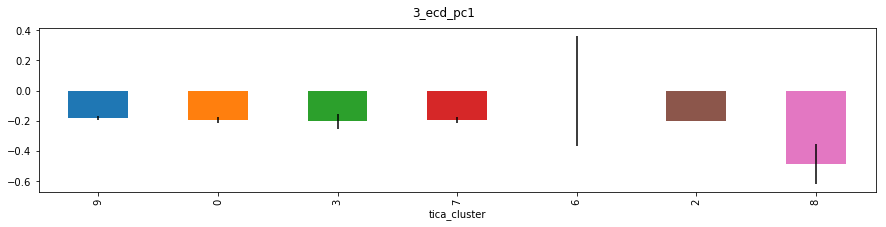

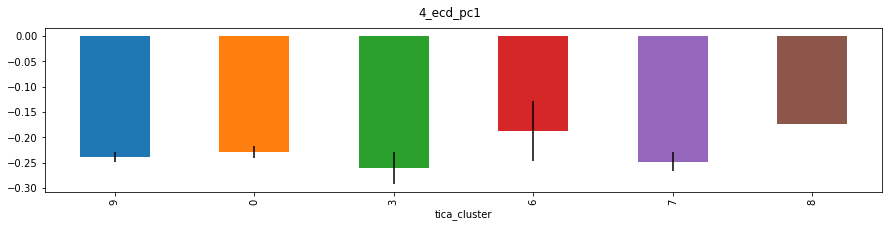

...

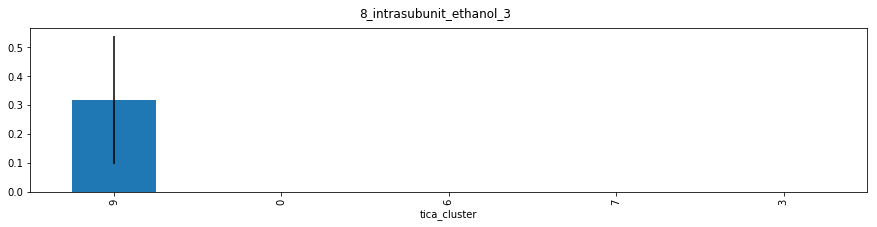

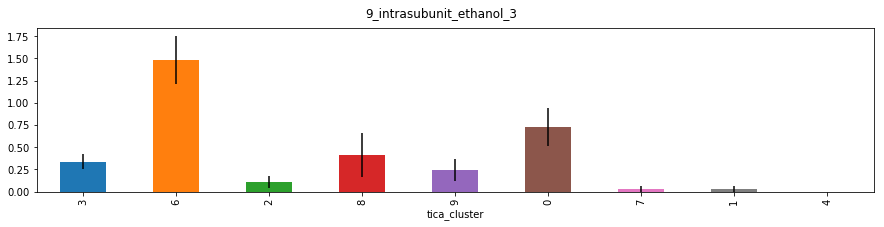

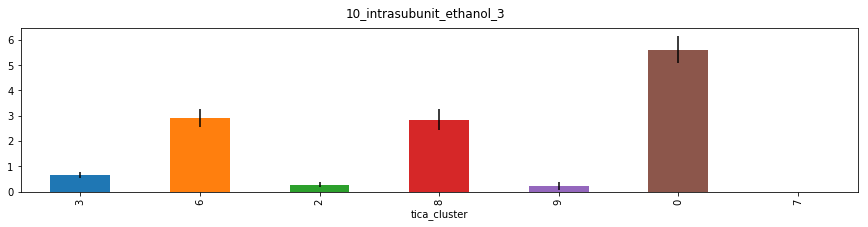

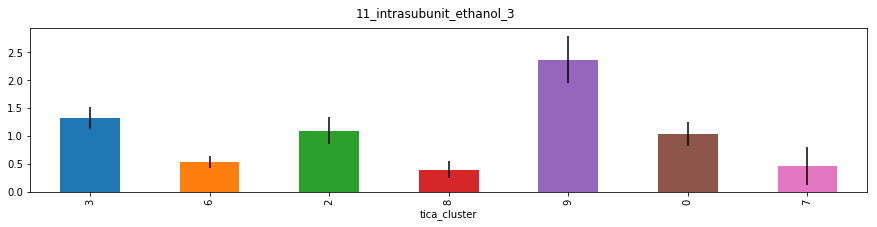

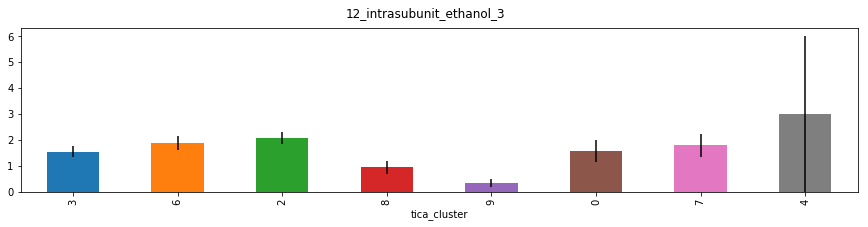

In [37]:
for feature in md_data.columns[6:]:
    for system in sorted(set(md_data.system)):

        fig, ax = plt.subplots(figsize=(15, 3))
        fig.suptitle(str(system) + '_' + feature)
        group = md_data[(md_data.system == system)].groupby(['tica_cluster'],sort=False)[feature]
        mean = group.mean()
        errors = group.sem()
        mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


In [50]:
md_data_open_close = md_data.drop(columns=['tica_cluster','intersubunit_ethanol_left','intrasubunit_ethanol','intrasubunit_ethanol_3'])

In [68]:
md_data_open_close = md_data_open_close[md_data_open_close.system.isin([0,1,3,4,9,10,11,12])]

In [86]:
md_data_open_close = md_data_open_close[md_data_open_close.traj_time > 30]

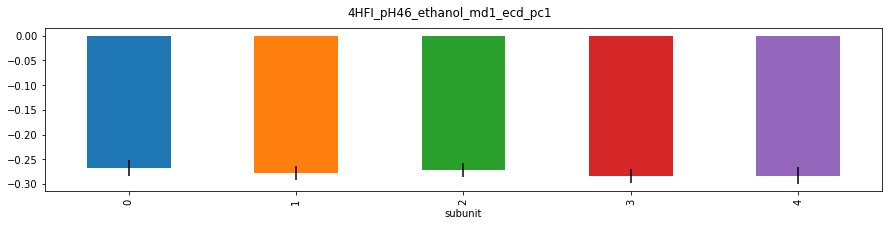

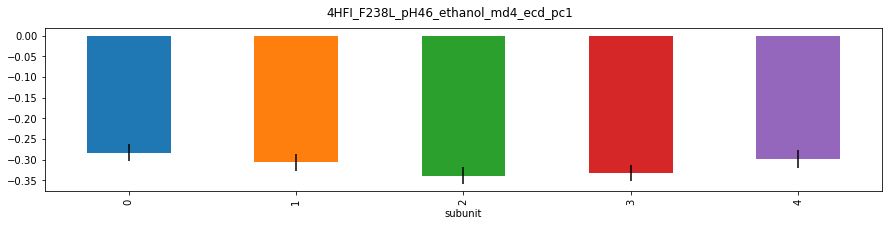

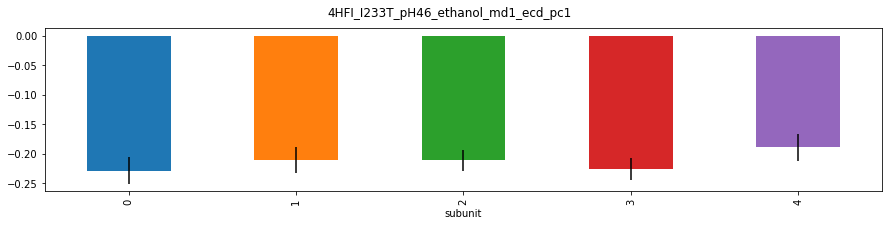

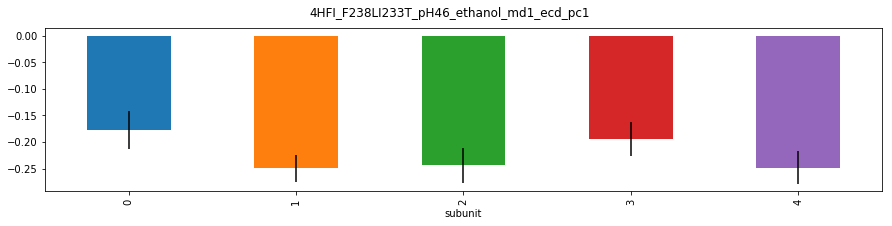

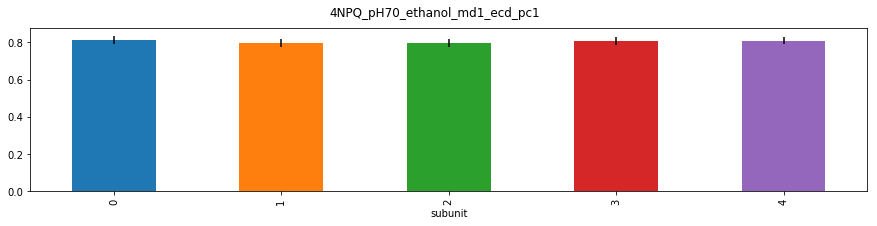

...

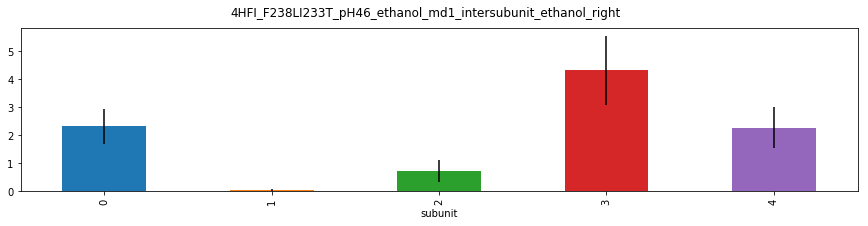

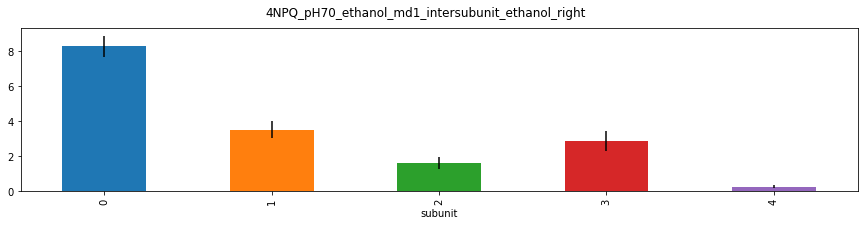

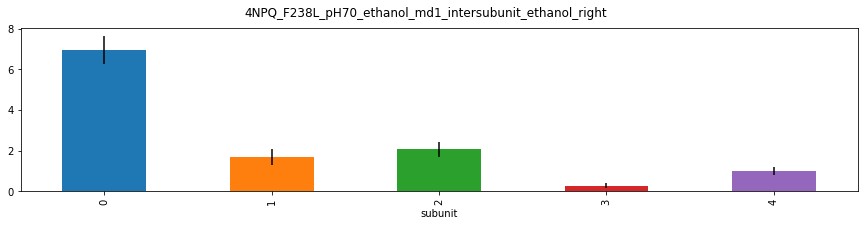

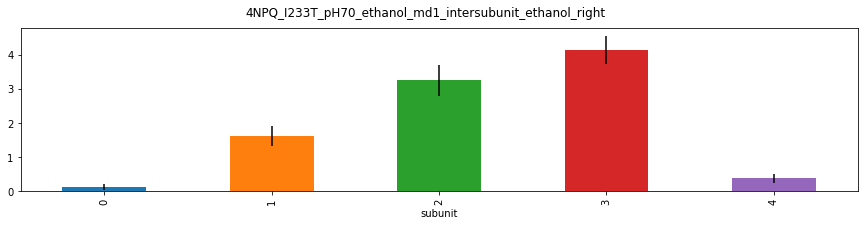

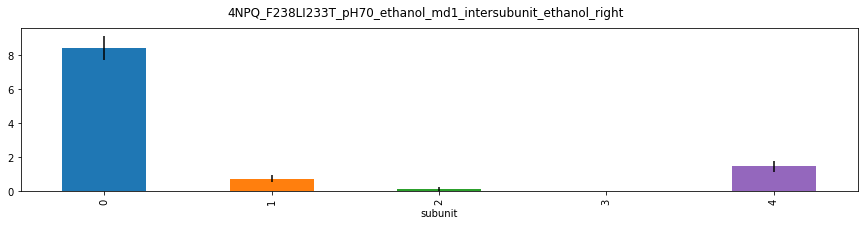

In [102]:
for feature in md_data_open_close.columns[6:-1]:
    for system in [0,1,3,4,9,10,11,12]:

        fig, ax = plt.subplots(figsize=(15, 3))
        fig.suptitle(notation_changer[system] + '_' + feature)
        group = md_data_open_close[(md_data_open_close.system == system)].groupby(['subunit'],sort=False)[feature]
        mean = group.mean()
        errors = group.sem()
        mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


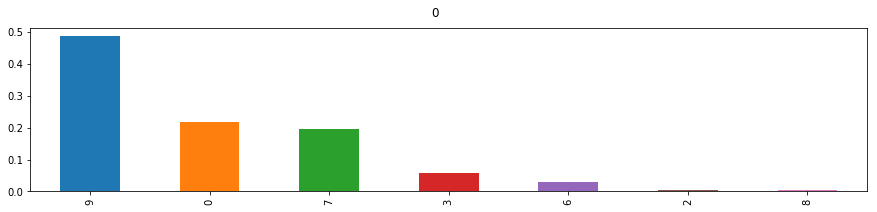

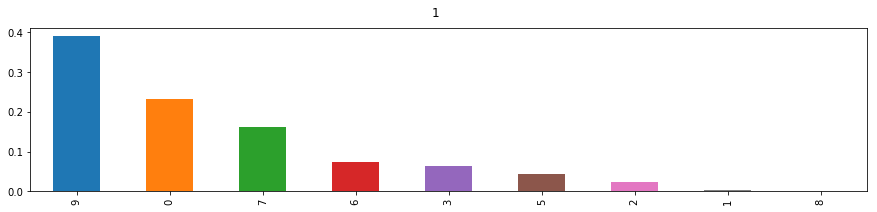

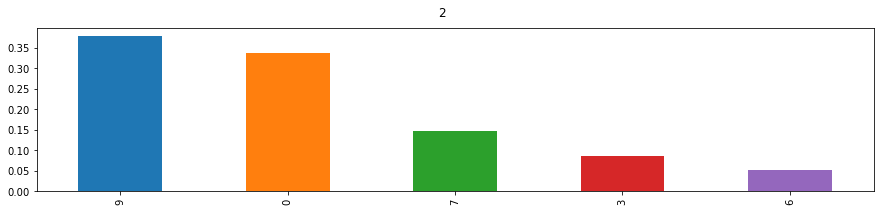

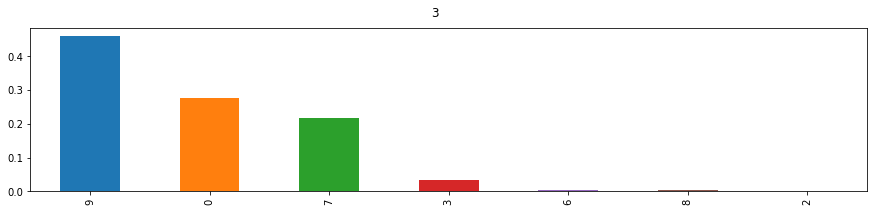

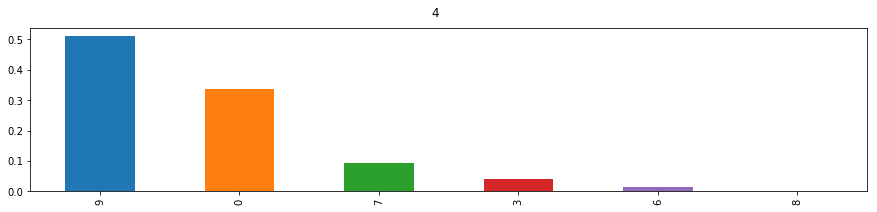

...

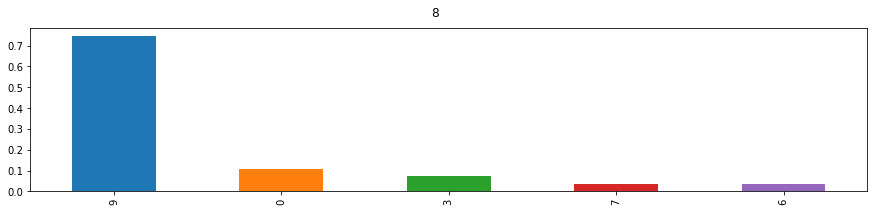

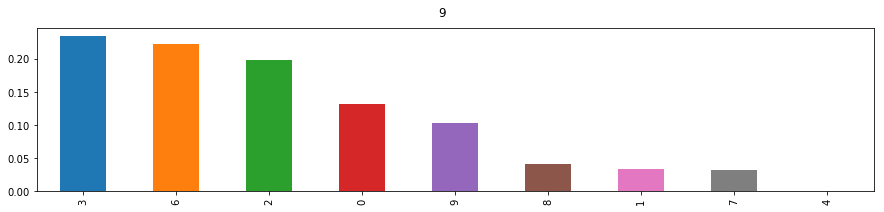

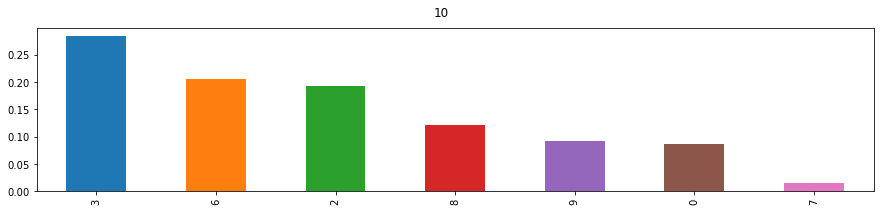

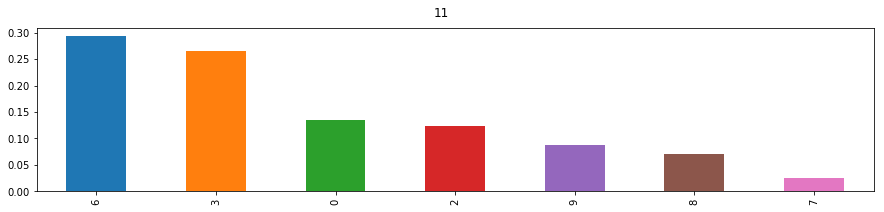

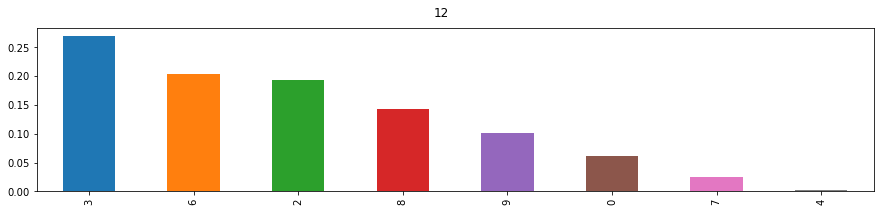

In [38]:
for system in sorted(set(md_data.system)):
    fig, ax = plt.subplots(figsize=(15, 3))
    fig.suptitle(str(system))
    group = md_data[(md_data.system == system)]['tica_cluster']
    mean = group.value_counts(normalize=True)
#    errors = group.sem()
    mean.plot.bar(ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


In [109]:
md_data['scaled_M1M2_dist'] = (md_data['M1(n)_M2(n+1)_distance']-md_data['M1(n)_M2(n+1)_distance'].min())/md_data['M1(n)_M2(n+1)_distance'].max()*10

0
4HFI_pH46_ethanol_md1


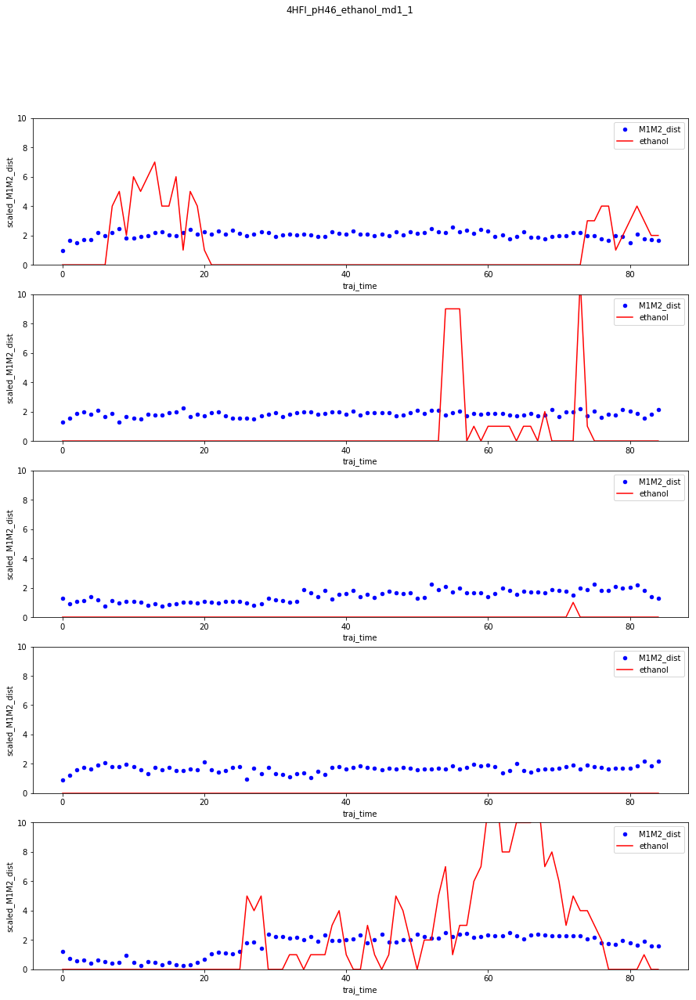

4HFI_pH46_ethanol_md1


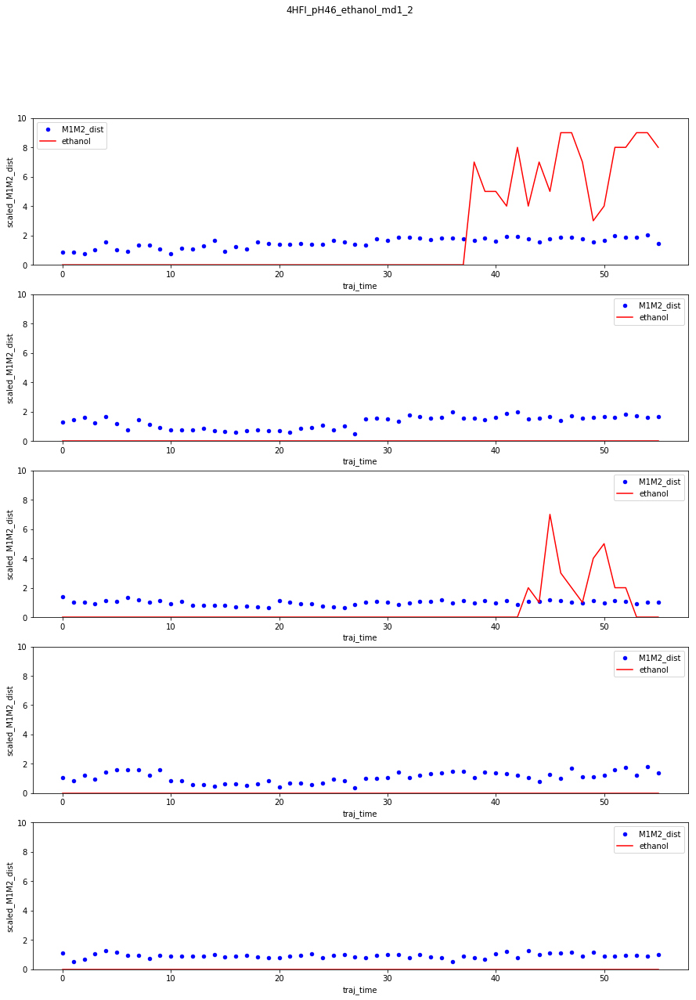

4HFI_pH46_ethanol_md1


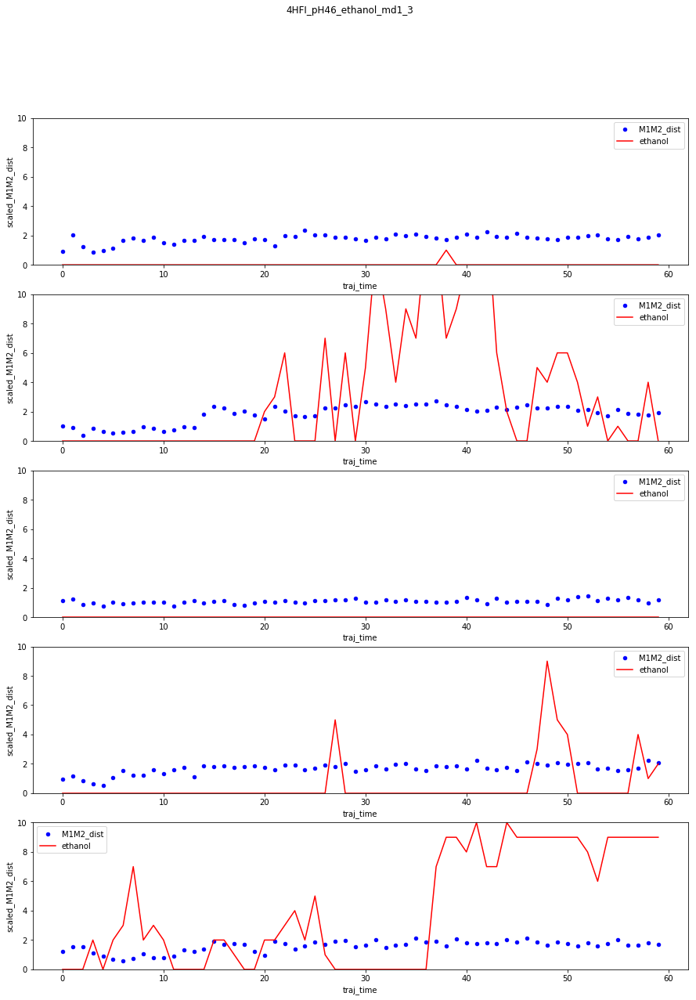

1
4HFI_F238L_pH46_ethanol_md4


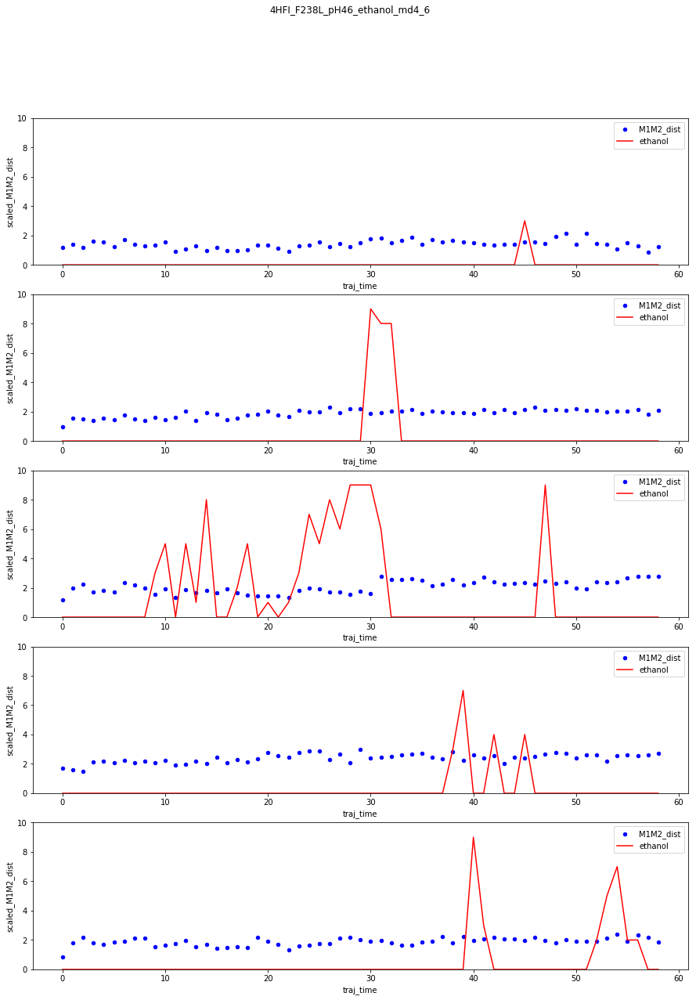

4HFI_F238L_pH46_ethanol_md4


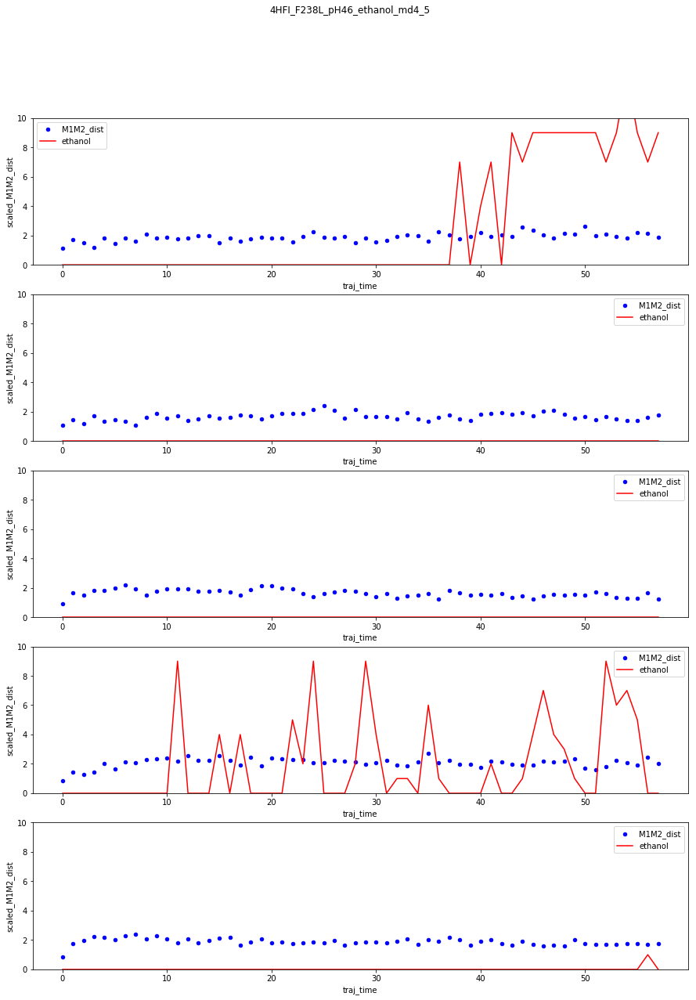

4HFI_F238L_pH46_ethanol_md4


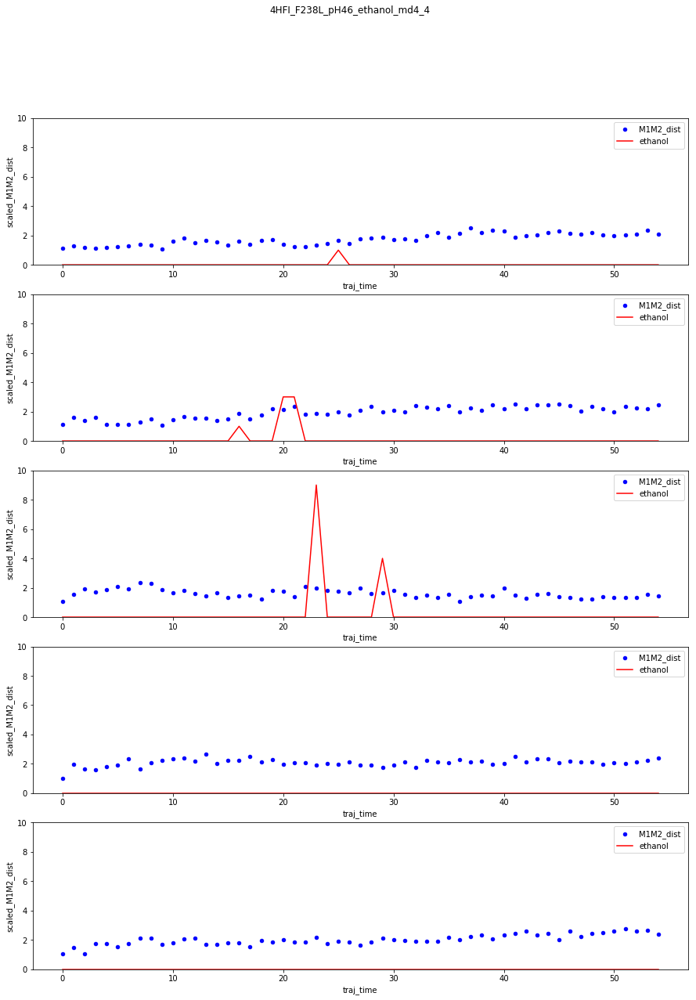

3
4HFI_I233T_pH46_ethanol_md1


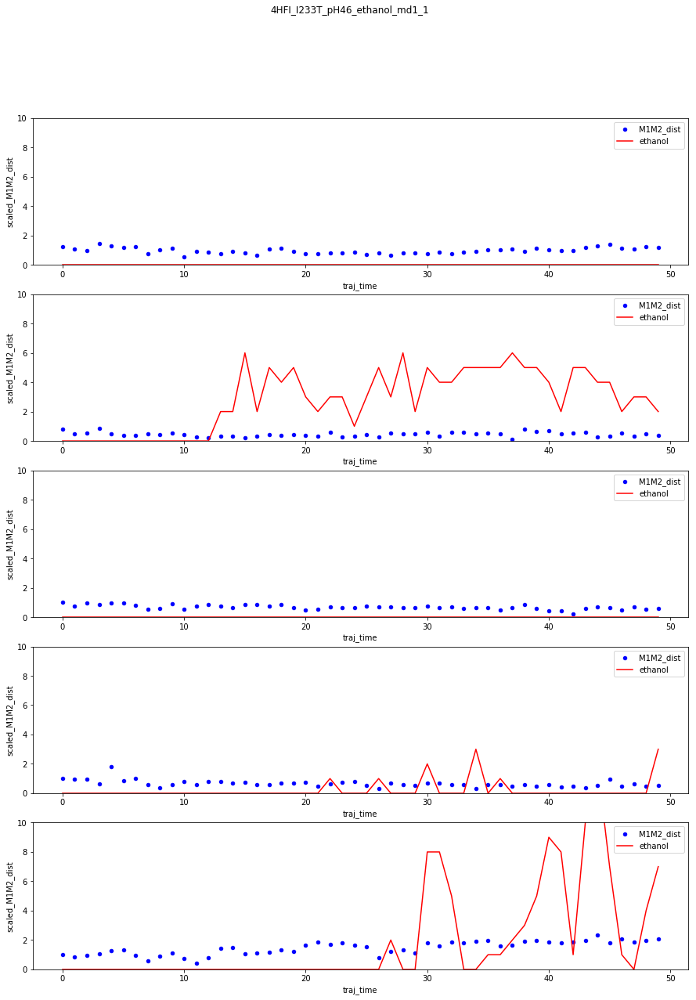

4HFI_I233T_pH46_ethanol_md1


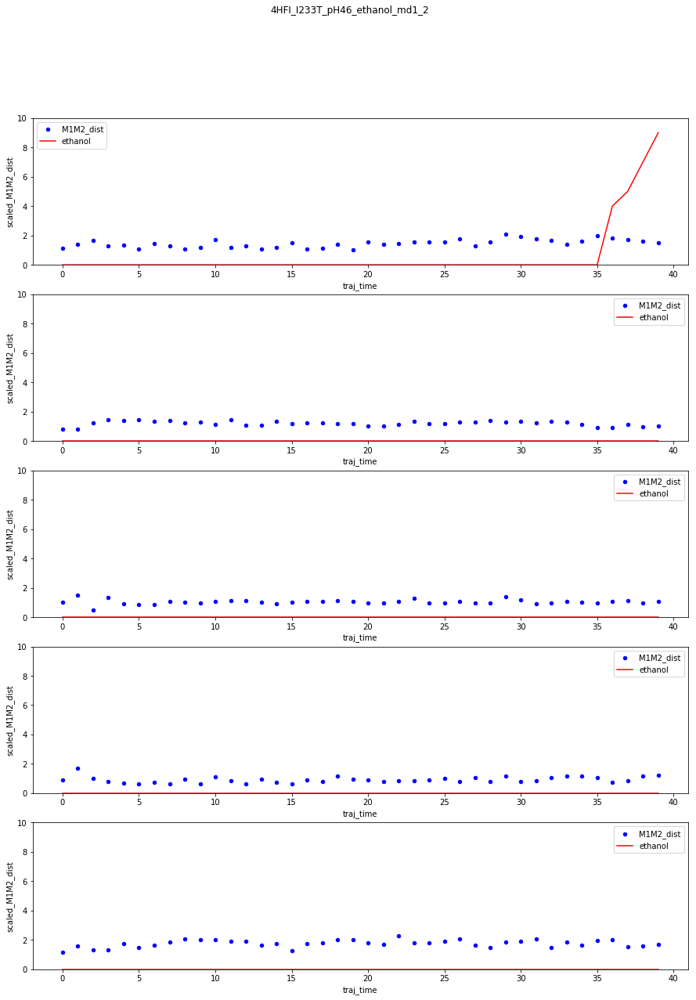

4HFI_I233T_pH46_ethanol_md1


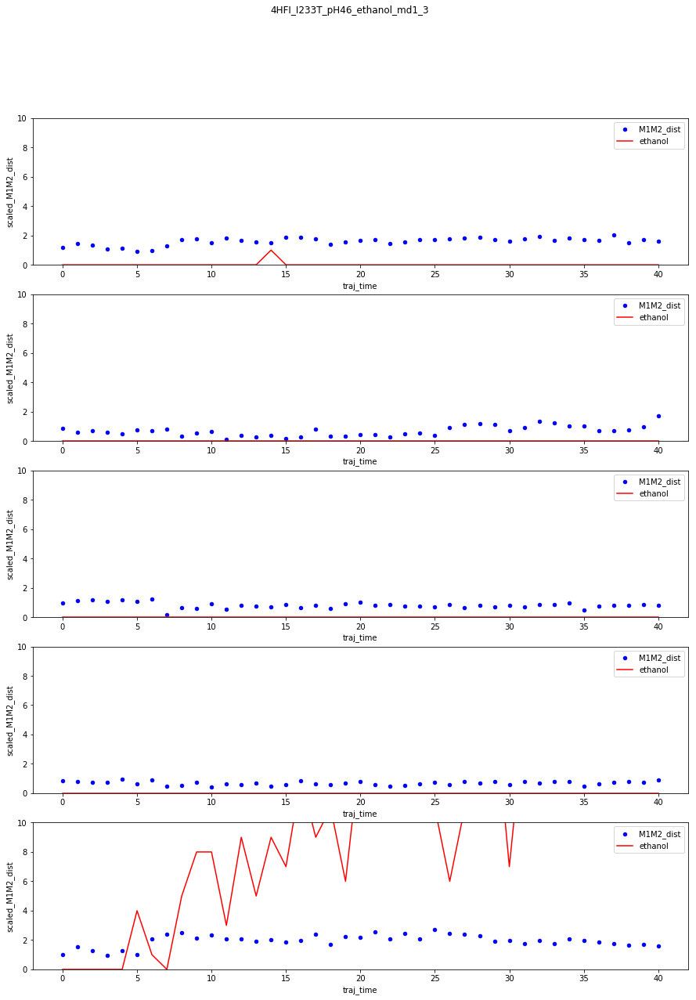

4
4HFI_F238LI233T_pH46_ethanol_md1


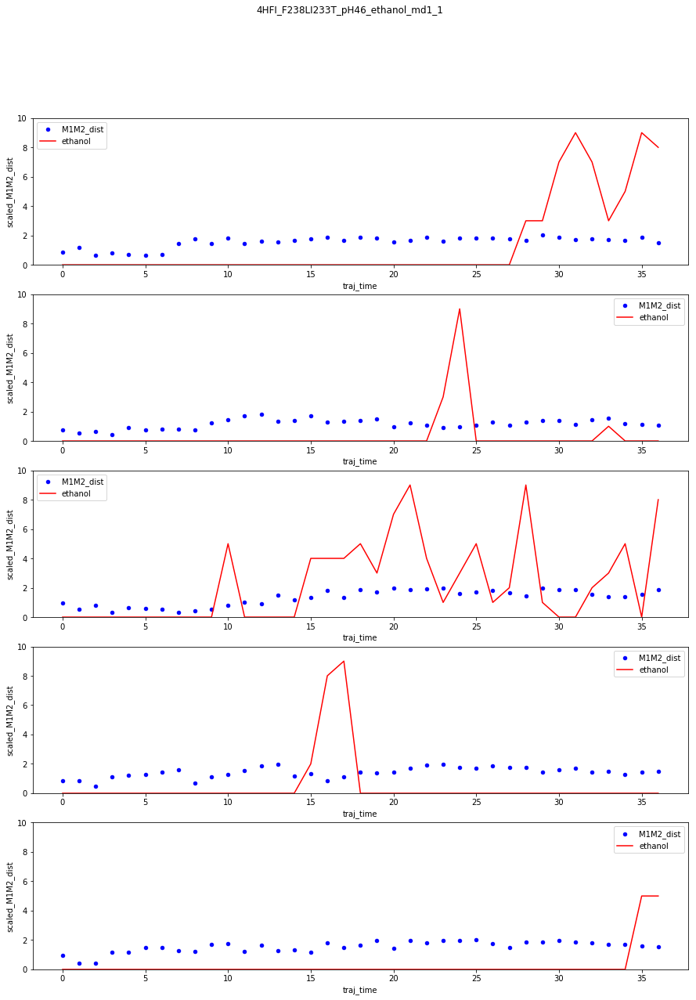

4HFI_F238LI233T_pH46_ethanol_md1


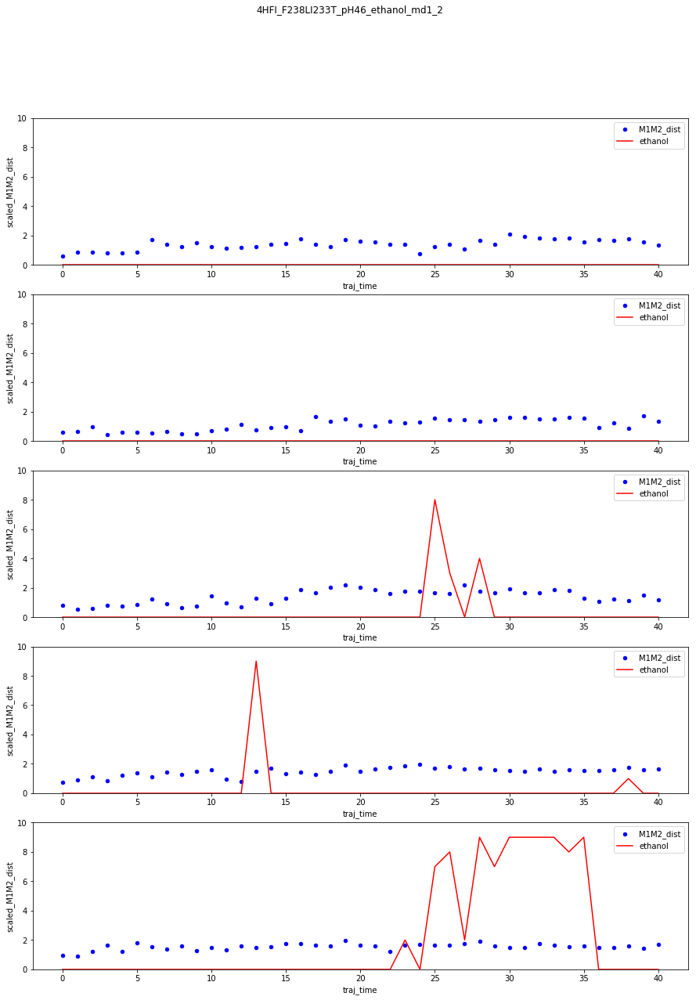

4HFI_F238LI233T_pH46_ethanol_md1


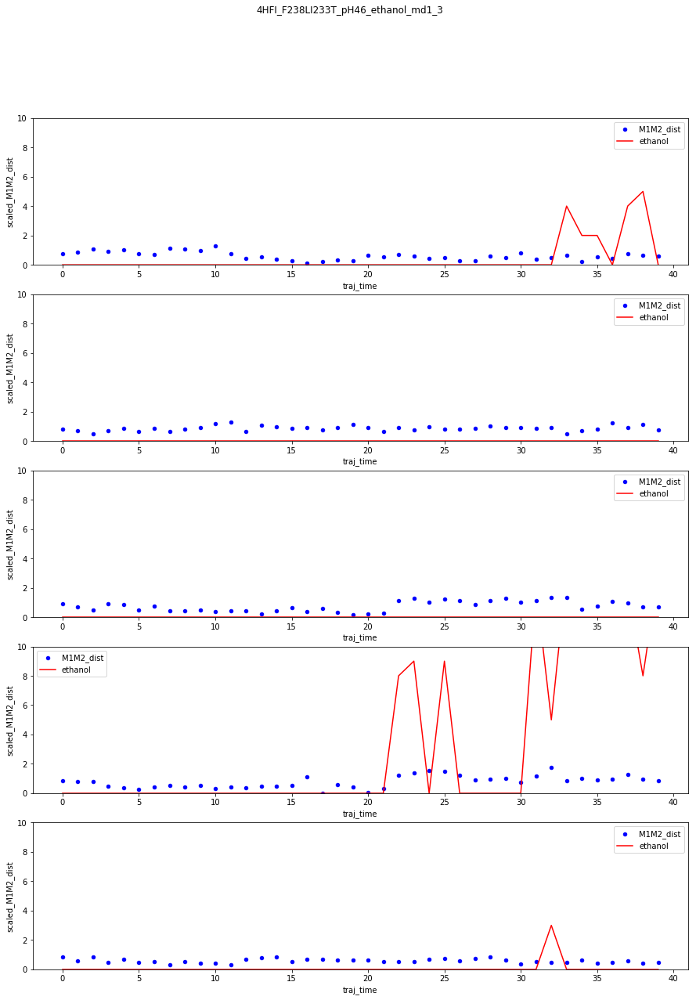

9
4NPQ_pH70_ethanol_md1


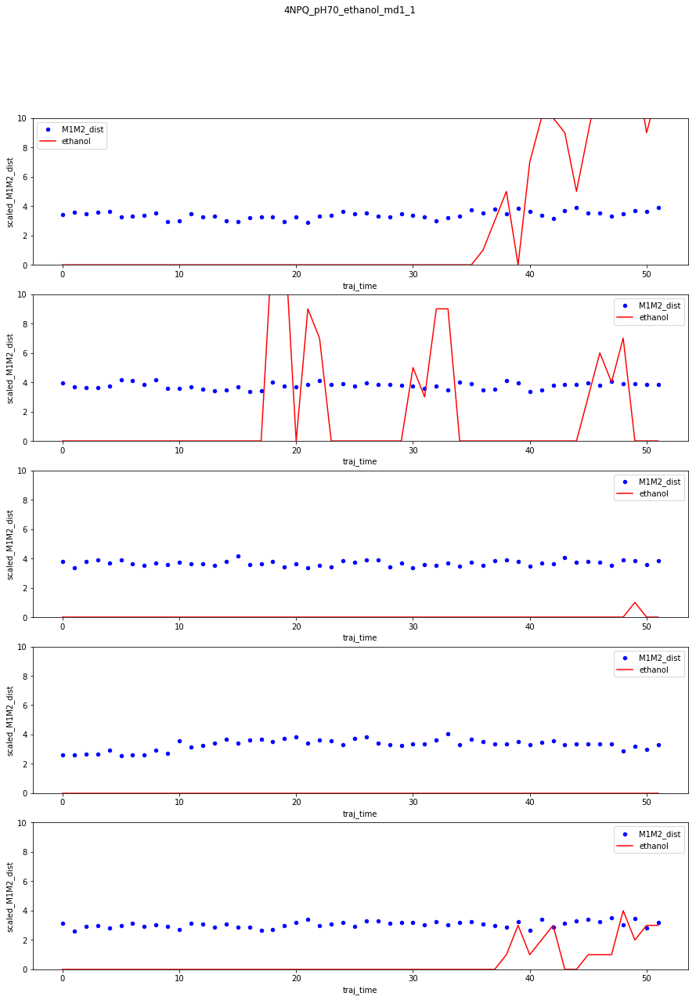

4NPQ_pH70_ethanol_md1


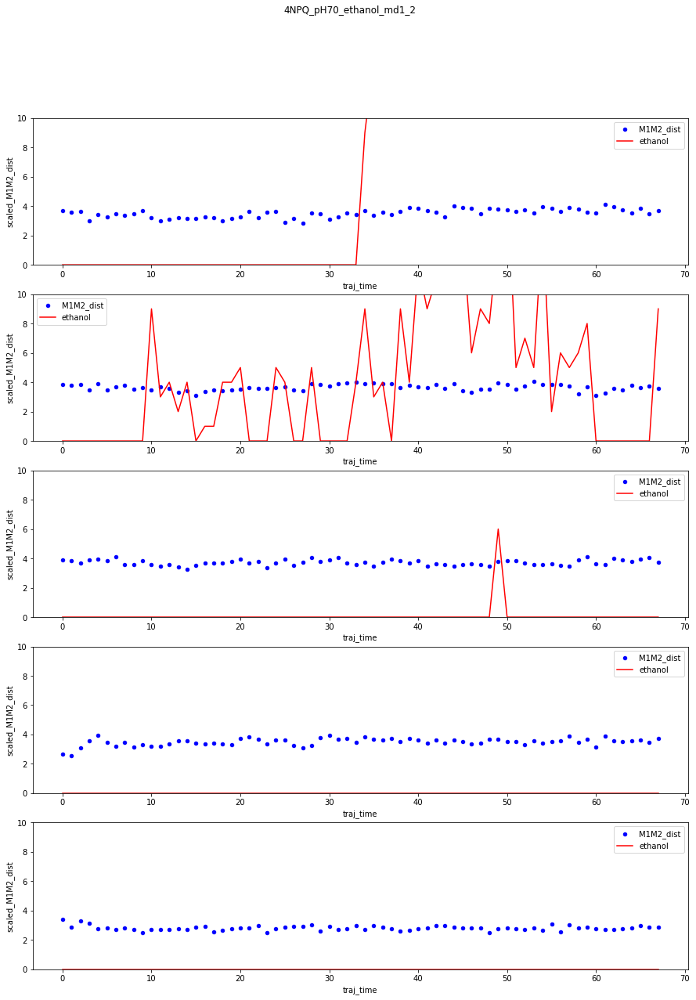

4NPQ_pH70_ethanol_md1


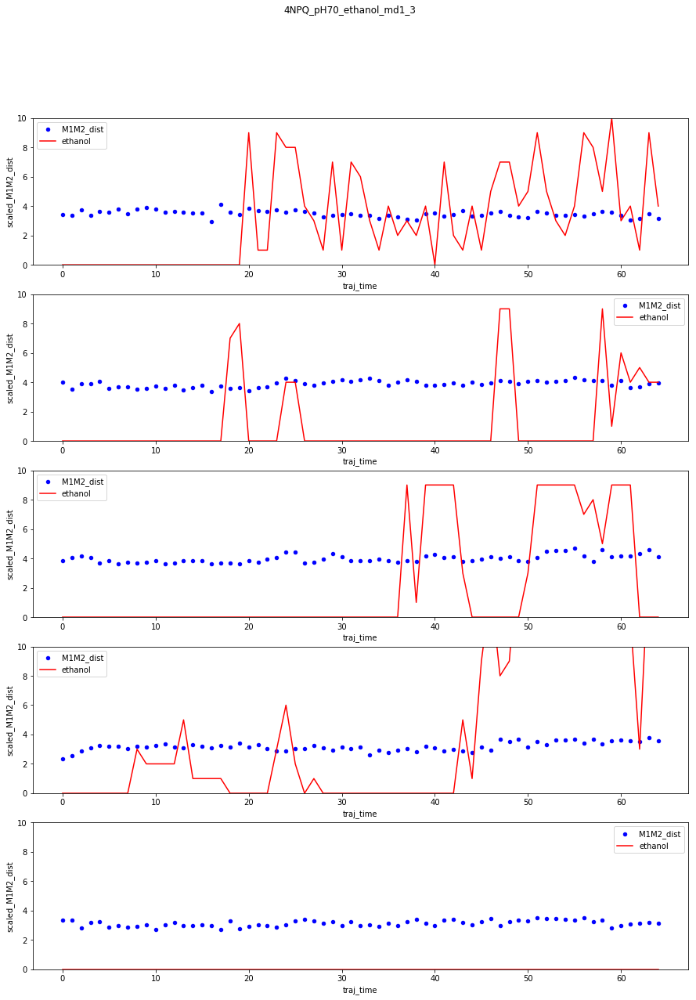

10
4NPQ_F238L_pH70_ethanol_md1


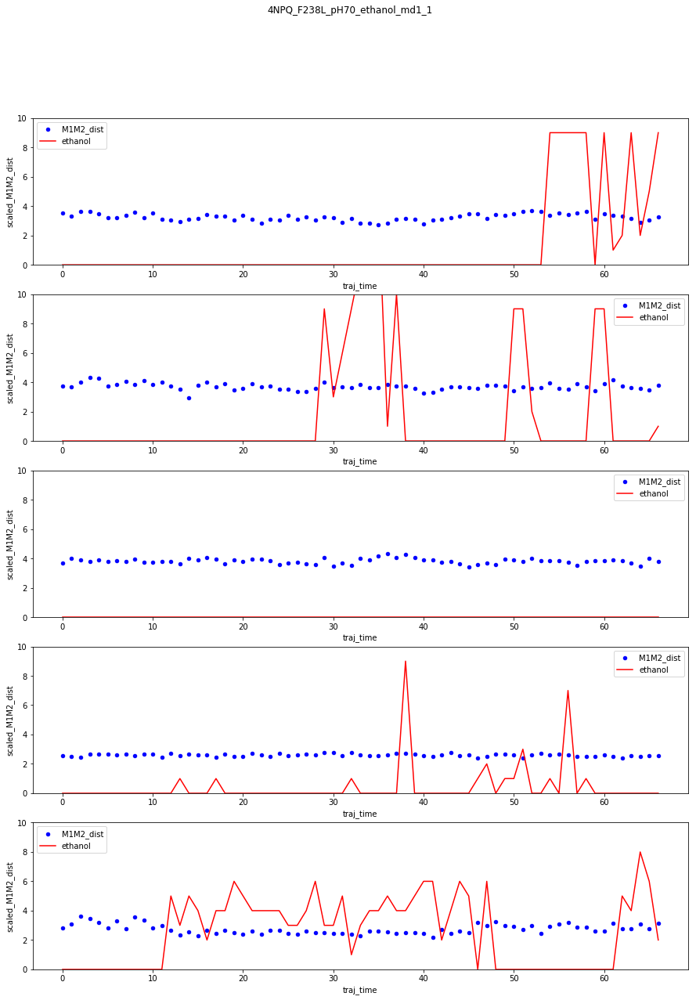

4NPQ_F238L_pH70_ethanol_md1


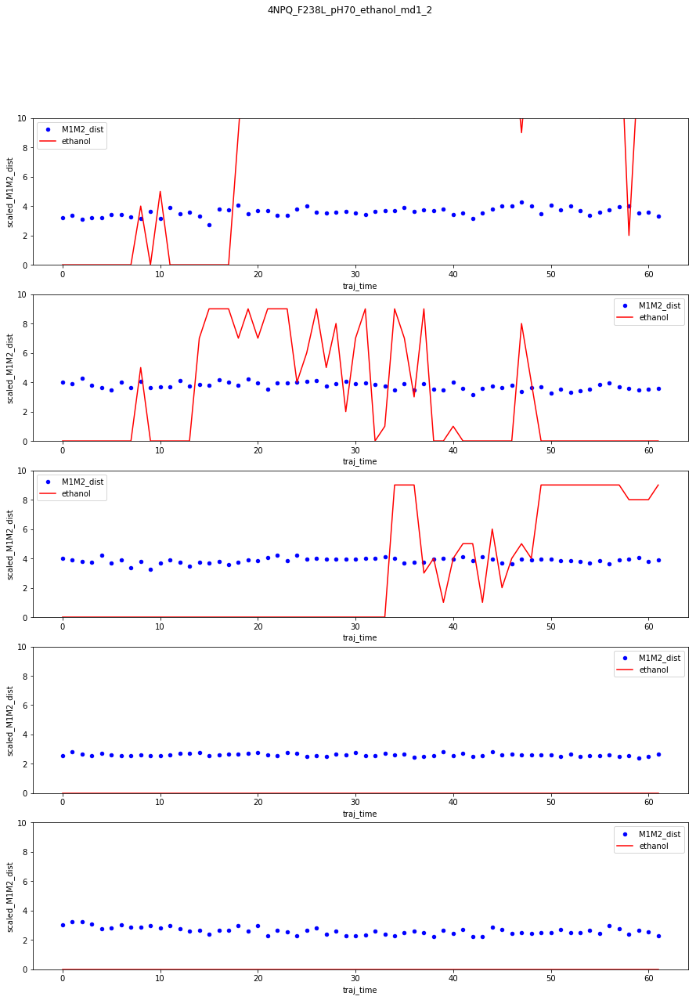

4NPQ_F238L_pH70_ethanol_md1


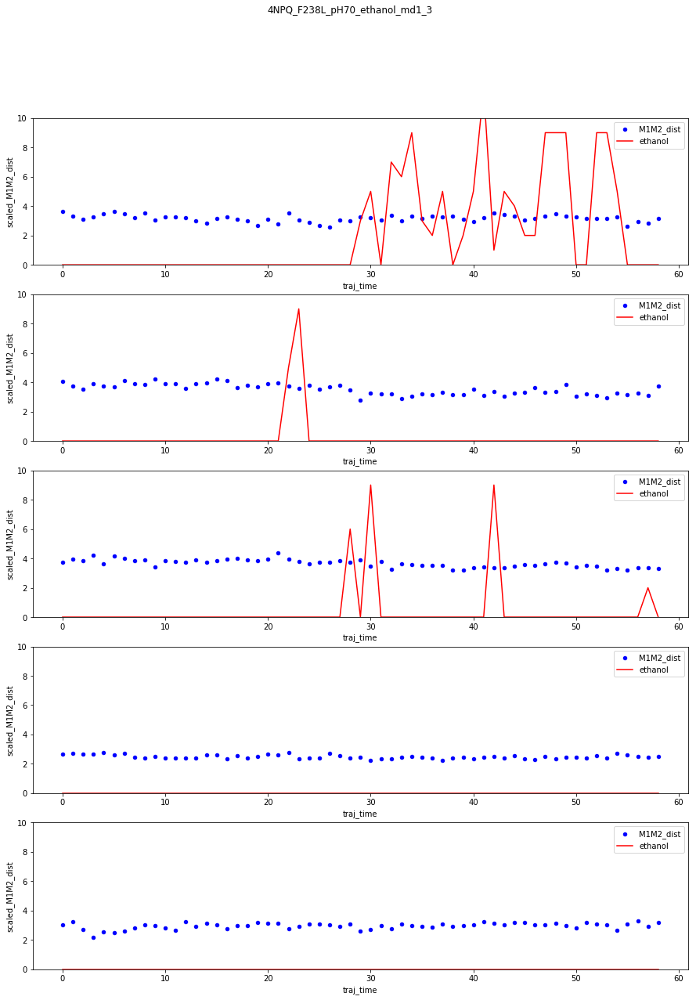

11
4NPQ_I233T_pH70_ethanol_md1


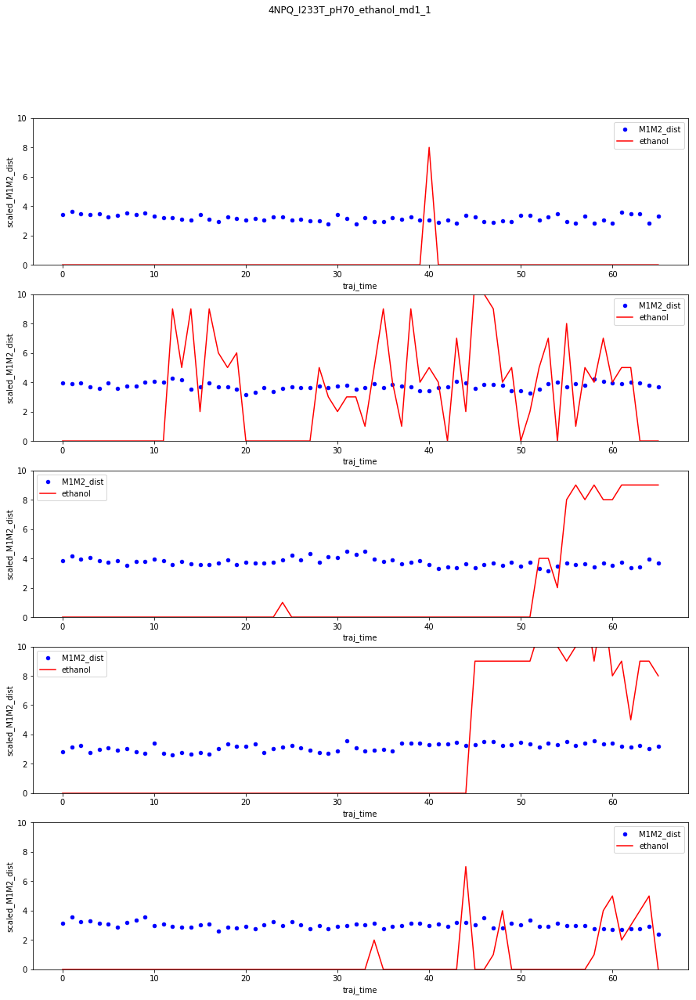

4NPQ_I233T_pH70_ethanol_md1


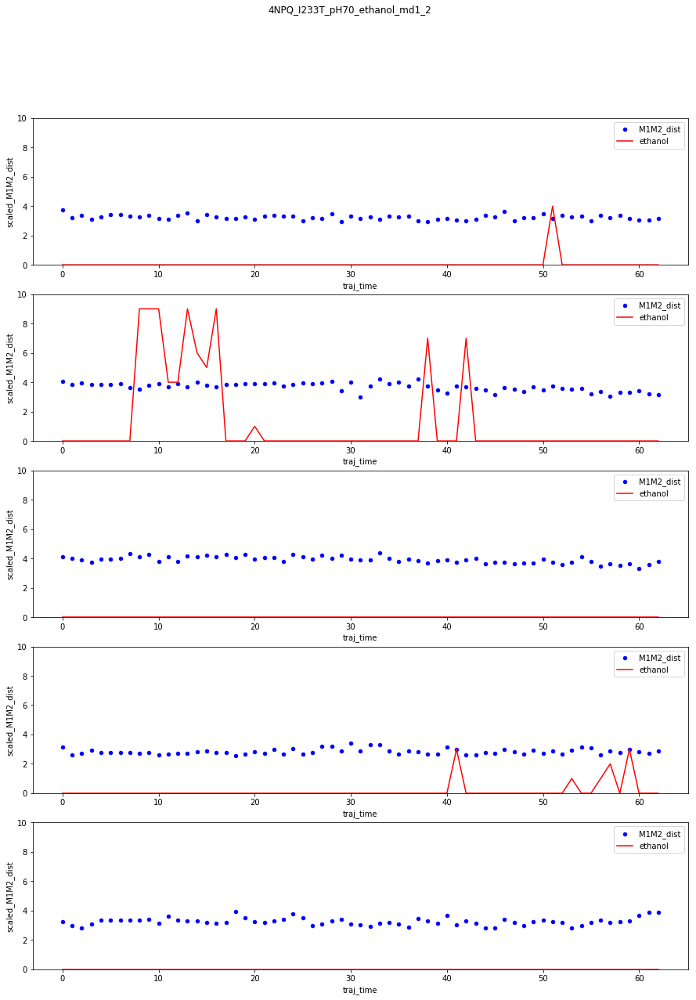

4NPQ_I233T_pH70_ethanol_md1


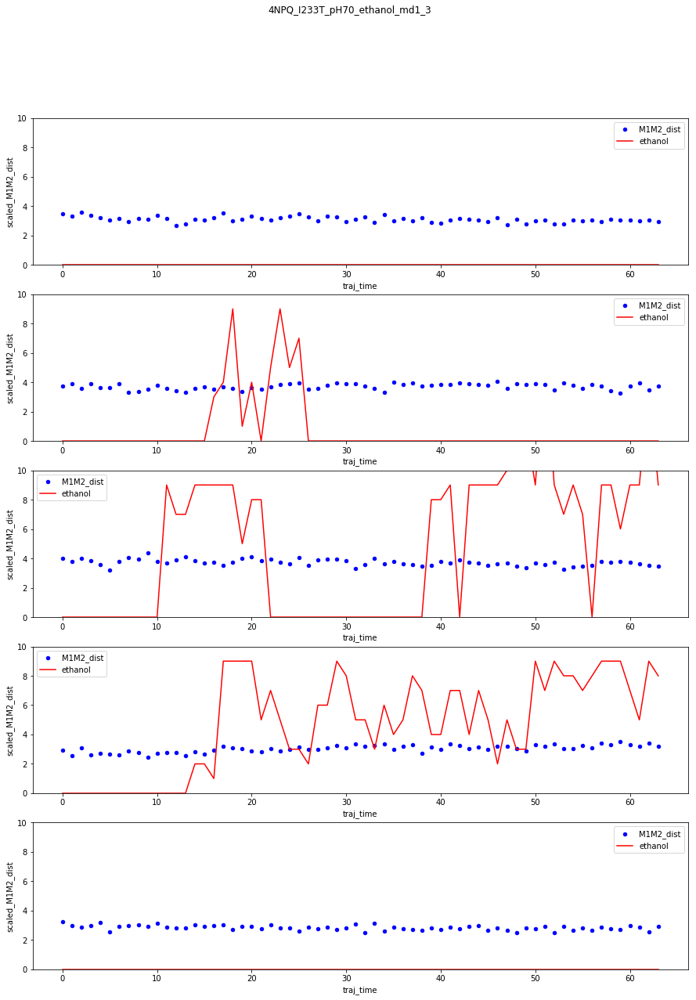

12
4NPQ_F238LI233T_pH70_ethanol_md1


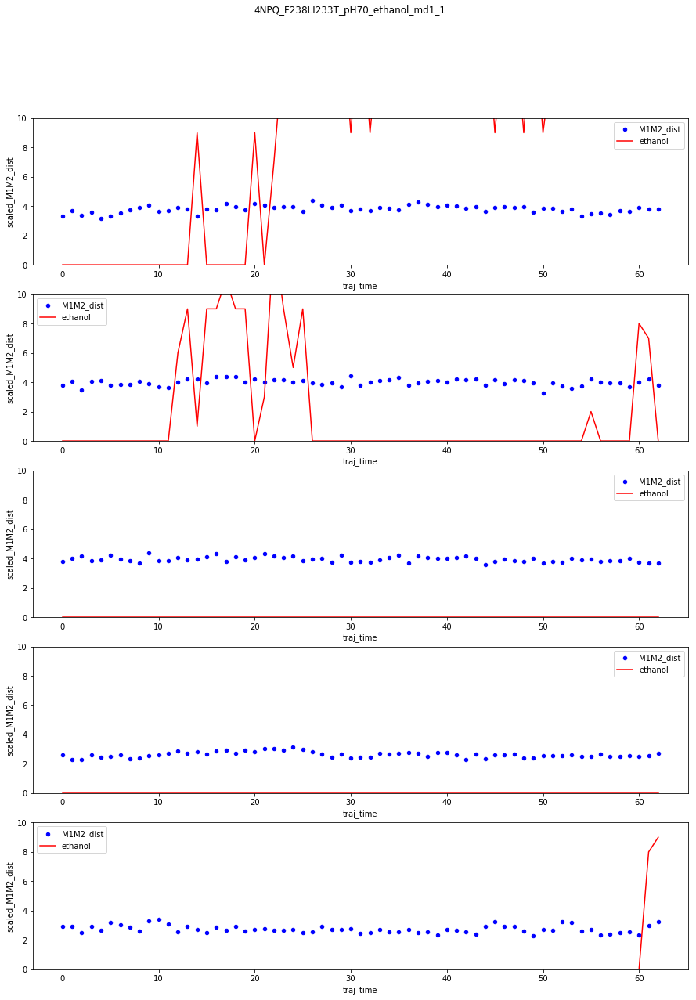

4NPQ_F238LI233T_pH70_ethanol_md1


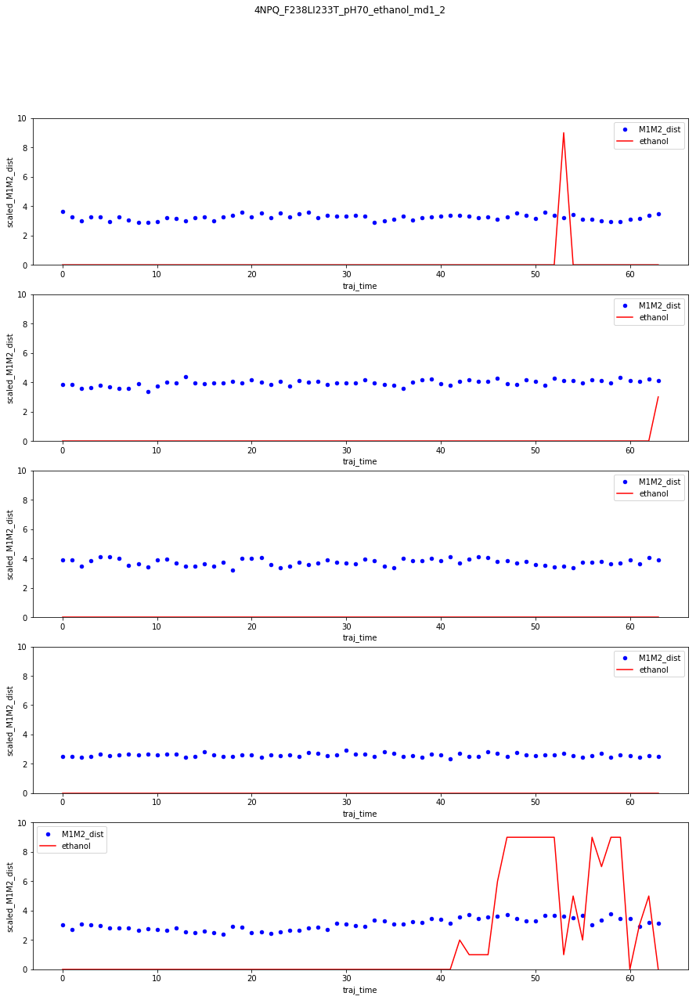

4NPQ_F238LI233T_pH70_ethanol_md1


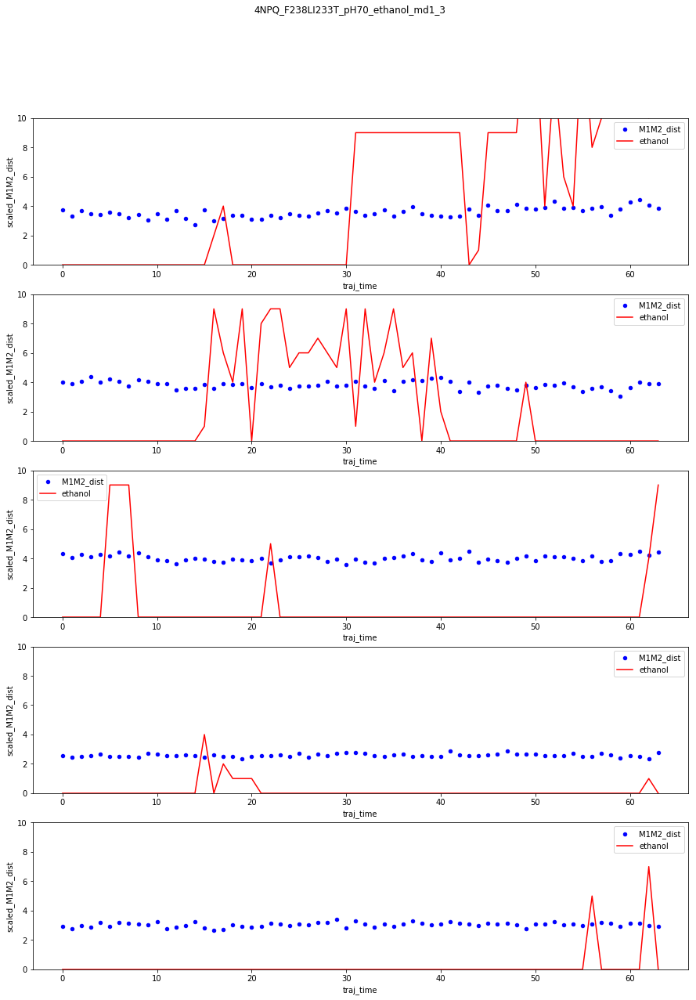

In [110]:
for system in [0,1,3,4,9,10,11,12]:
    print(system)
    for replicate in set(md_data[(md_data.system == system)]['replicate']):
        print(notation_changer[system])
        fig, ax = plt.subplots(5,figsize=(15, 20))
        md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 0)].plot(kind='scatter',x='traj_time',y='scaled_M1M2_dist',ax=ax[0],label='M1M2_dist',c='blue')
        md_data[(md_data.system == system) & (md_data.replicate == replicate)  & (md_data.subunit == 0)].plot(x='traj_time',y='intersubunit_ethanol_right',ax=ax[0],label='ethanol',c='red')
        md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 1)].plot(kind='scatter',x='traj_time',y='scaled_M1M2_dist',ax=ax[1],label='M1M2_dist',c='blue')
        md_data[(md_data.system == system) & (md_data.replicate == replicate)  & (md_data.subunit == 1)].plot(x='traj_time',y='intersubunit_ethanol_right',ax=ax[1],label='ethanol',c='red')
        md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 2)].plot(kind='scatter',x='traj_time',y='scaled_M1M2_dist',ax=ax[2],label='M1M2_dist',c='blue')
        md_data[(md_data.system == system) & (md_data.replicate == replicate)  & (md_data.subunit == 2)].plot(x='traj_time',y='intersubunit_ethanol_right',ax=ax[2],label='ethanol',c='red')
        md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 3)].plot(kind='scatter',x='traj_time',y='scaled_M1M2_dist',ax=ax[3],label='M1M2_dist',c='blue')
        md_data[(md_data.system == system) & (md_data.replicate == replicate)  & (md_data.subunit == 3)].plot(x='traj_time',y='intersubunit_ethanol_right',ax=ax[3],label='ethanol',c='red')
        md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 4)].plot(kind='scatter',x='traj_time',y='scaled_M1M2_dist',ax=ax[4],label='M1M2_dist',c='blue')
        md_data[(md_data.system == system) & (md_data.replicate == replicate)  & (md_data.subunit == 4)].plot(x='traj_time',y='intersubunit_ethanol_right',ax=ax[4],label='ethanol',c='red')
        ax[0].set_ylim(0,10)
        ax[1].set_ylim(0,10)
        ax[2].set_ylim(0,10)
        ax[3].set_ylim(0,10)
        ax[4].set_ylim(0,10)
        plt.suptitle(notation_changer[system] + '_' + replicate)
        plt.show()

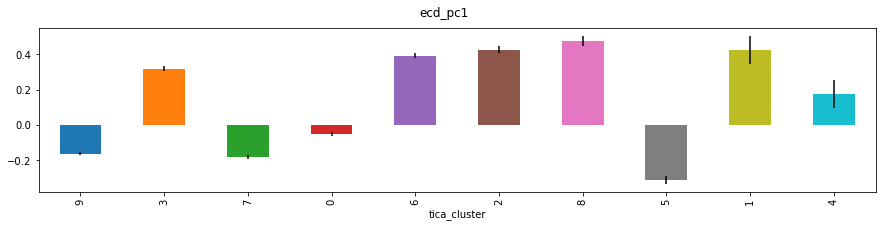

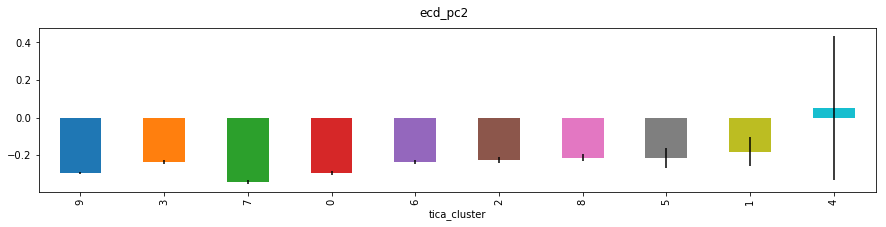

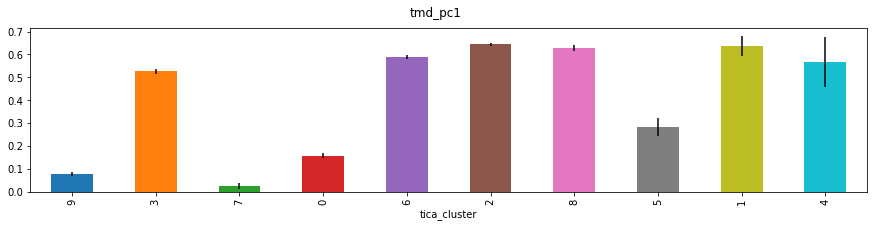

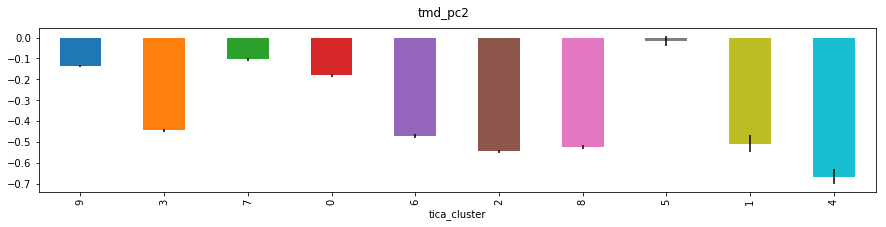

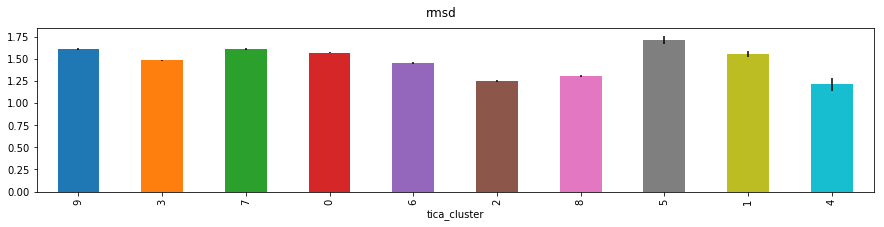

...

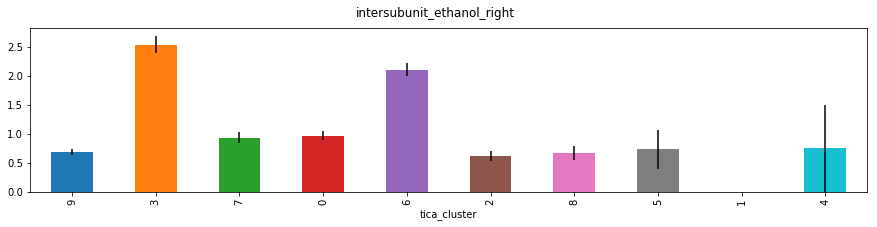

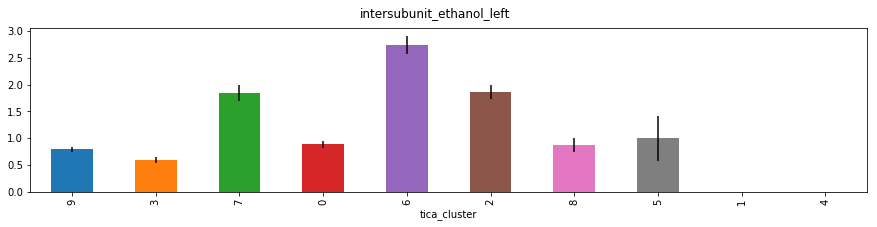

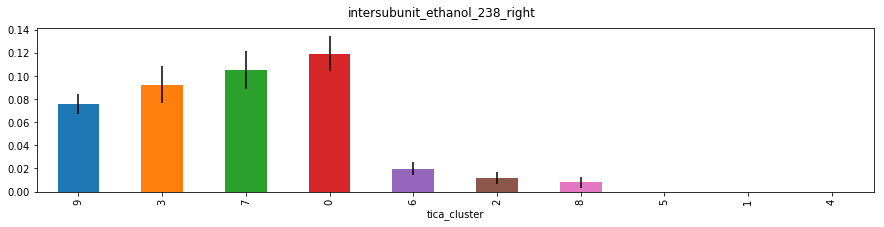

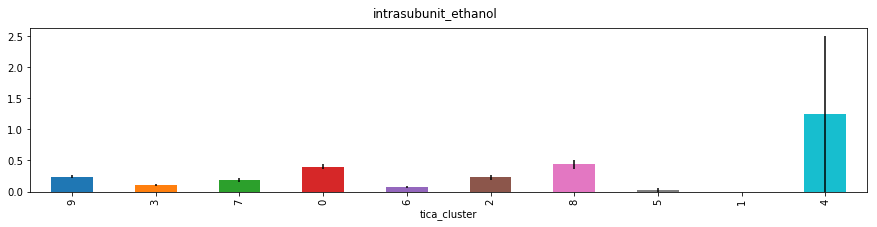

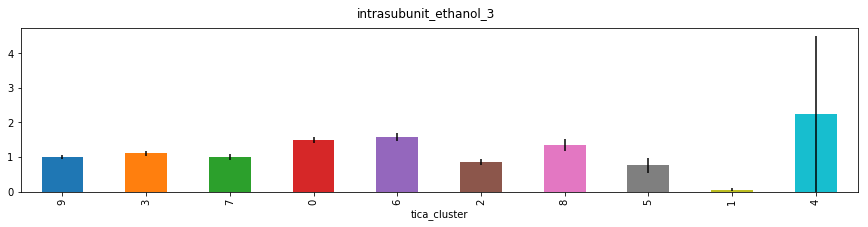

In [39]:
for feature in md_data.columns[6:]:

    fig, ax = plt.subplots(figsize=(15, 3))
    fig.suptitle(feature)
    group = md_data.groupby(['tica_cluster'],sort=False)[feature]
    mean = group.mean()
    errors = group.sem()
    mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


In [87]:
md_data_open_close.corr()['intersubunit_ethanol_right']

traj_time                         0.087169
system                            0.112062
ecd_pc1                           0.115800
ecd_pc2                           0.030322
tmd_pc1                           0.053325
tmd_pc2                          -0.107200
rmsd                             -0.024580
helix tilt angle                  0.168382
helix twist angle                -0.006786
M1(n)_M2(n+1)_distance            0.218413
M1_kink                          -0.034447
M2_kink                          -0.050131
beta_expansion                    0.073646
intersubunit_ethanol_right        1.000000
intersubunit_ethanol_238_right   -0.049800
Name: intersubunit_ethanol_right, dtype: float64

In [100]:
md_data_open_close[(md_data_open_close.system == 9) & (md_data_open_close.subunit == 0)].corr()['intersubunit_ethanol_right']

traj_time                         0.394704
system                                 NaN
ecd_pc1                          -0.328543
ecd_pc2                           0.052121
tmd_pc1                          -0.151414
tmd_pc2                           0.184840
rmsd                             -0.386104
helix tilt angle                 -0.348729
helix twist angle                 0.181577
M1(n)_M2(n+1)_distance            0.500631
M1_kink                          -0.311704
M2_kink                          -0.276213
beta_expansion                    0.538611
intersubunit_ethanol_right        1.000000
intersubunit_ethanol_238_right    0.192847
Name: intersubunit_ethanol_right, dtype: float64

In [89]:
md_data_open_close[(md_data_open_close.system == 10) & (md_data_open_close.subunit == 0)].corr()['intersubunit_ethanol_right']

traj_time                         0.052301
system                                 NaN
ecd_pc1                           0.006691
ecd_pc2                          -0.193311
tmd_pc1                           0.156692
tmd_pc2                          -0.411536
rmsd                              0.256543
helix tilt angle                  0.039896
helix twist angle                -0.290775
M1(n)_M2(n+1)_distance            0.633418
M1_kink                          -0.040646
M2_kink                           0.099837
beta_expansion                    0.345374
intersubunit_ethanol_right        1.000000
intersubunit_ethanol_238_right   -0.390923
Name: intersubunit_ethanol_right, dtype: float64

In [98]:
md_data_open_close[(md_data_open_close.system == 11) & (md_data_open_close.subunit == 3)].corr()['intersubunit_ethanol_right']

traj_time                         0.477165
system                                 NaN
ecd_pc1                          -0.271450
ecd_pc2                          -0.165311
tmd_pc1                          -0.051397
tmd_pc2                          -0.079663
rmsd                              0.146687
helix tilt angle                 -0.144942
helix twist angle                -0.494877
M1(n)_M2(n+1)_distance            0.560591
M1_kink                           0.092827
M2_kink                          -0.227755
beta_expansion                   -0.461964
intersubunit_ethanol_right        1.000000
intersubunit_ethanol_238_right         NaN
Name: intersubunit_ethanol_right, dtype: float64

In [101]:
md_data_open_close[(md_data_open_close.system == 12) & (md_data_open_close.subunit == 0)].corr()['intersubunit_ethanol_right']

traj_time                         0.087613
system                                 NaN
ecd_pc1                          -0.195331
ecd_pc2                           0.024727
tmd_pc1                           0.043531
tmd_pc2                          -0.030304
rmsd                             -0.227814
helix tilt angle                 -0.299623
helix twist angle                 0.280021
M1(n)_M2(n+1)_distance            0.638957
M1_kink                           0.068697
M2_kink                           0.469256
beta_expansion                    0.573400
intersubunit_ethanol_right        1.000000
intersubunit_ethanol_238_right    0.156120
Name: intersubunit_ethanol_right, dtype: float64

In [139]:
md_data_2[md_data_2.system.isin(range(13,21))]

,MD_name,pH,replicate,subunit,traj_time,system,ecd_pc1,ecd_pc2,tmd_pc1,tmd_pc2,...,helix tilt angle,helix twist angle,M1(n)_M2(n+1)_distance,M1_kink,M2_kink,intersubunit_hydration_right,intrasubunit_hydration,tica_cluster,beta_expansion,intrasubunit_hydration_2
18111,4HFI,46,4,0,0,13,-0.215474,-0.026823,-0.228624,-0.071307,...,0.790850,6.788699,1.099985,3.999177,31.810720,1,0,2,1.105302,0
18112,4HFI,46,4,1,0,13,-0.317403,0.044672,-0.311558,0.016192,...,0.591012,6.136005,1.158646,5.095418,35.011544,3,0,2,1.168593,1
18113,4HFI,46,4,2,0,13,-0.642882,0.585838,-0.041180,0.072007,...,0.072683,6.669313,1.165928,9.703209,29.543641,3,0,2,1.120360,0
18114,4HFI,46,4,3,0,13,-0.439443,-0.314340,-0.167295,0.044079,...,1.578580,6.680395,1.100809,1.717350,33.137296,2,0,2,1.122440,0
18115,4HFI,46,4,4,0,13,-0.158863,-0.769259,-0.037339,0.070557,...,1.623012,6.201298,1.159176,7.496692,30.610943,3,0,2,1.188438,0
18116,4HFI,46,4,0,1,13,-0.258881,-0.355206,-0.225332,0.009515,...,4.103288,7.703096,1.079896,3.605229,35.281215,2,0,8,1.144158,0
18117,4HFI,46,4,1,1,13,-0.284451,-0.129224,-0.176422,-0.022138,...,1.641002,5.981503,1.171655,2.240214,34.042873,1,1,2,1.122719,1
18118,4HFI,46,4,2,1,13,-0.147408,-0.044563,-0.312458,-0.082643,...,0.145878,5.744971,1.072443,6.812430,38.006182,1,0,2,1.076658,1
18119,4HFI,46,4,3,1,13,-0.333186,0.169364,-0.184393,0.088598,...,1.364307,9.391952,1.112064,1.019288,37.347216,2,0,2,1.124198,0
18120,4HFI,46,4,4,1,13,-0.184223,-0.043093,-0.104070,-0.033530,...,0.642709,10.036535,1.058721,4.570318,33.647185,2,0,2,1.079741,0


In [147]:
md_data_open.to_pickle('glic_activation_subunit_open.pickle')

In [140]:
md_data_open = md_data_2[md_data_2.system.isin(range(13,21))]

In [112]:
md_data_2 = pd.read_pickle('glic_activation_subunit.pickle')

In [115]:
md_data_2_close = md_data_2[md_data_2.system.isin([8,9,10,11])]

In [ ]:
md_data_2_oepn = md_data_2[md_data_2.system.isin([13,15,16,18])]

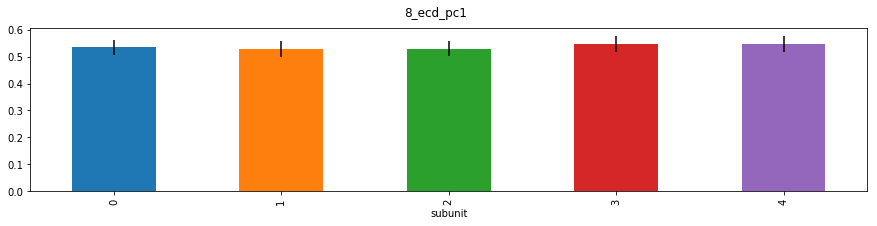

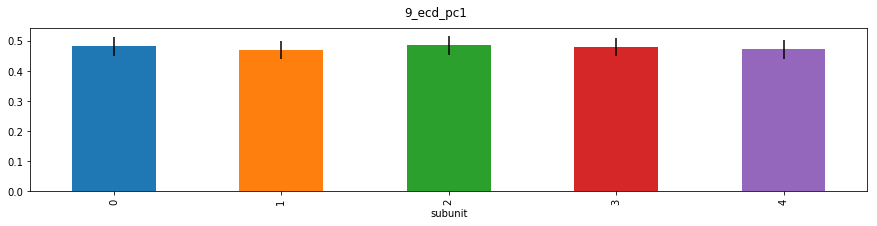

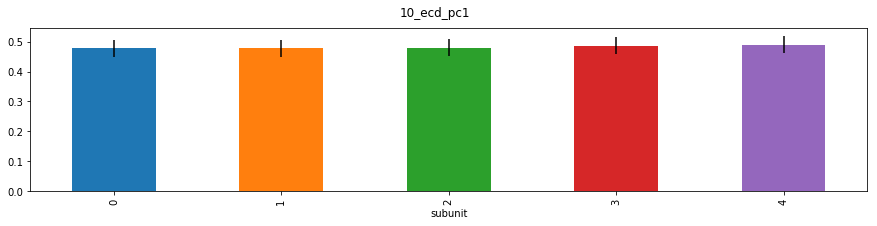

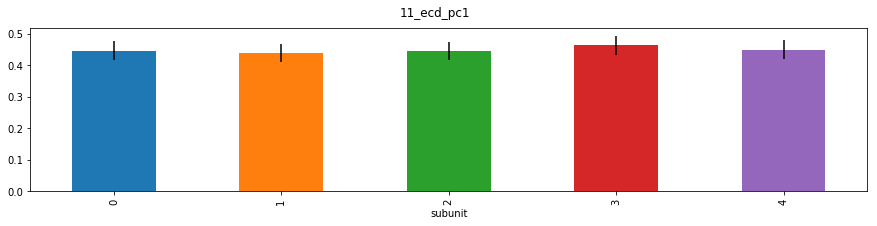

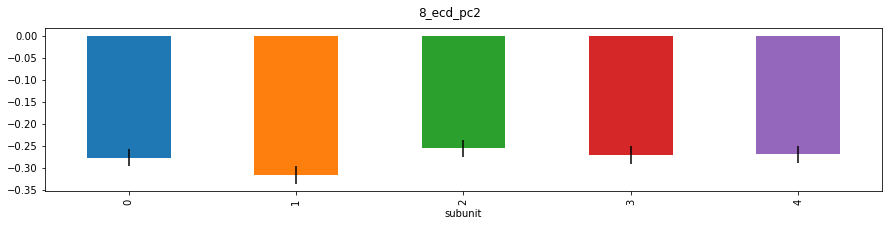

...

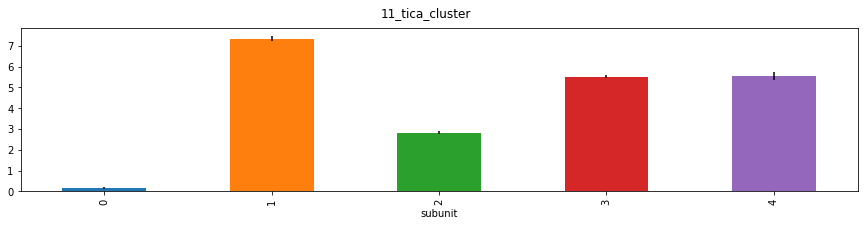

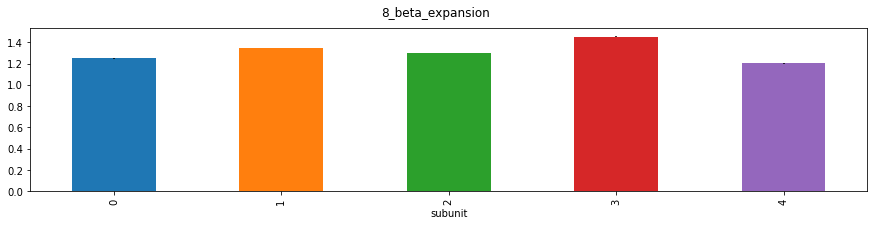

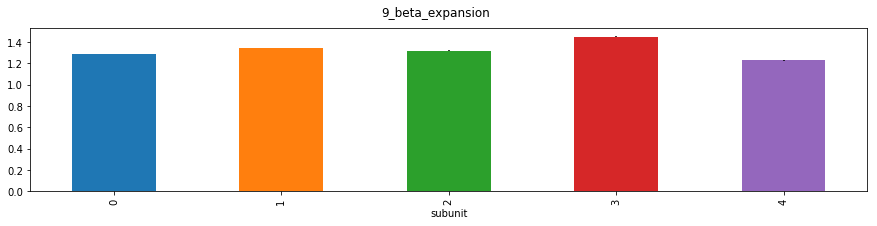

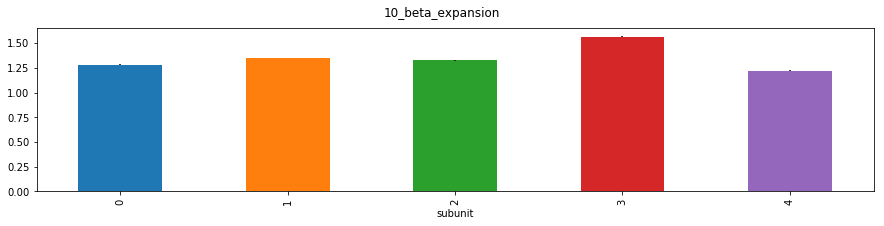

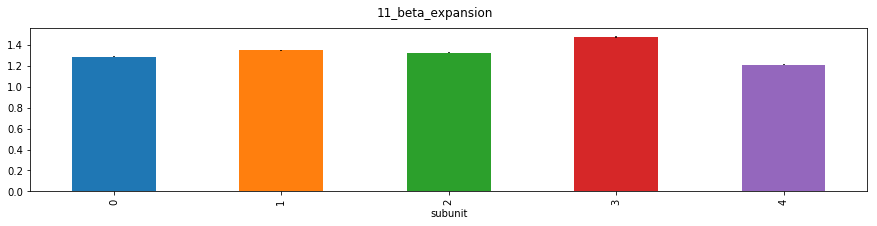

In [117]:
for feature in md_data_2_close.columns[6:-1]:
    for system in [8,9,10,11]:

        fig, ax = plt.subplots(figsize=(15, 3))
        fig.suptitle(str(system) + '_' + feature)
        group = md_data_2_close[(md_data_2_close.system == system)].groupby(['subunit'],sort=False)[feature]
        mean = group.mean()
        errors = group.sem()
        mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


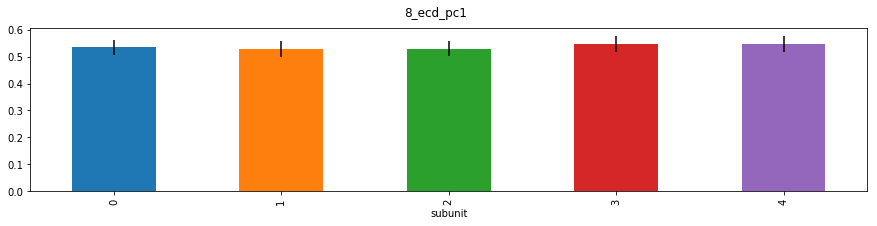

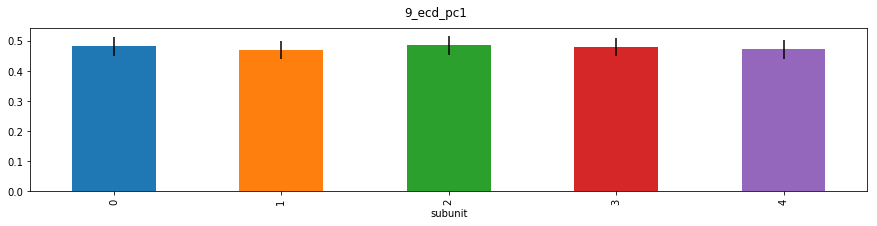

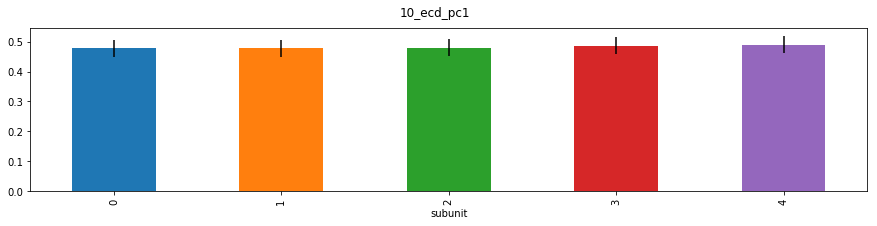

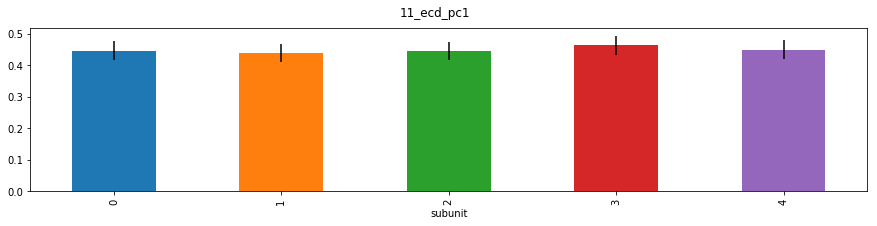

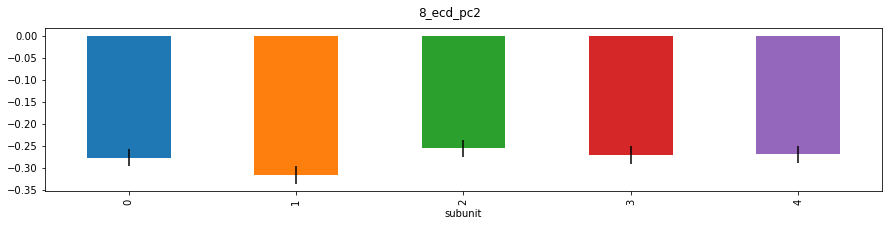

...

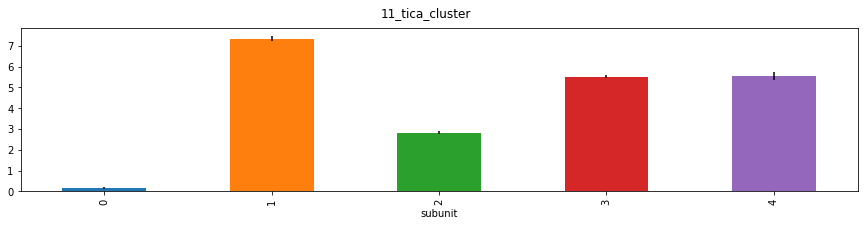

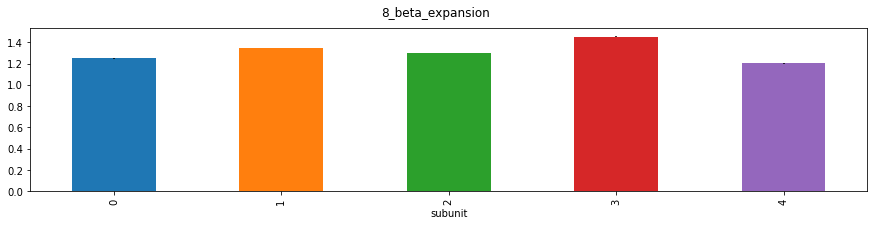

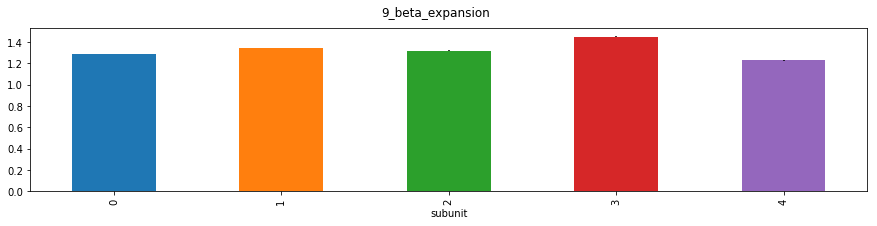

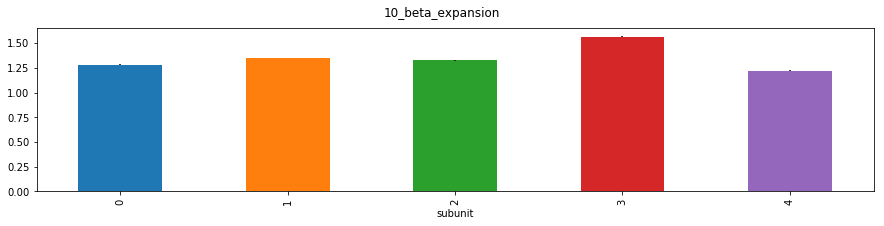

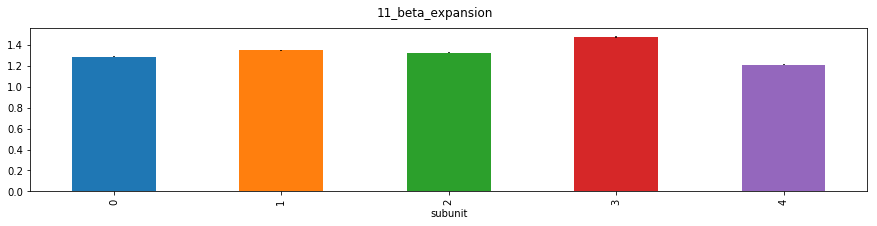

In [117]:
for feature in md_data_2_close.columns[6:-1]:
    for system in [13,15,16,18]:

        fig, ax = plt.subplots(figsize=(15, 3))
        fig.suptitle(str(system) + '_' + feature)
        group = md_data_2_oepn[(md_data_2_oepn.system == system)].groupby(['subunit'],sort=False)[feature]
        mean = group.mean()
        errors = group.sem()
        mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


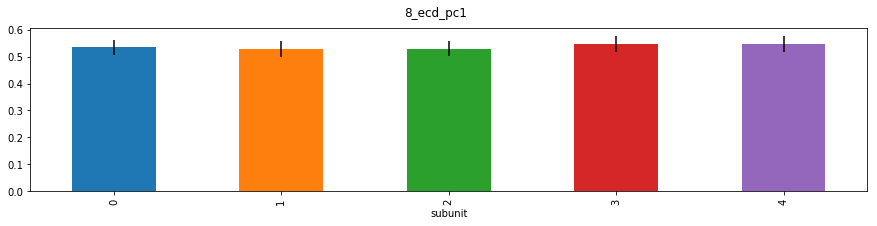

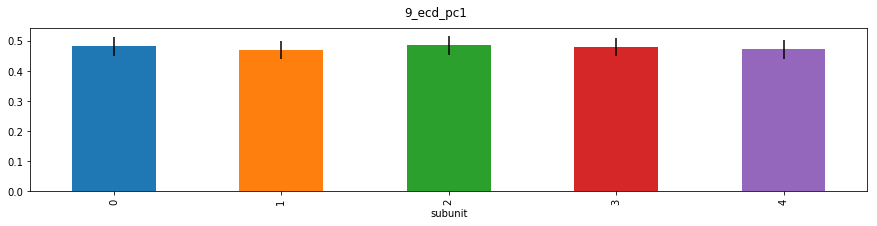

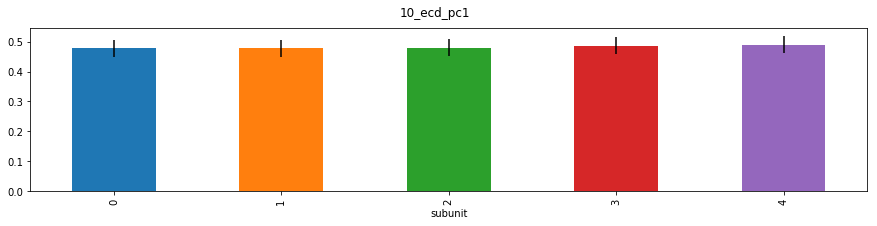

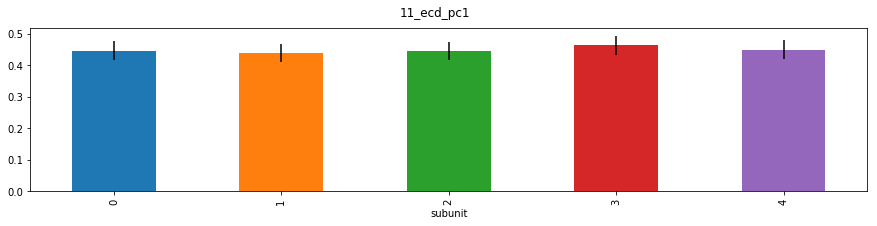

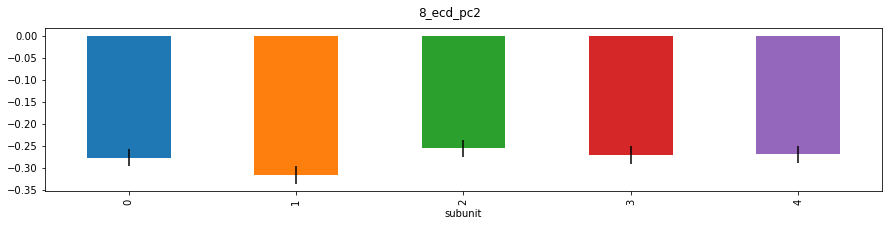

...

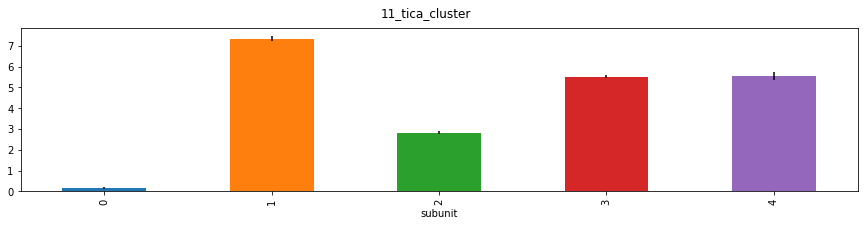

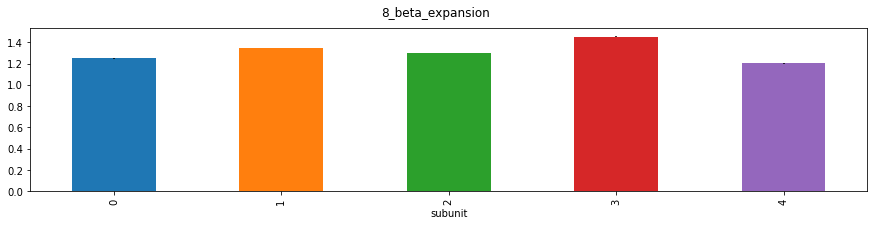

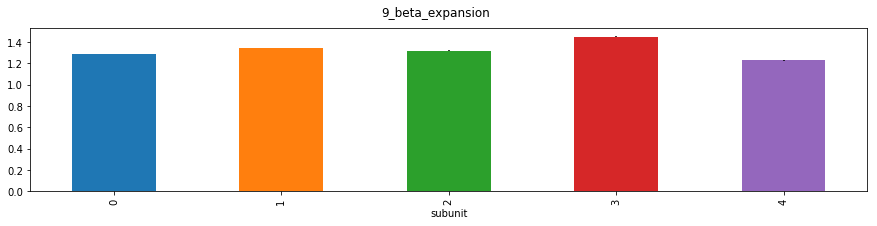

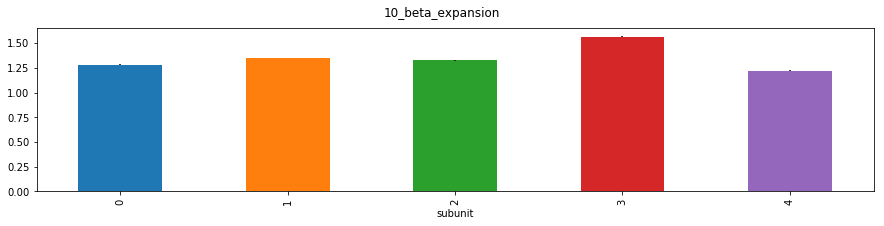

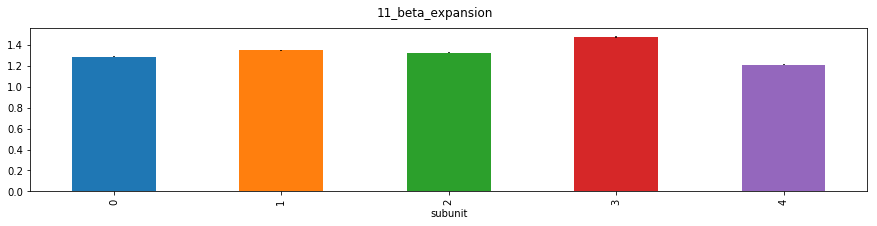

In [117]:
for feature in md_data_2_close.columns[6:-1]:
    for system in [8,9,10,11]:

        fig, ax = plt.subplots(figsize=(15, 3))
        fig.suptitle(str(system) + '_' + feature)
        group = md_data_2_close[(md_data_2_close.system == system)].groupby(['subunit'],sort=False)[feature]
        mean = group.mean()
        errors = group.sem()
        mean.plot.bar(yerr=errors,ax=ax)
#    ax.set_xticklabels(['open_WT_46','open_F238L_46','open_F238L_46_235_1H','open_I233T_46','open_FI_46','open_WT_70','open_F238L_70','open_I233T_70','open_FI_70','close_WT_70','close_F238L_70','close_I233T_70','close_FI_70'])


9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


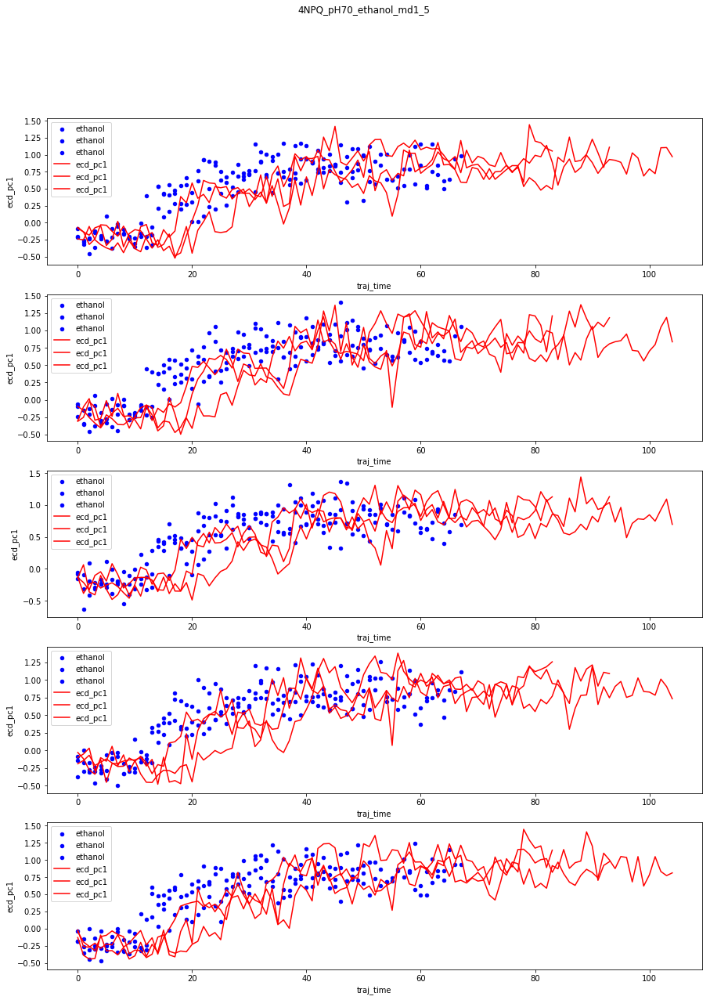

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


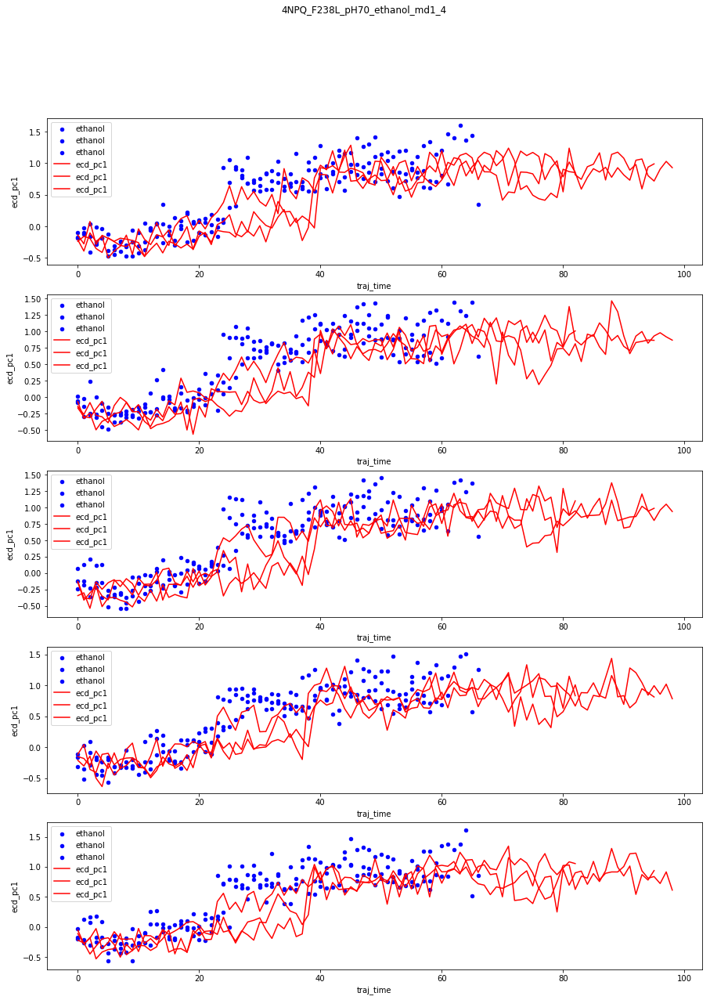

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


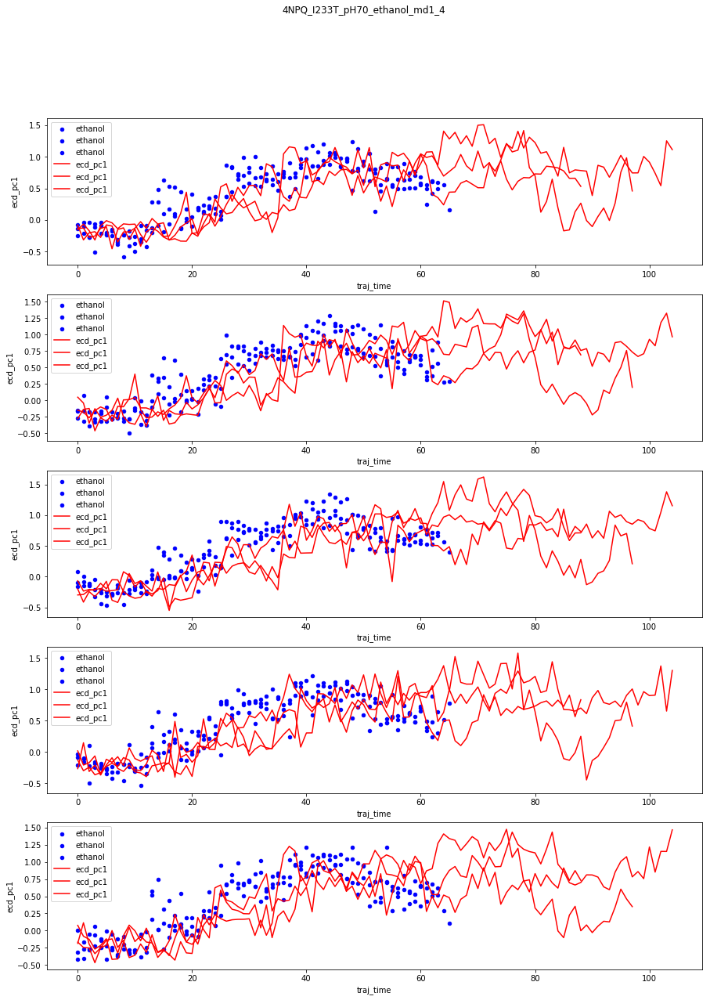

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


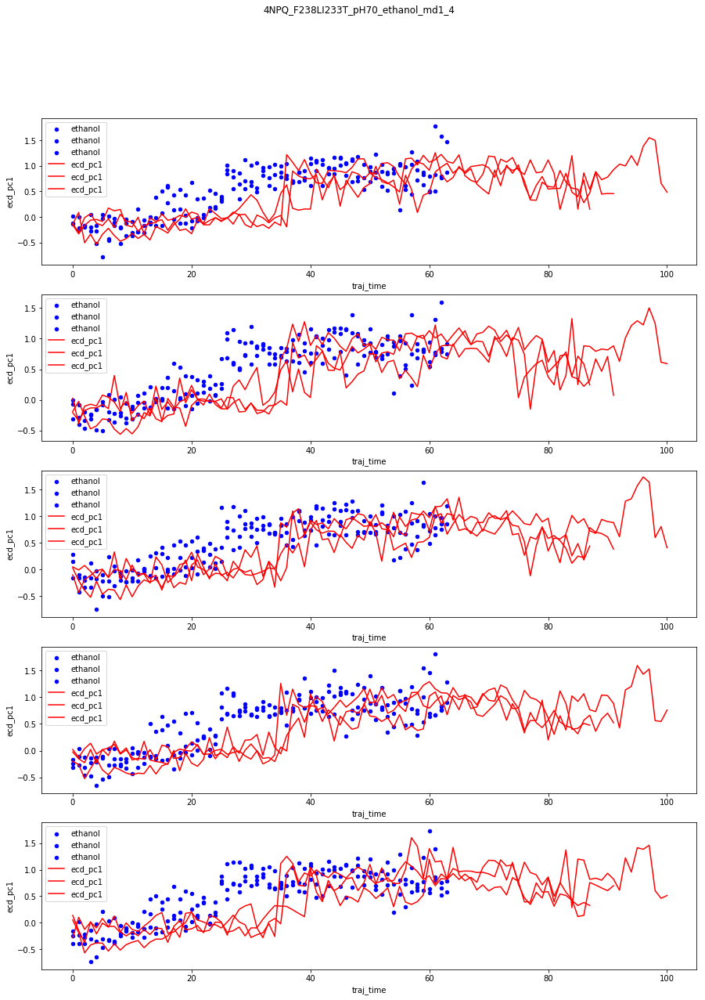

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


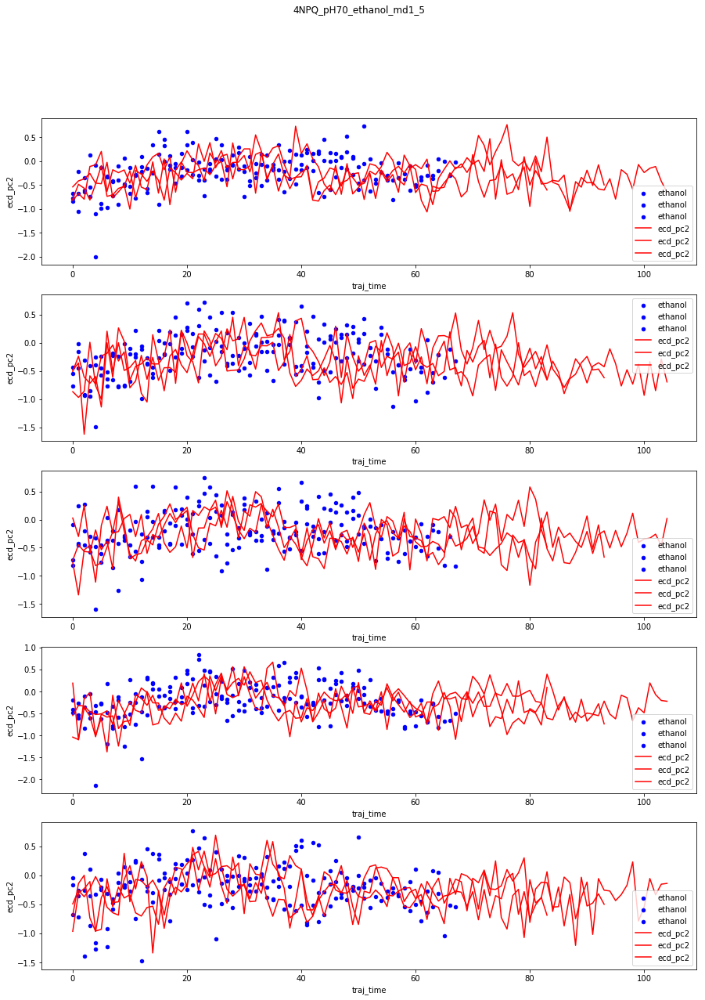

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


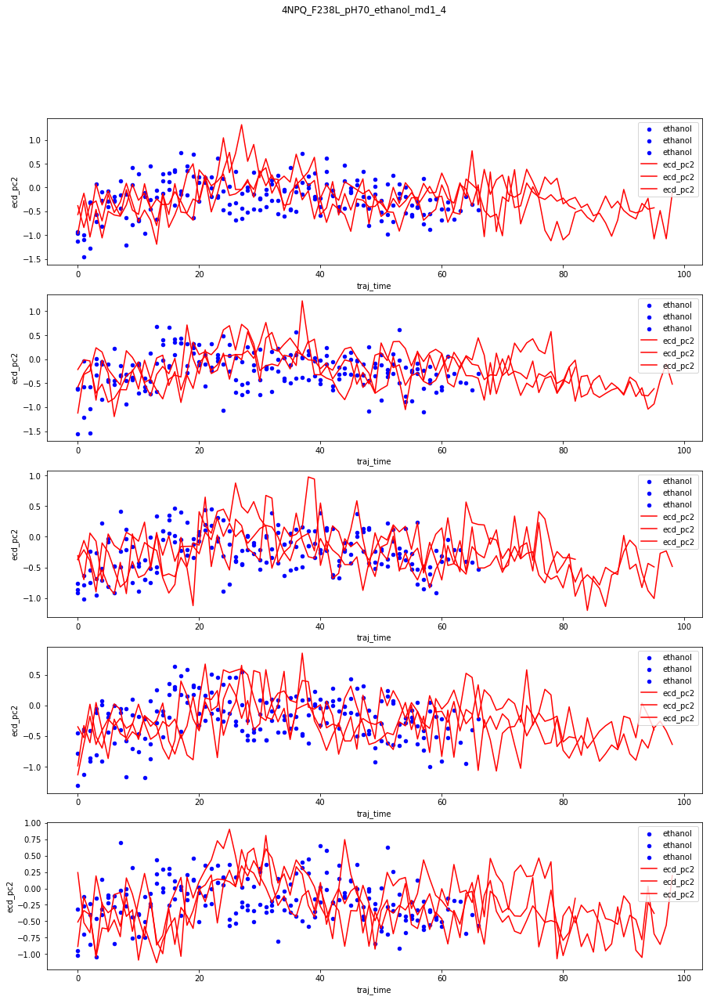

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


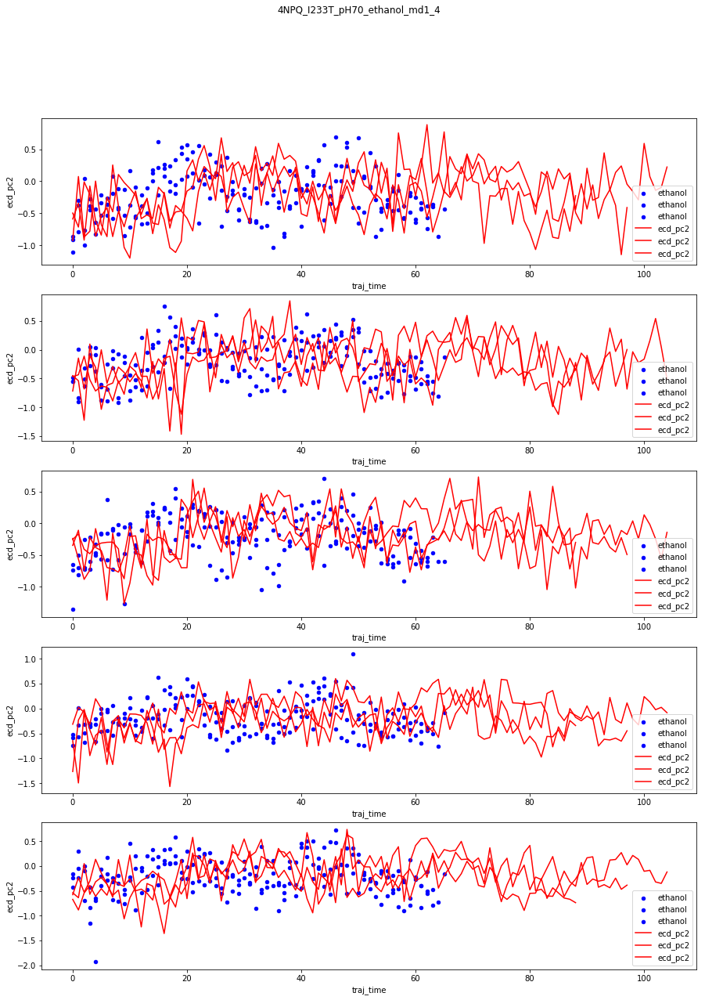

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


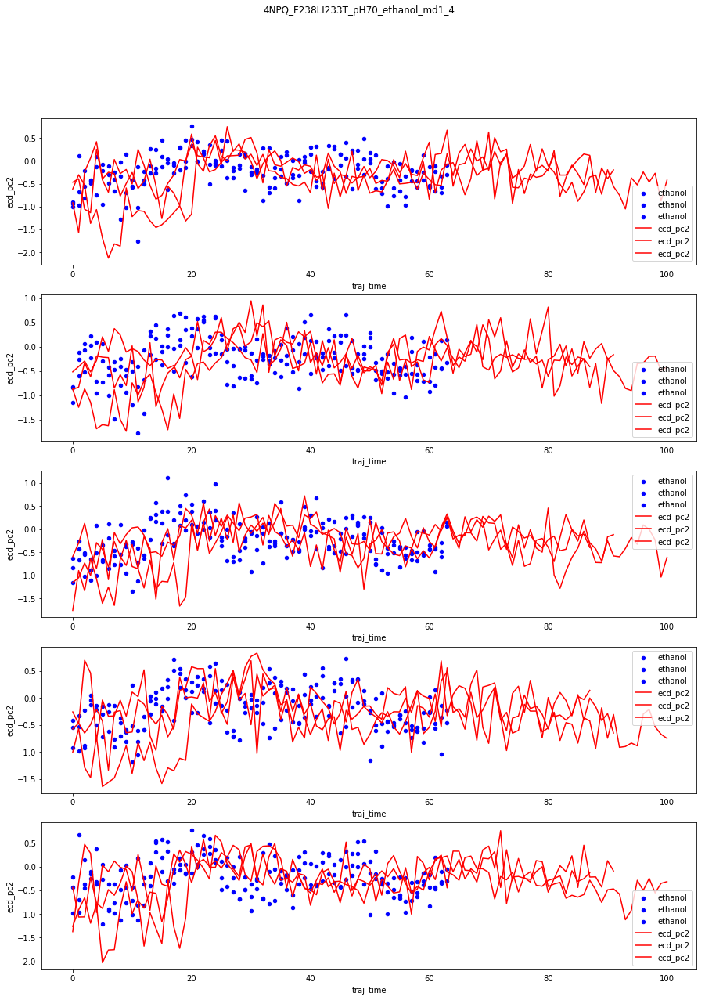

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


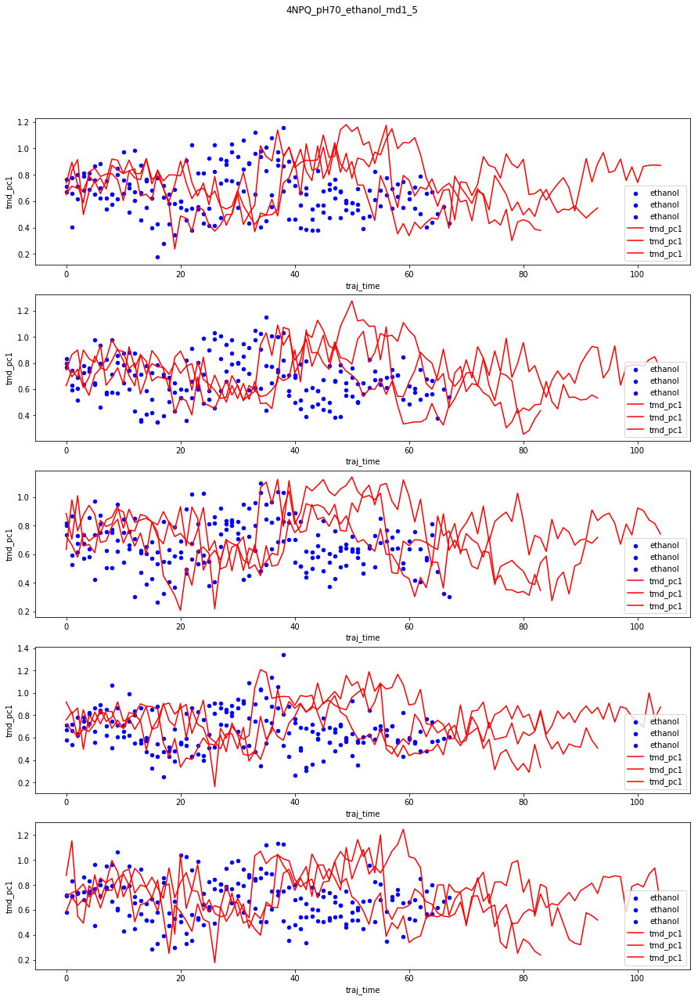

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


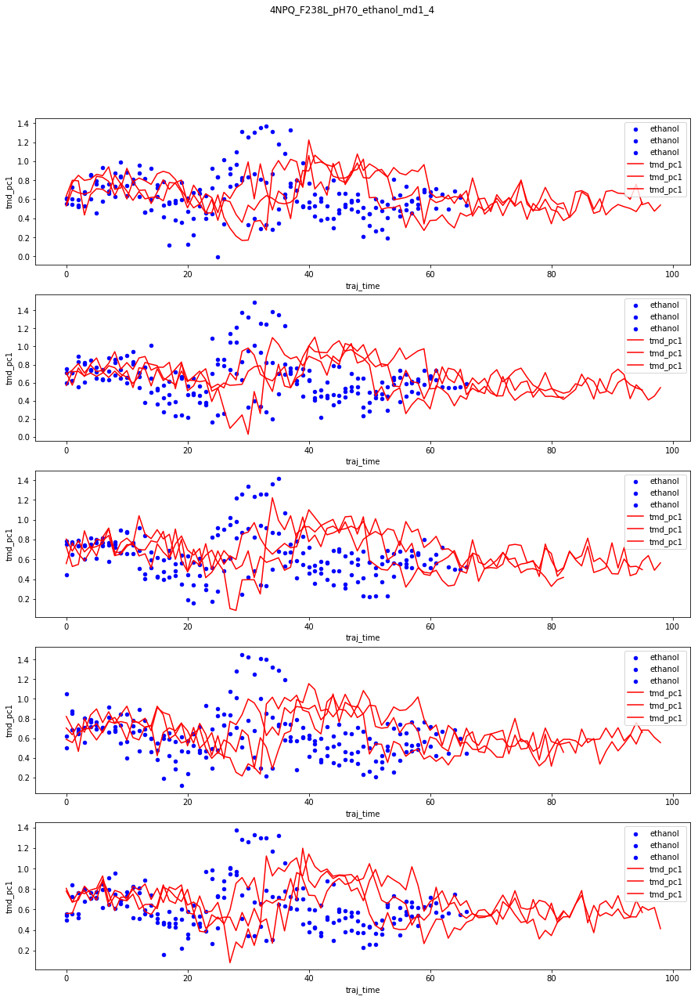

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


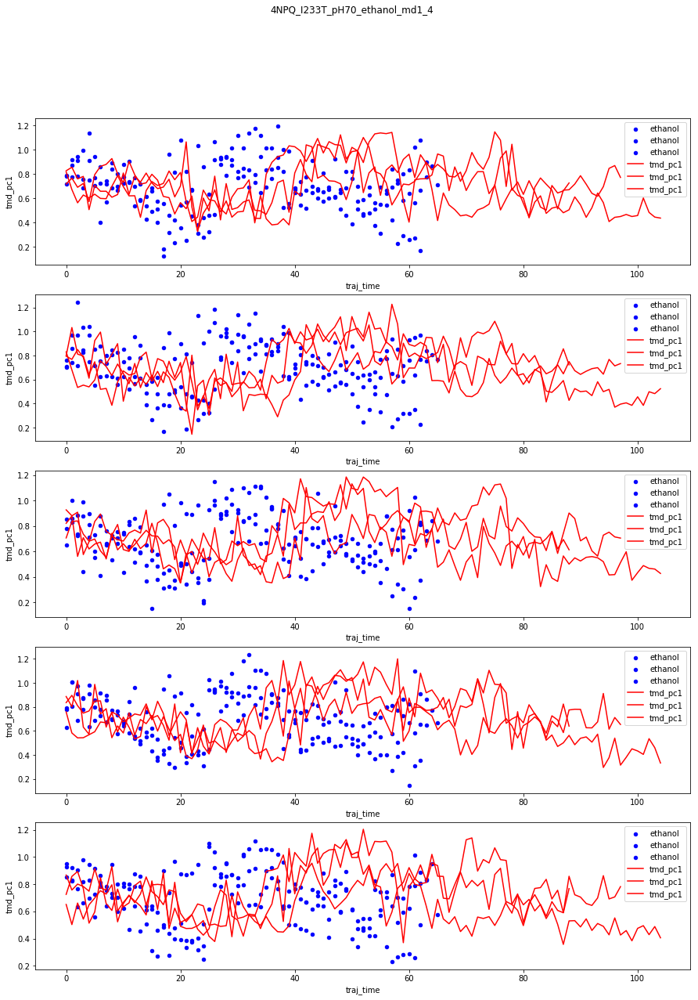

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


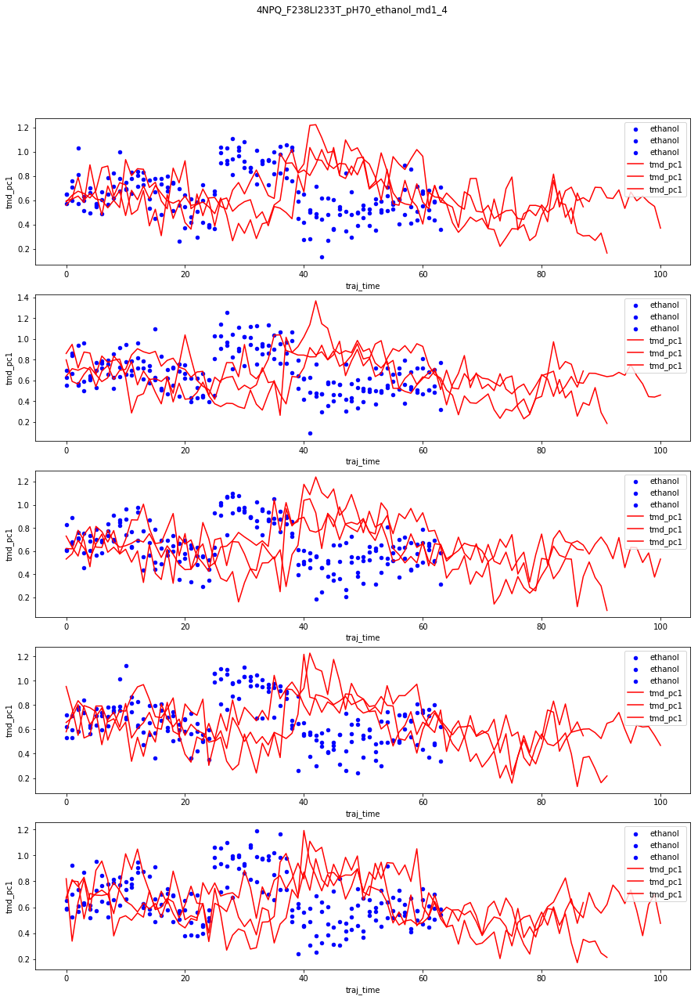

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


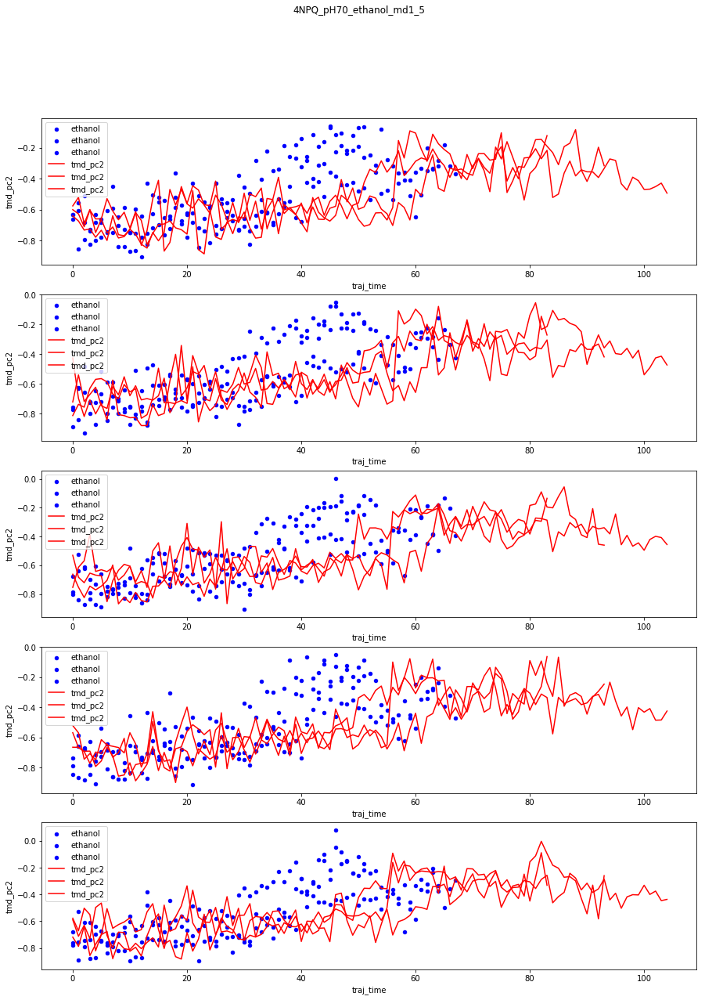

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


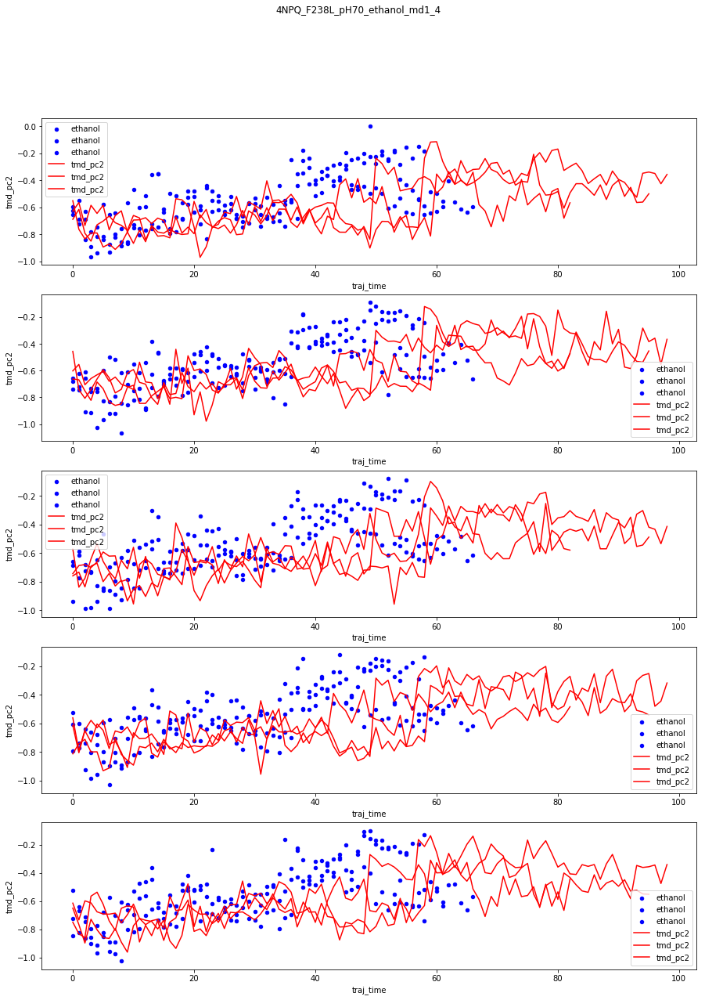

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


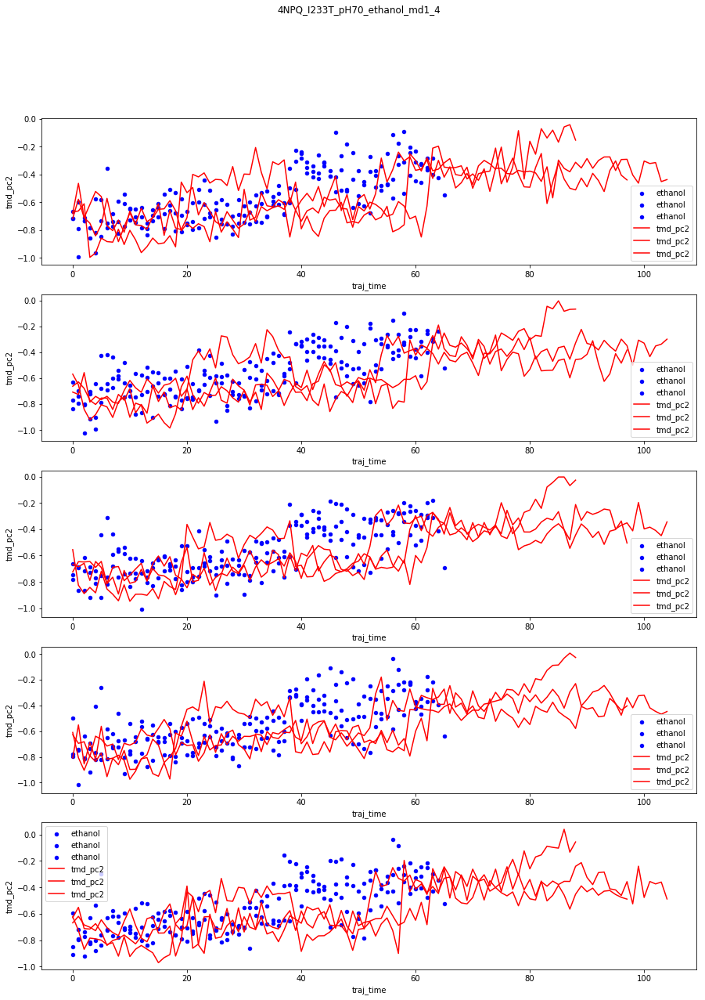

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


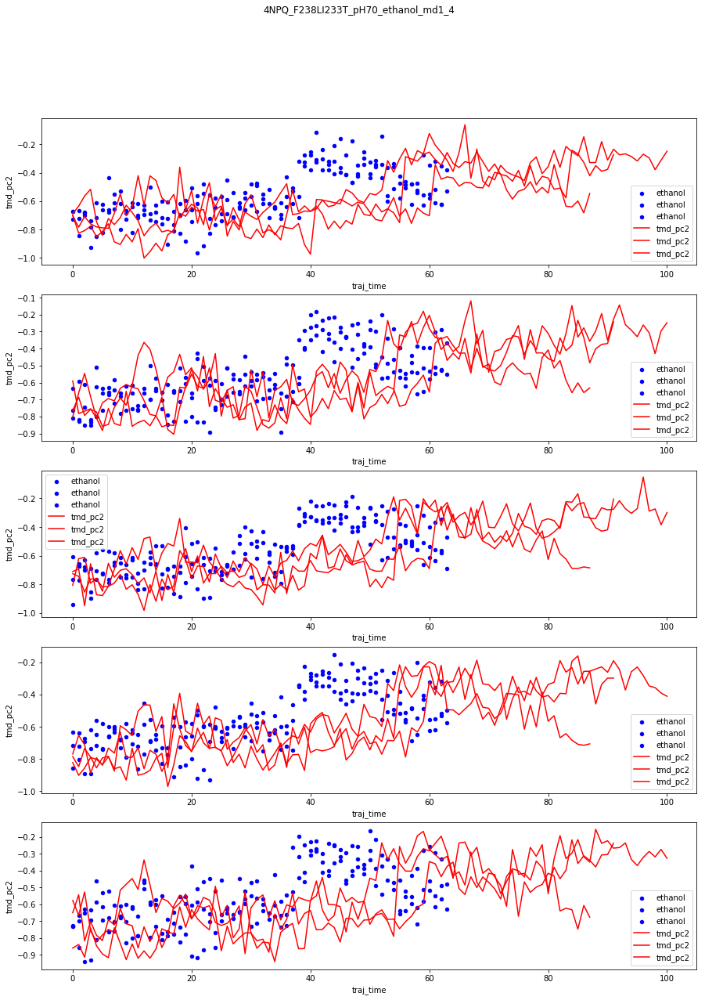

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


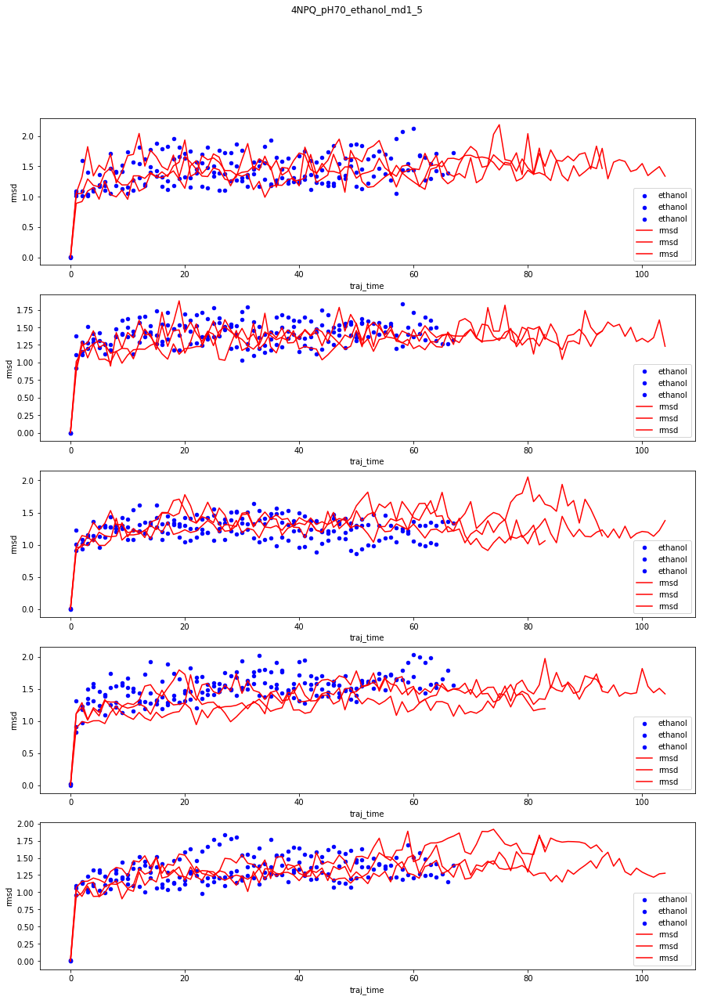

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


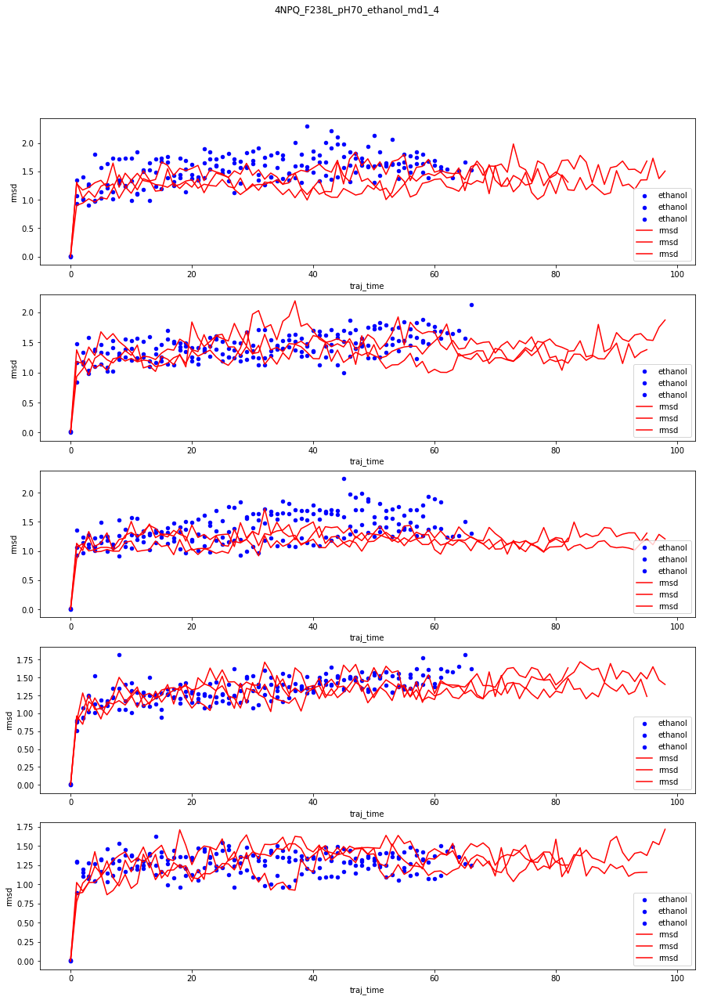

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


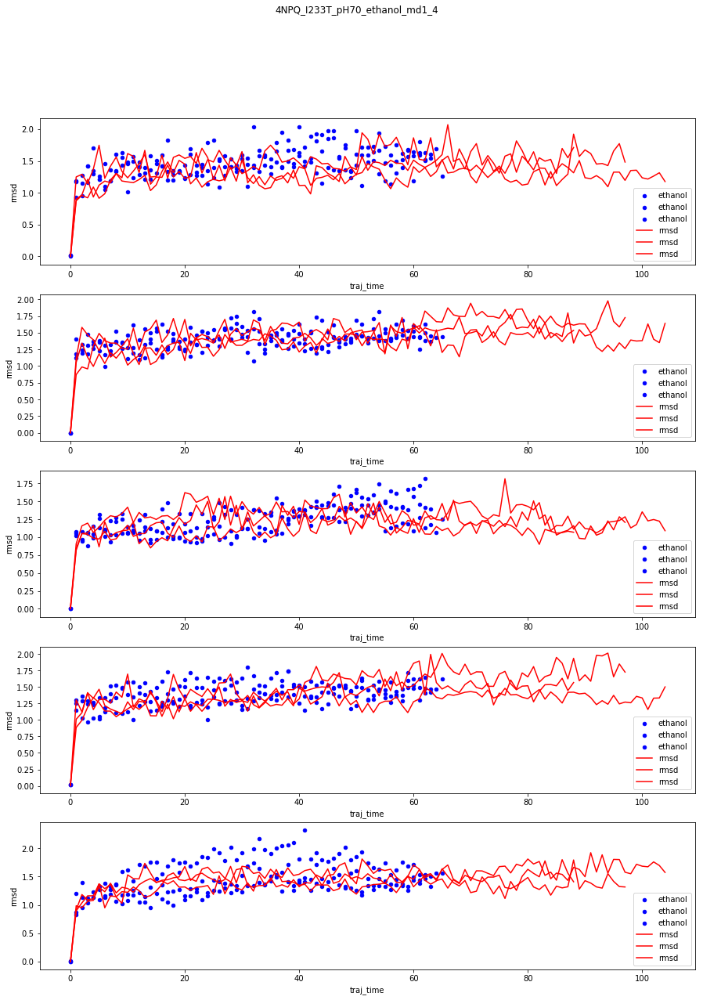

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


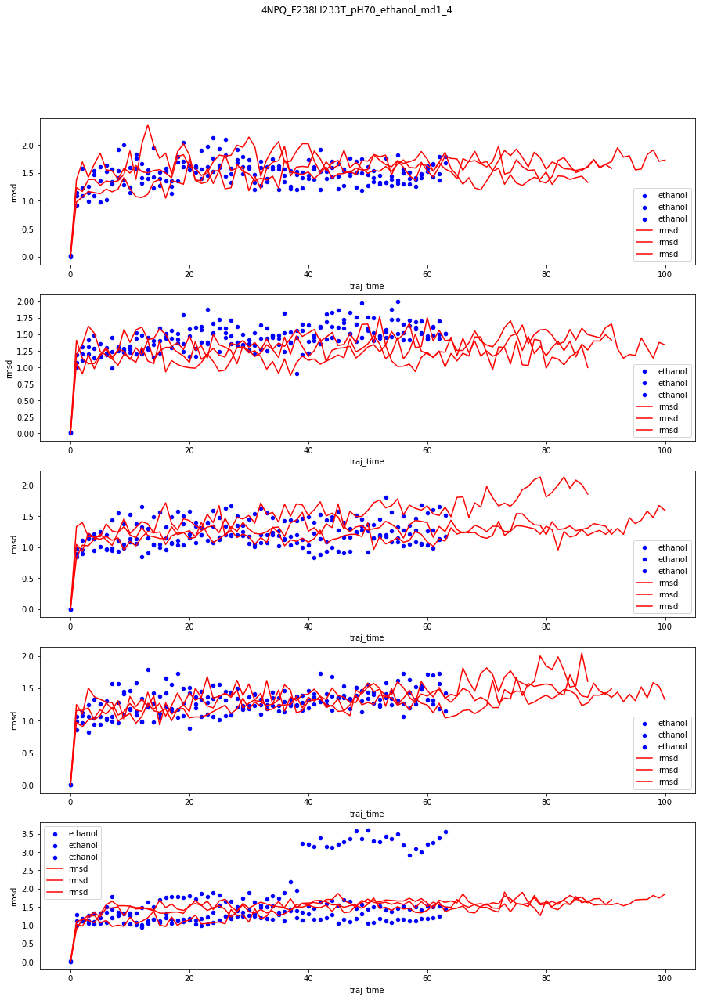

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


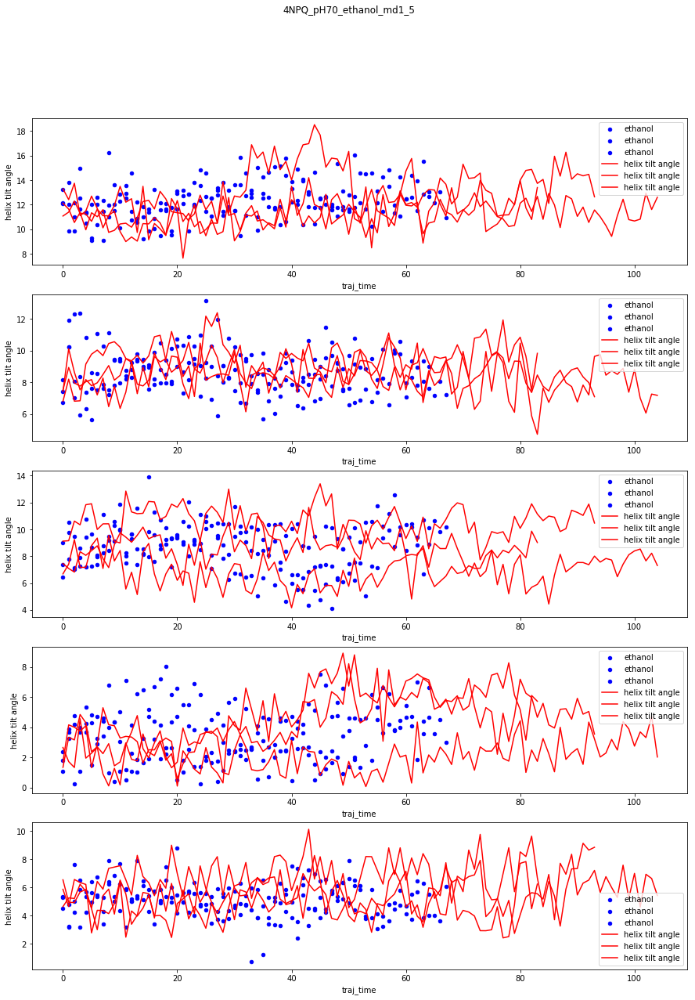

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


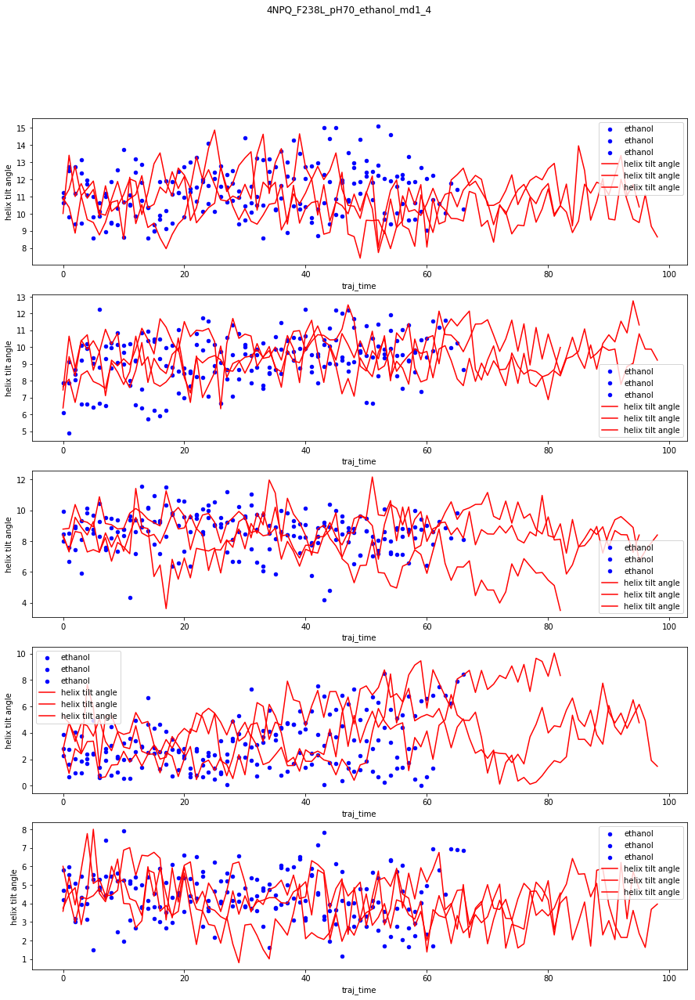

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


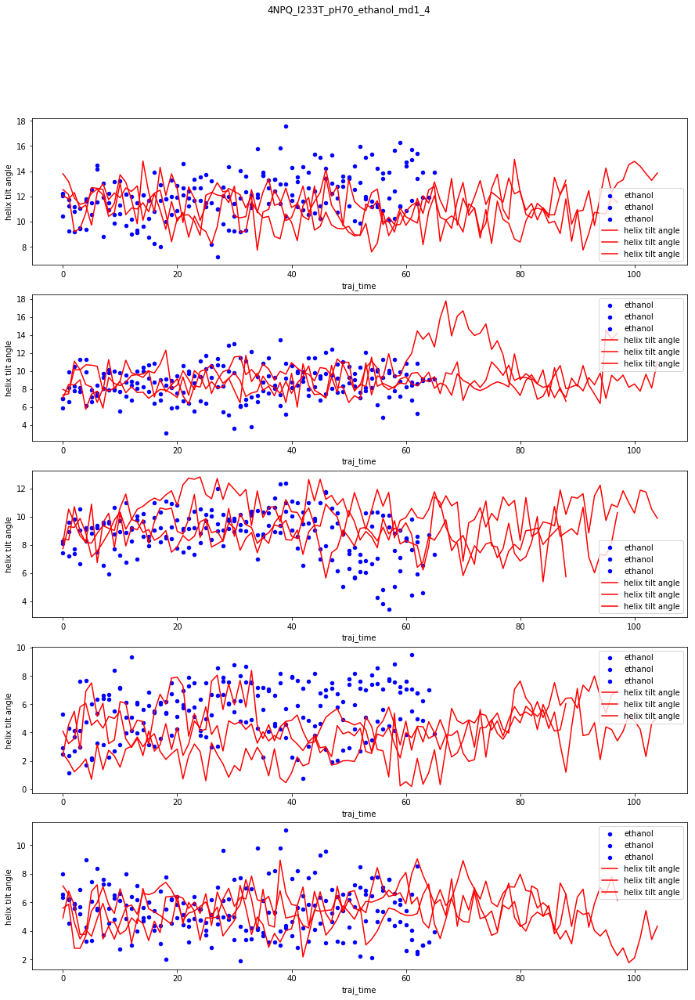

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


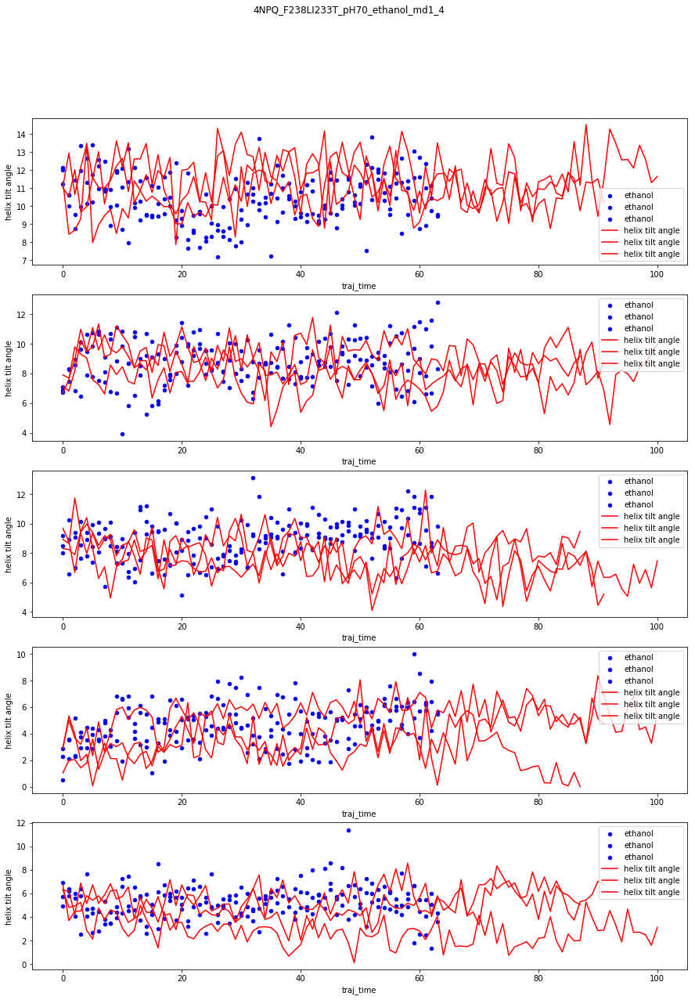

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


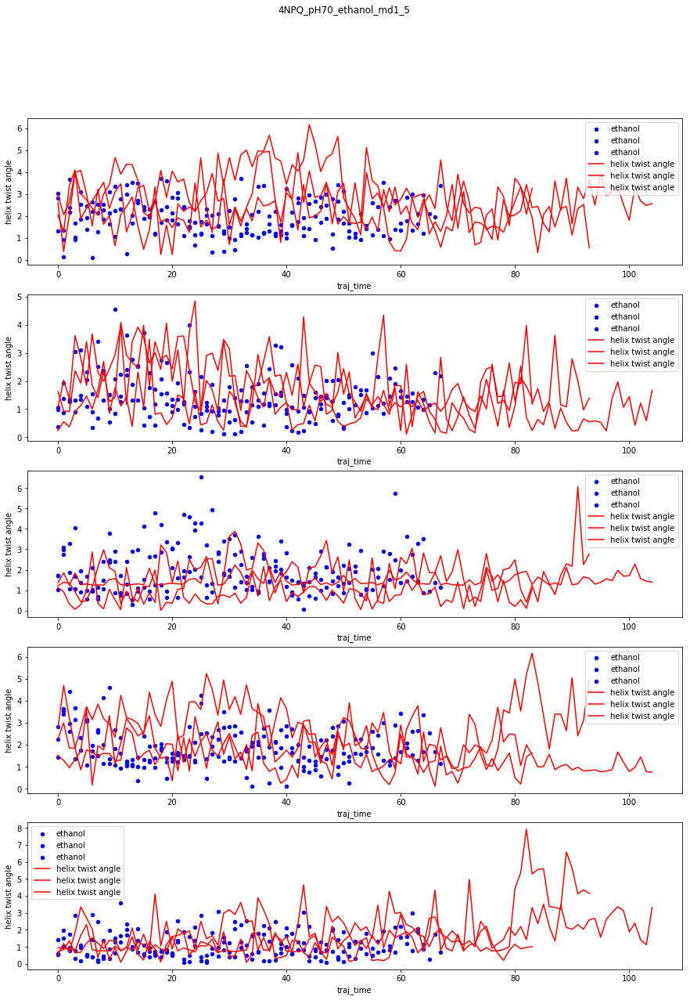

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


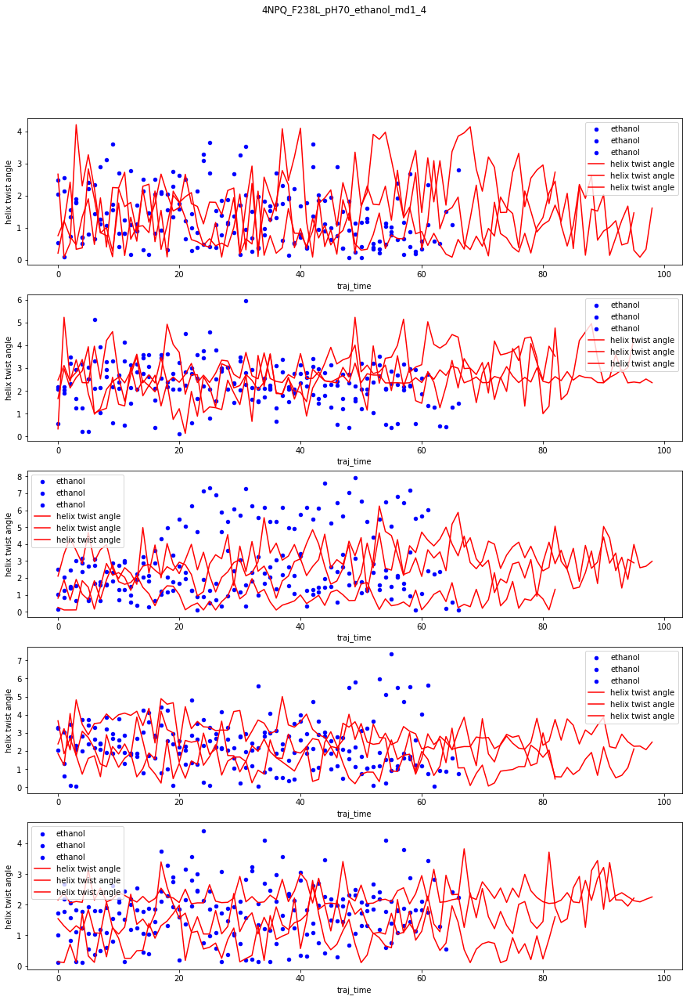

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


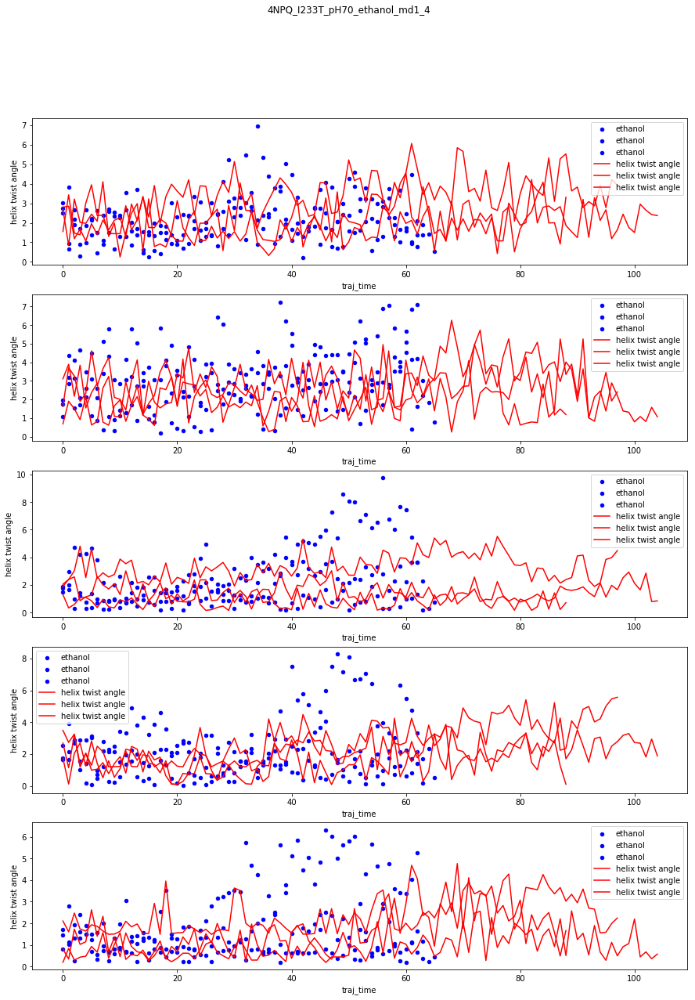

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


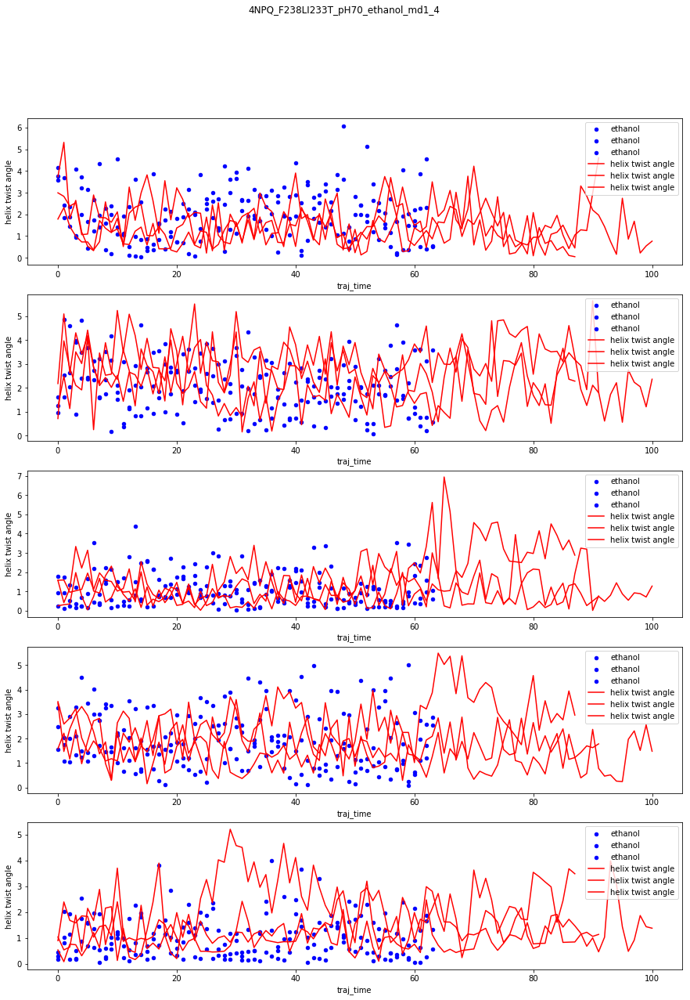

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


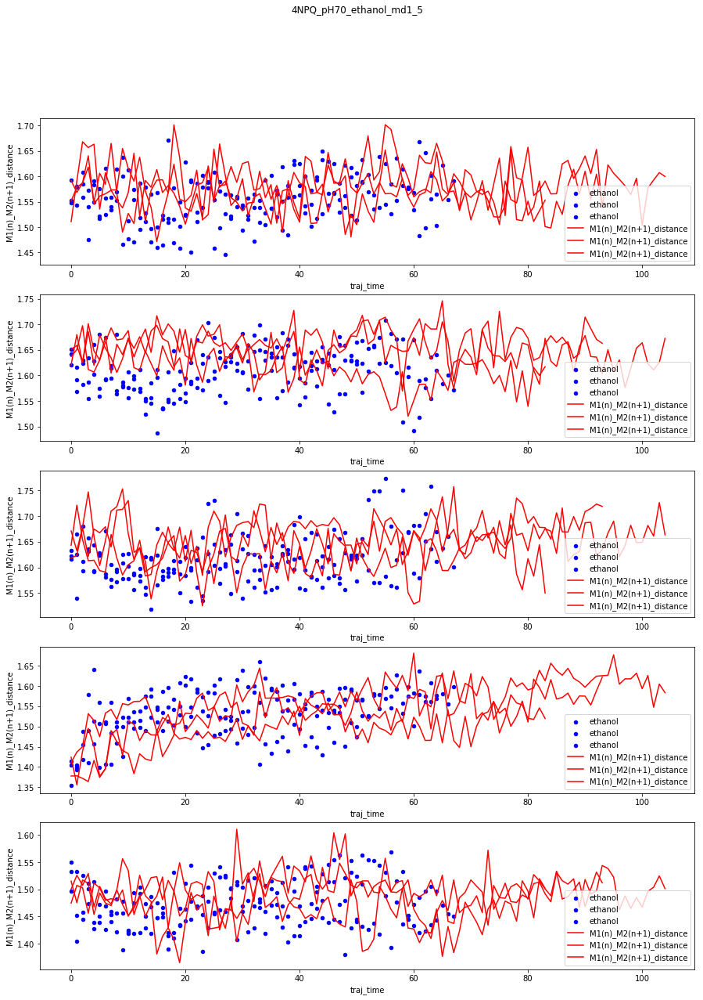

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


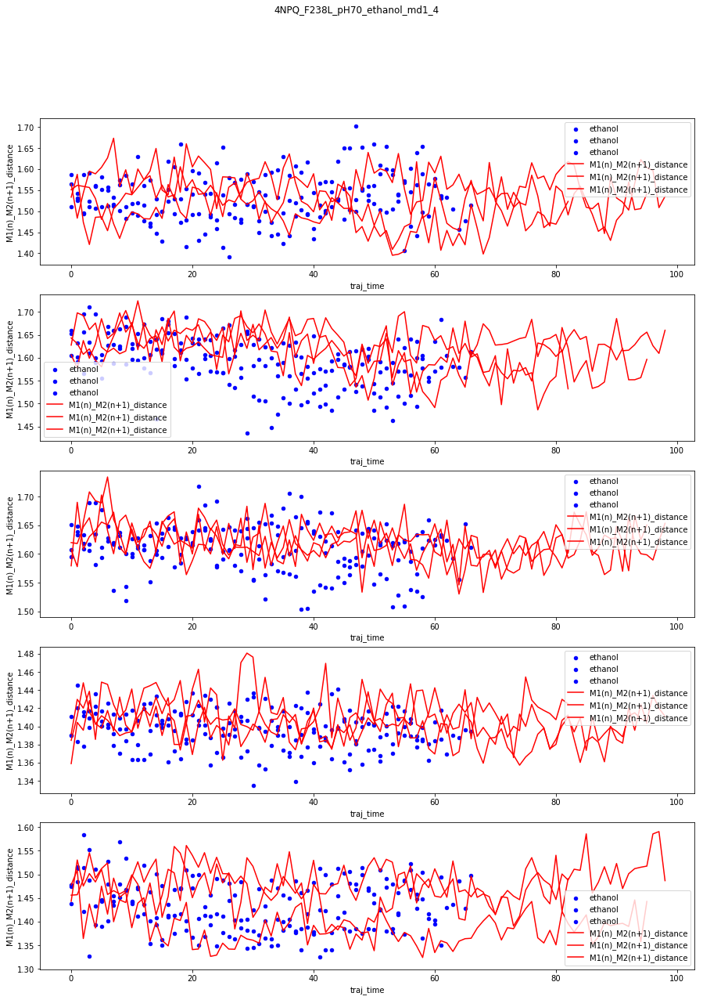

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


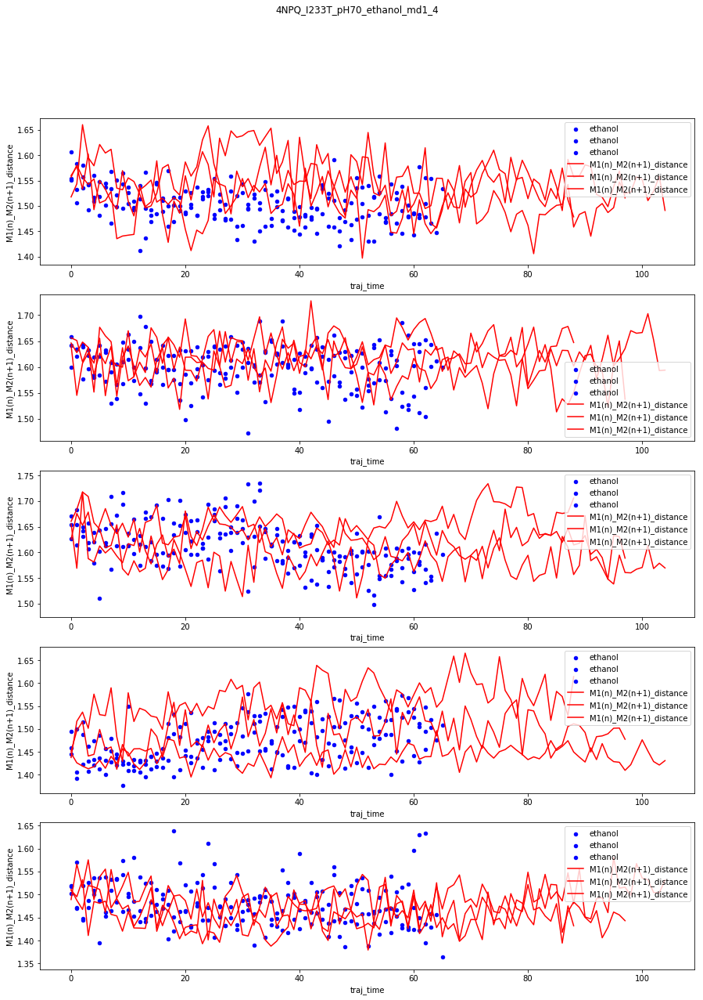

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


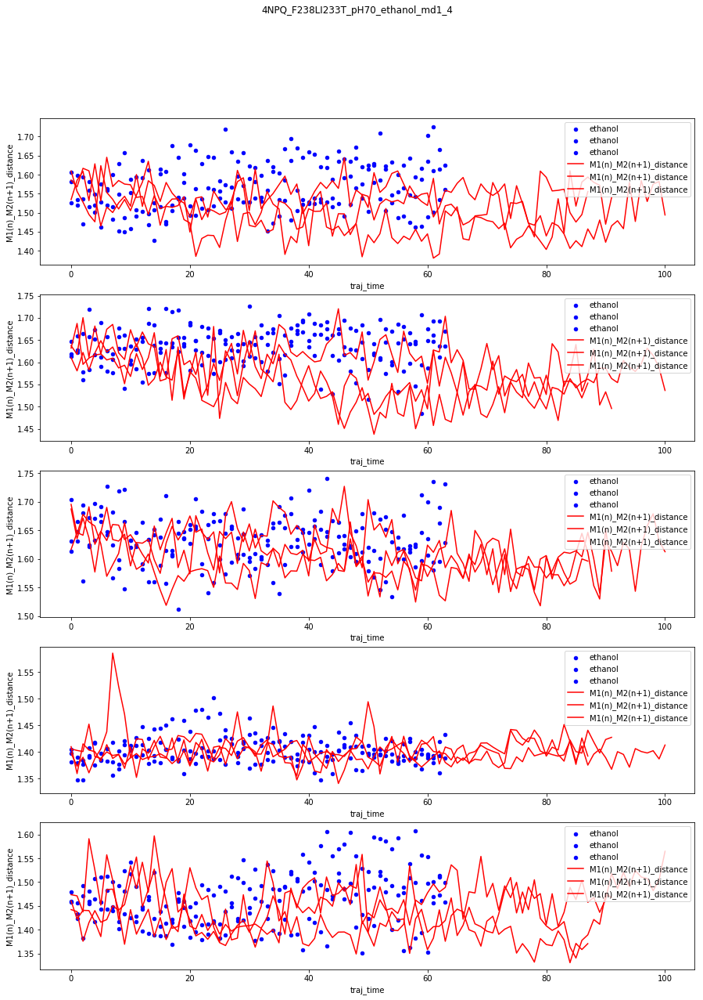

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


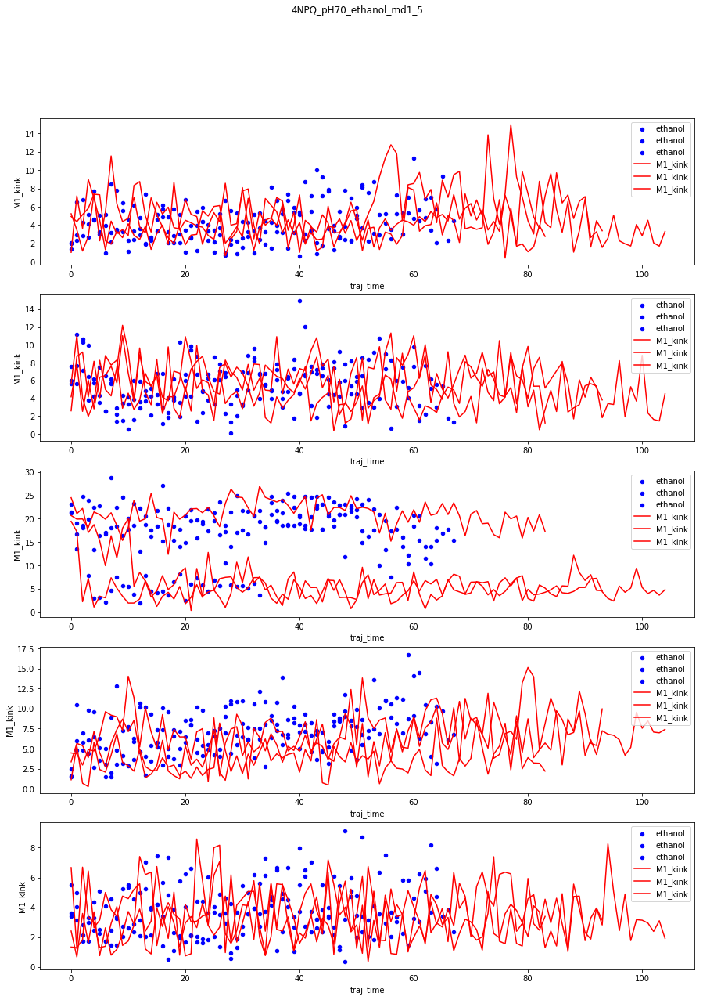

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


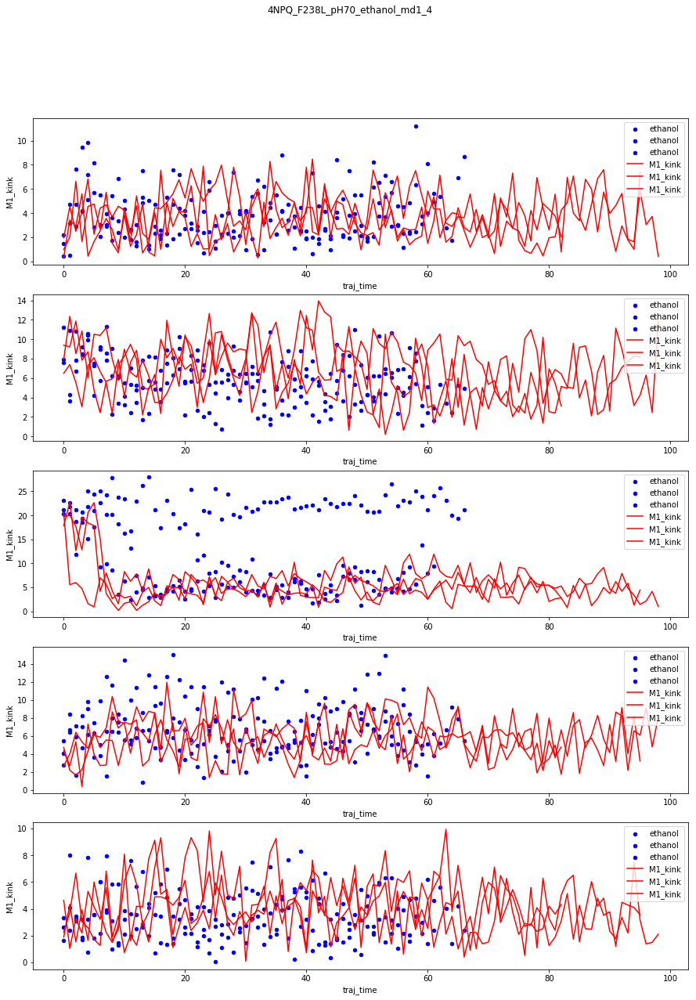

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


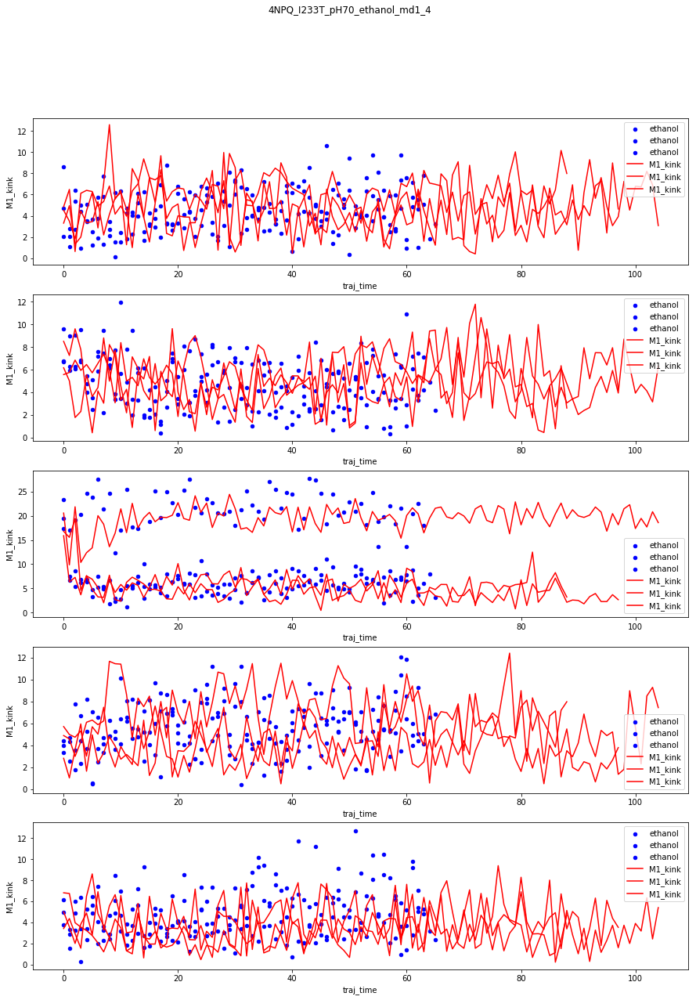

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


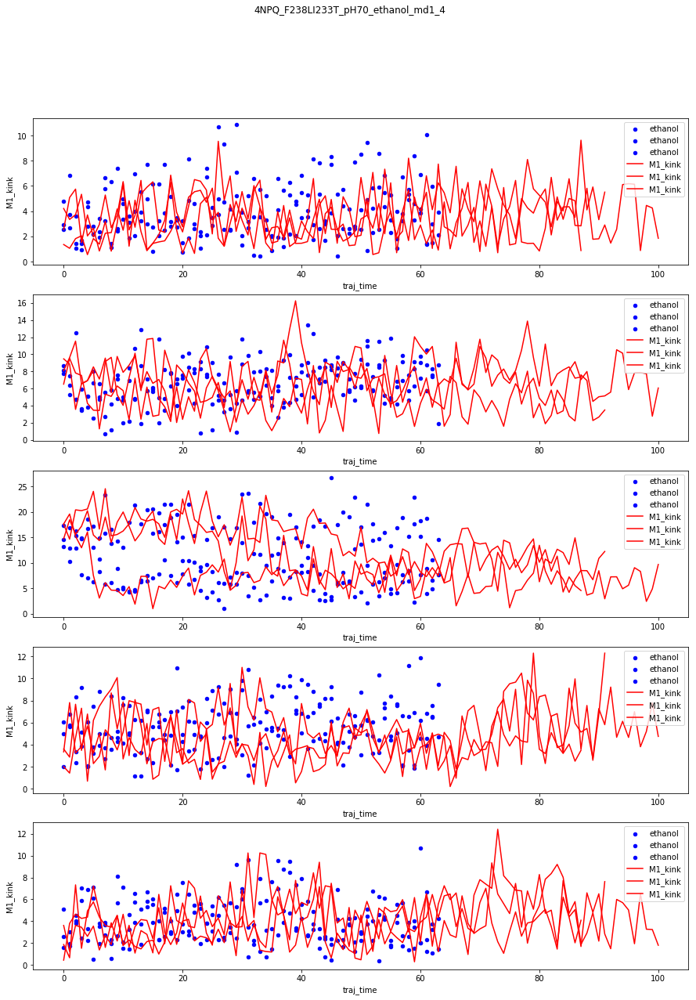

9
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1
4NPQ_pH70_ethanol_md1


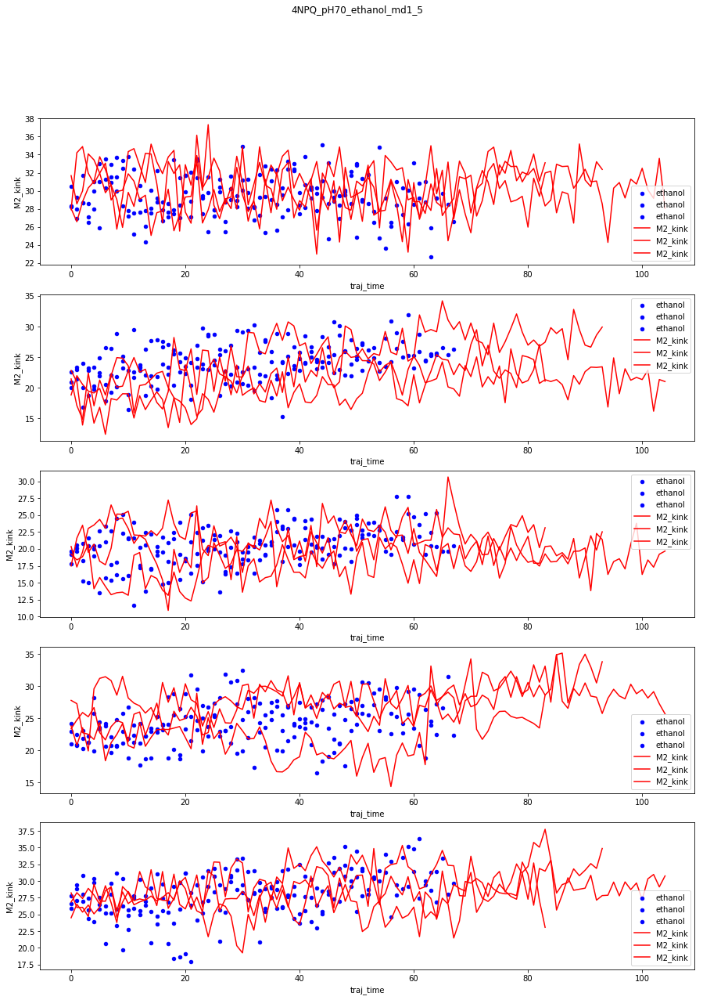

10
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1
4NPQ_F238L_pH70_ethanol_md1


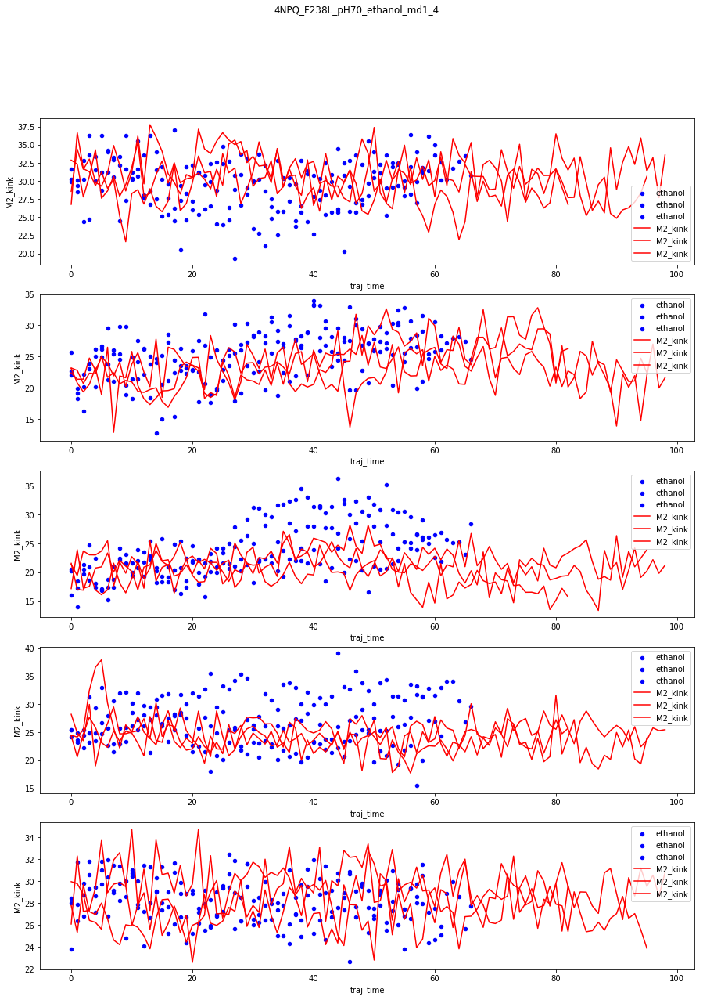

11
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1
4NPQ_I233T_pH70_ethanol_md1


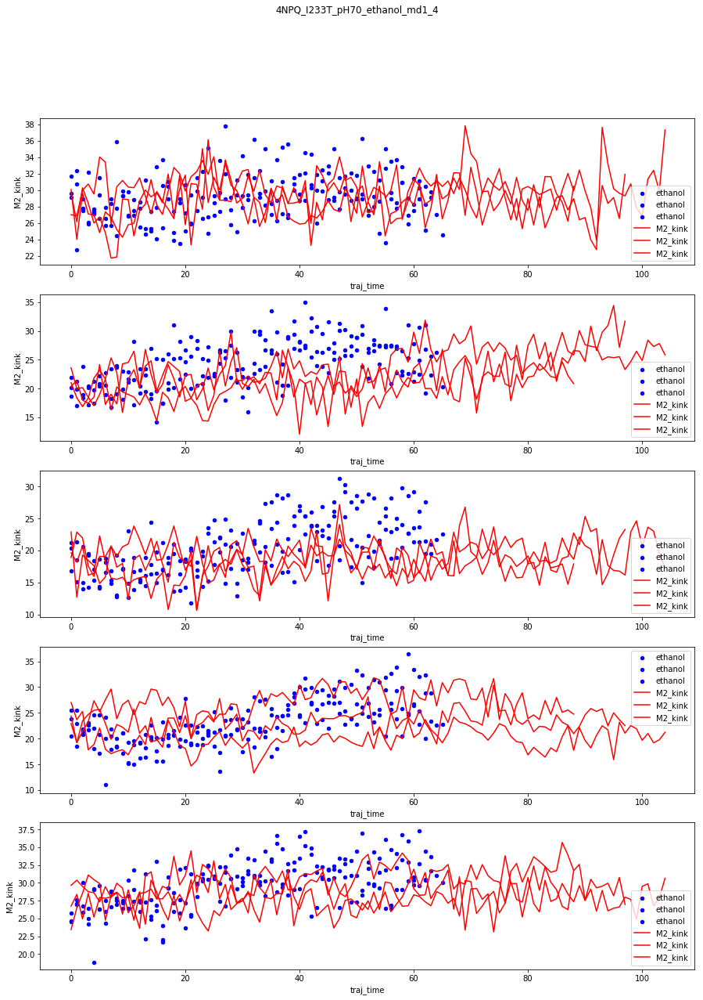

12
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1
4NPQ_F238LI233T_pH70_ethanol_md1


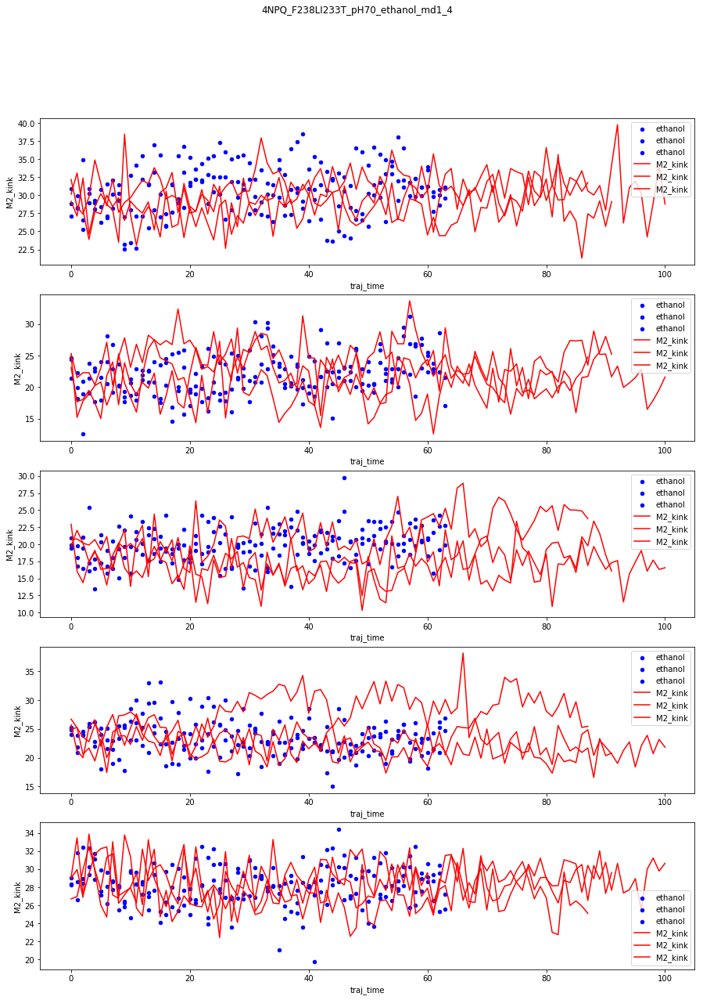

In [134]:
for feature in md_data_2_close.columns[6:-5]:
    for system in [9,10,11,12]:
        print(system)
        fig, ax = plt.subplots(5,figsize=(15, 20))

        for replicate in set(md_data[(md_data.system == system)]['replicate']):
            print(notation_changer[system])
            md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 0)].plot(kind='scatter',x='traj_time',y=feature,ax=ax[0],label='ethanol',c='blue')
            md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 1)].plot(kind='scatter',x='traj_time',y=feature,ax=ax[1],label='ethanol',c='blue')
            md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 2)].plot(kind='scatter',x='traj_time',y=feature,ax=ax[2],label='ethanol',c='blue')
            md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 3)].plot(kind='scatter',x='traj_time',y=feature,ax=ax[3],label='ethanol',c='blue')
            md_data[(md_data.system == system) & (md_data.replicate == replicate) & (md_data.subunit == 4)].plot(kind='scatter',x='traj_time',y=feature,ax=ax[4],label='ethanol',c='blue')
        for replicate in set(md_data_2_close[(md_data_2_close.system == system-1)]['replicate']):
            md_data_2_close[(md_data_2_close.system == system-1) & (md_data_2_close.replicate == replicate)  & (md_data_2_close.subunit == 0)].plot(x='traj_time',y=feature,ax=ax[0],label=feature,c='red')
            md_data_2_close[(md_data_2_close.system == system-1) & (md_data_2_close.replicate == replicate)  & (md_data_2_close.subunit == 1)].plot(x='traj_time',y=feature,ax=ax[1],label=feature,c='red')
            md_data_2_close[(md_data_2_close.system == system-1) & (md_data_2_close.replicate == replicate)  & (md_data_2_close.subunit == 2)].plot(x='traj_time',y=feature,ax=ax[2],label=feature,c='red')
            md_data_2_close[(md_data_2_close.system == system-1) & (md_data_2_close.replicate == replicate)  & (md_data_2_close.subunit == 3)].plot(x='traj_time',y=feature,ax=ax[3],label=feature,c='red')
            md_data_2_close[(md_data_2_close.system == system-1) & (md_data_2_close.replicate == replicate)  & (md_data_2_close.subunit == 4)].plot(x='traj_time',y=feature,ax=ax[4],label=feature,c='red')

#        ax[0].set_ylim(0,20)
#        ax[1].set_ylim(0,20)
#        ax[2].set_ylim(0,20)
#        ax[3].set_ylim(0,20)
#        ax[4].set_ylim(0,20)
        plt.suptitle(notation_changer[system] + '_' + replicate)
        plt.show()